In [1]:
# Enable automatic import reloading
%load_ext autoreload
%autoreload 2

# Display outputs from all lines when they exist
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # "last"

import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict

import triadicsim

IPython_default = plt.rcParams.copy()

# Baseline testing

In [2]:
import pickle

# Do the simulation thing with potential given sim log simulation inputs to use (not required)
def run_potentialsrc_simulations(
    prev_simlog,
    num_experiments, graph_type, num_nodes, graph_params, 
    threshold_mean, threshold_var, seed_candidates, num_seeds, 
    use_network, sticky_cascade, closure_method, closure_rate, 
    max_rounds, save_path, 
    use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False):
    # Check for previous simulation log length validity
    if prev_simlog is not None and len(prev_simlog)<num_experiments:
        raise ValueError('prev_simlog is shorter than requested experiment count')
    # Initialize data to be exported
    sim_log = []
    rounds_filled = []
    rounds_frozen = []
    max_size_round = []
    sizes_round = []
    # Run the experiments!
    for i in range(num_experiments):
        # Retrieve previous simlog data
        if prev_simlog is not None:
            (
                prev_G, prev_thresholds, prev_seedset, 
                prev_G_log, prev_node_log, prev_edge_log, prev_exit_status
            ) = prev_simlog[i]
        # Initialize simulation inputs
        if (prev_simlog is not None) and use_simlog_graph:
            G = prev_G
        else:
            G = triadicsim.graph(
                num_nodes=num_nodes, 
                graph_type=graph_type, 
                params=graph_params,
                rng_seed=None,
            )
        if (prev_simlog is not None) and use_simlog_thresholds:
            thresholds = prev_thresholds
        else:
            thresholds = triadicsim.create_thresholds(
                num_nodes, mean=threshold_mean, var=threshold_var,
                rng_seed=None,
            )
        if (prev_simlog is not None) and use_simlog_seeds:
            seedset = prev_seedset
        else:
            seedset = triadicsim.create_seedset(
                seed_candidates, num_seeds,
                rng_seed=None,
            )
        # Run simulation
        G_log, node_log, edge_log, exit_status = triadicsim.simulate_cascade(
            G, thresholds, seedset,
            use_network=use_network, sticky_cascade=sticky_cascade,
            closure_type=closure_method, closure_rate=closure_rate,
            max_rounds=max_rounds,
            rng_seed=None,
        )
        sim_log.append( (G, thresholds, seedset, G_log, node_log, edge_log, exit_status) )
        # Compute history of infection rates
        num_reached_nodes = [len(s) for s in node_log]
        rounds_filled.append(1 if exit_status[0] else 0)
        rounds_frozen.append(1 if exit_status[1] else 0)
        max_size_round.append([
            i for i in range(len(num_reached_nodes)) 
            if num_reached_nodes[i]==max(num_reached_nodes)
        ][0])
        sizes_round.append([x/num_nodes for x in num_reached_nodes])
        # Plot the output
        _ = plt.plot([x/num_nodes for x in num_reached_nodes])
    _ = plt.xlabel('round')
    _ = plt.ylabel('% nodes participating')
    _ = plt.title(
        'Vary graph, thresholds, seeds\n'
        + f'{num_nodes} nodes on {graph_type} with {closure_method} closure'
    )
    plt.show()
    # Save results and log data
    with open(save_path, 'wb') as f:
       pickle.dump(
           (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round),
           f
       )
    return rounds_filled, rounds_frozen, max_size_round, sizes_round

C:\Users\cephc\miniconda3\envs\triadic\lib\_collections_abc.py:941: MatplotlibDeprecationWarning: 
The animation.avconv_args rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]
C:\Users\cephc\miniconda3\envs\triadic\lib\_collections_abc.py:941: MatplotlibDeprecationWarning: 
The animation.avconv_path rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]
C:\Users\cephc\miniconda3\envs\triadic\lib\_collections_abc.py:941: MatplotlibDeprecationWarning: 
The animation.html_args rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]
C:\Users\cephc\miniconda3\envs\triadic\lib\_collections_abc.py:941: MatplotlibDeprecationWarning: 
The keymap.all_axes rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]
C:\Users\cephc\miniconda3\envs\triadic\lib\_collections_abc.

Now running static simulations for threshold=0.4


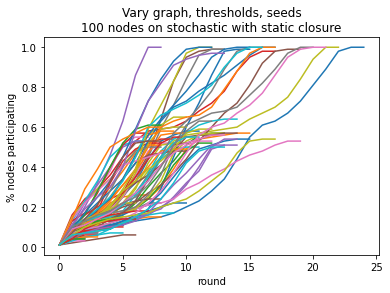

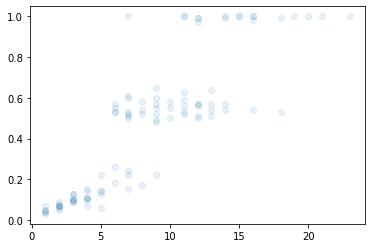

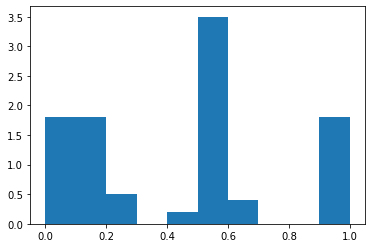

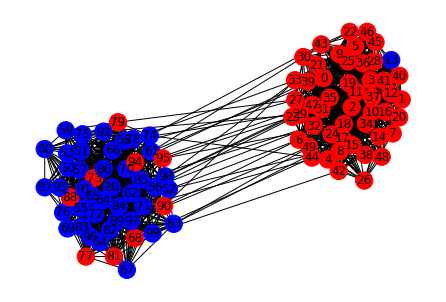

In [3]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.5,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
THRESHOLD_MEAN_LIST = [0.4] # threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
seed_candidates = np.arange(num_nodes)
num_seeds = 1
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][4] if use_network else 'population_irrelevant'
closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for threshold_mean in THRESHOLD_MEAN_LIST:
    print(f'Now running static simulations for threshold={threshold_mean}')

    # Retrieve output from before
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = (None, None, None, None, None)
    # (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
    #     open(f'e1_hyperparam/gnp_modelmax_threshold{threshold_mean}.pkl', 'rb')
    # )
    
    rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
        sim_log,
        num_experiments, graph_type, num_nodes, graph_params, 
        threshold_mean, threshold_var, seed_candidates, num_seeds, 
        use_network, sticky_cascade, closure_method, closure_rate, 
        max_rounds, save_path=f'temp.pkl', 
        use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
    )

    # print(rounds_filled)
    # print(rounds_frozen)
    # print(max_size_round)

    _ = plt.scatter(
        max_size_round,
        [r[-1] for r in sizes_round],
        alpha=0.1,
    )
    plt.show()

    _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
    plt.show()

(sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
    open(f'temp.pkl', 'rb')
)
drawn_graph = sim_log[0][3][-1]
drawn_colors = sim_log[0][4][-1]
drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)

In [4]:
from networkx.algorithms import community

def get_community_sizes(G):
    return [len(x) for x in community.label_propagation.label_propagation_communities(G)]

get_community_sizes(drawn_graph)

[50, 50]

# Compare the impact that different graph hyperparameters have on SBM static cascade behavior

Now running static simulations for graph_params={'within_p': 0.1, 'between_p': 0.01}


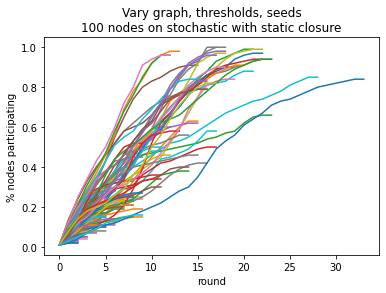

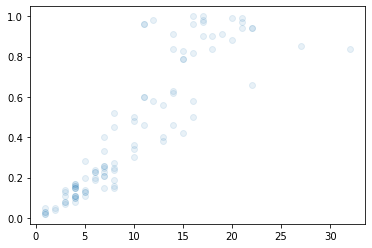

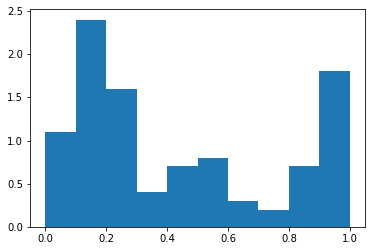

[11, 9, 56, 2, 4, 4, 3, 5, 2, 4]


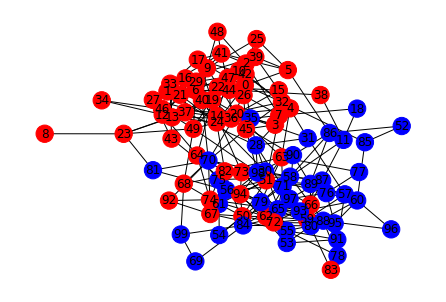

Now running static simulations for graph_params={'within_p': 0.1, 'between_p': 0.03}


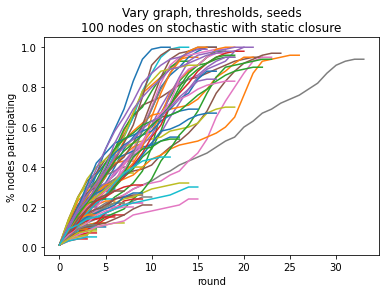

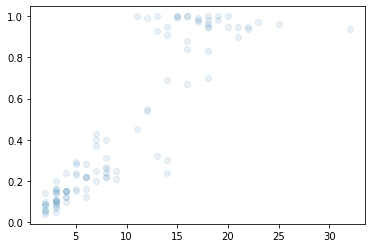

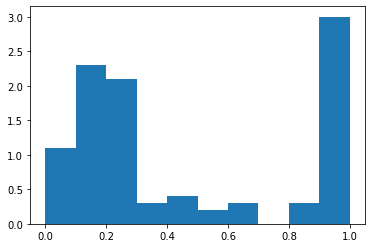

[100]


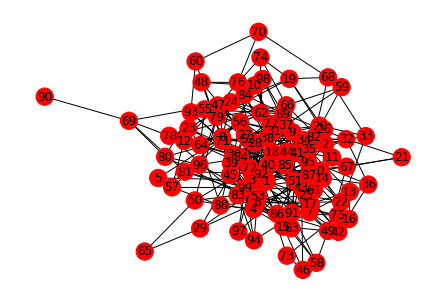

Now running static simulations for graph_params={'within_p': 0.1, 'between_p': 0.04}


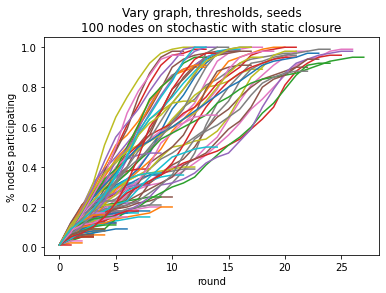

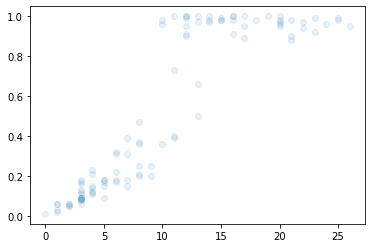

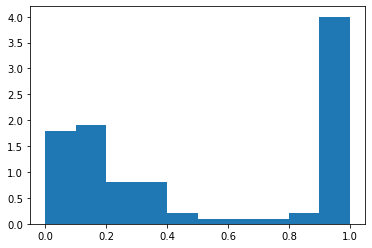

[100]


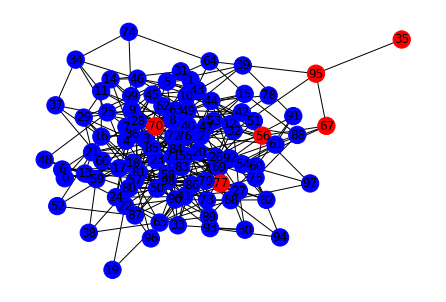

Now running static simulations for graph_params={'within_p': 0.1, 'between_p': 0.05}


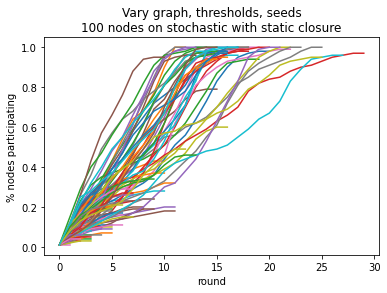

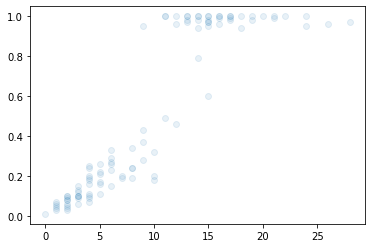

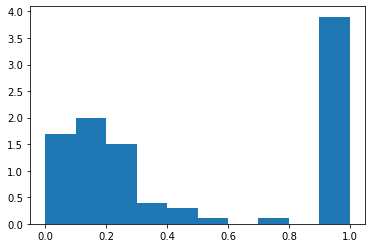

[100]


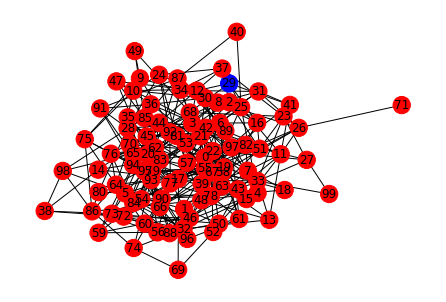

Now running static simulations for graph_params={'within_p': 0.1, 'between_p': 0.1}


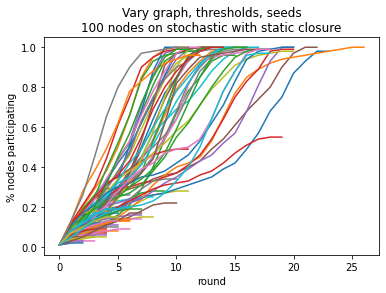

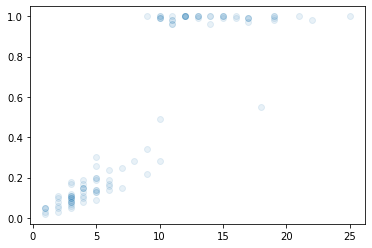

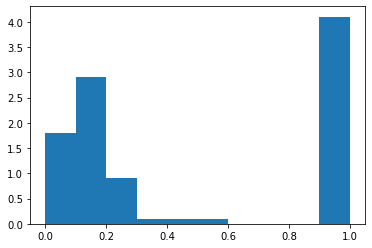

[43, 57]


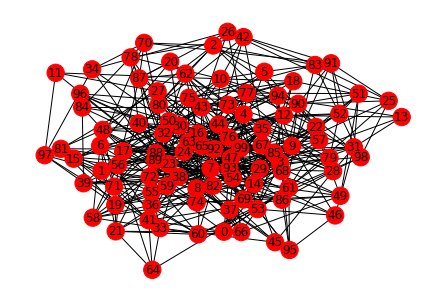

Now running static simulations for graph_params={'within_p': 0.15, 'between_p': 0.01}


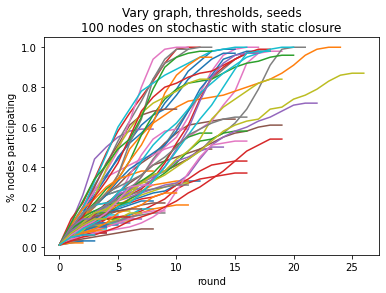

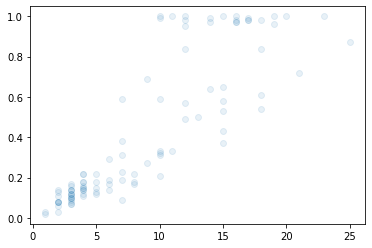

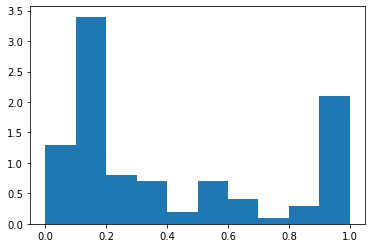

[50, 50]


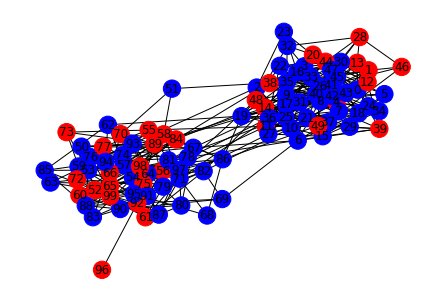

Now running static simulations for graph_params={'within_p': 0.15, 'between_p': 0.03}


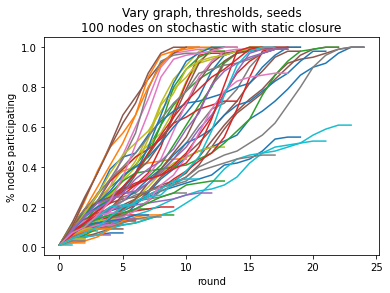

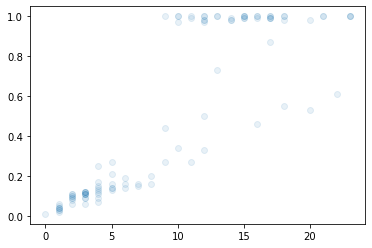

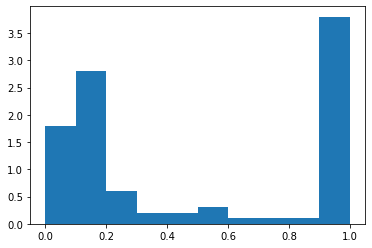

[68, 32]


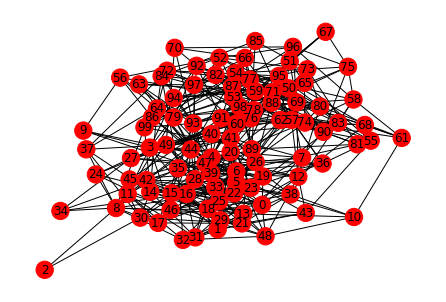

Now running static simulations for graph_params={'within_p': 0.15, 'between_p': 0.04}


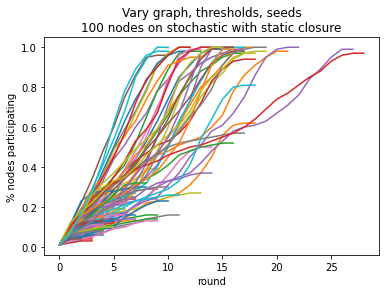

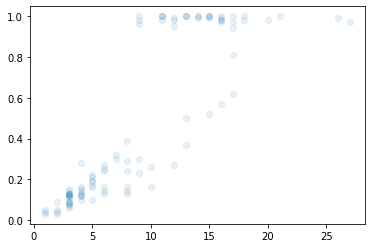

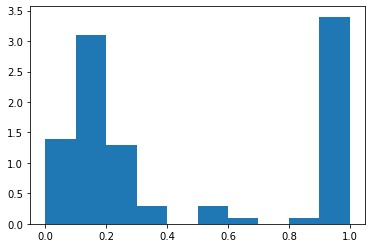

[100]


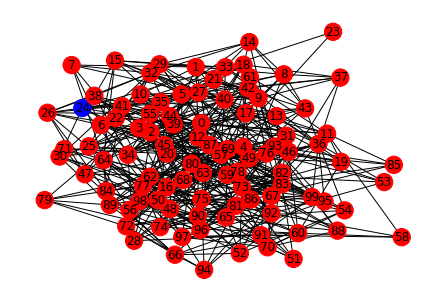

Now running static simulations for graph_params={'within_p': 0.15, 'between_p': 0.05}


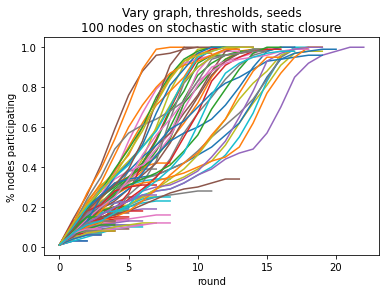

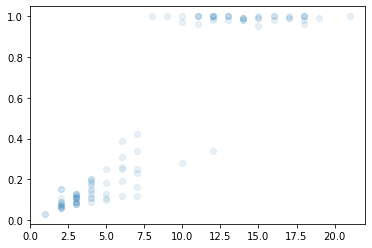

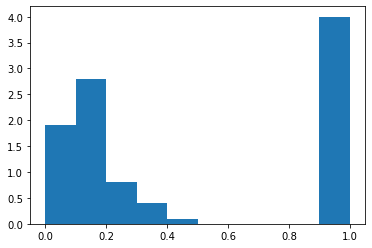

[100]


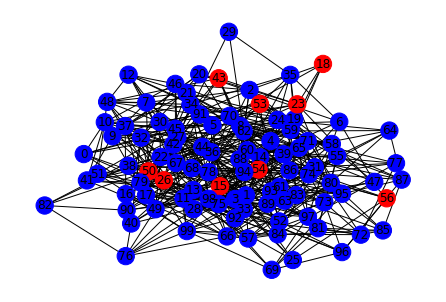

Now running static simulations for graph_params={'within_p': 0.15, 'between_p': 0.1}


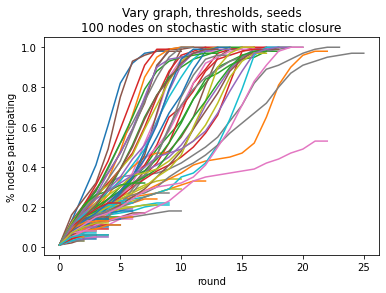

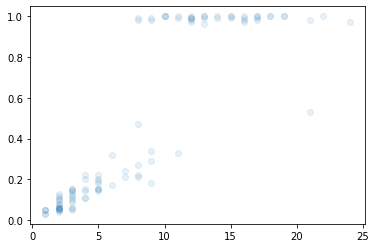

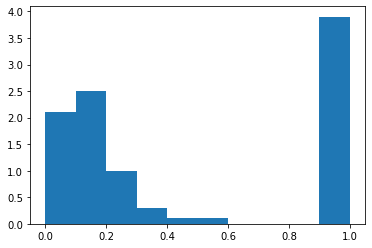

[100]


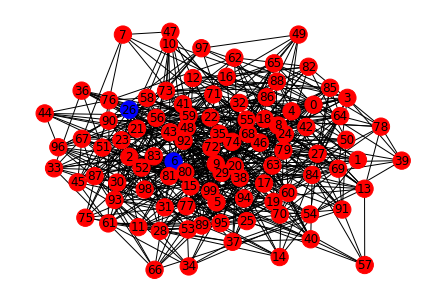

Now running static simulations for graph_params={'within_p': 0.19, 'between_p': 0.01}


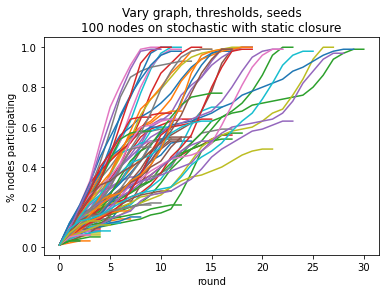

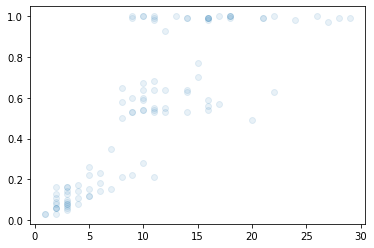

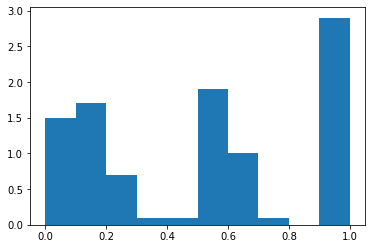

[50, 50]


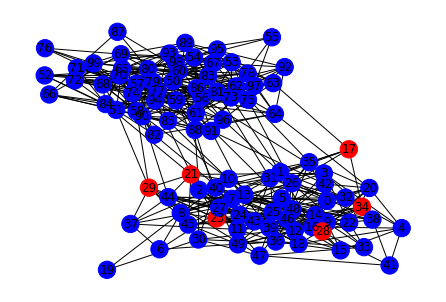

Now running static simulations for graph_params={'within_p': 0.19, 'between_p': 0.03}


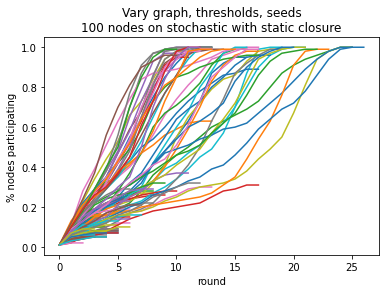

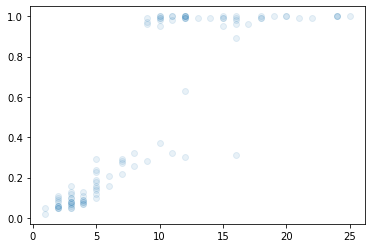

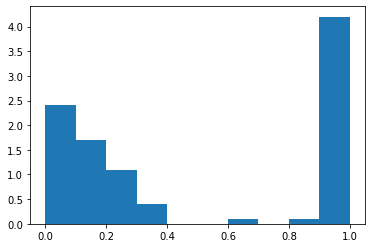

[100]


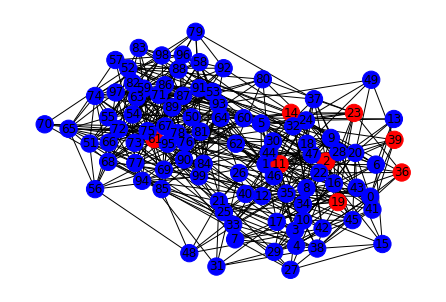

Now running static simulations for graph_params={'within_p': 0.19, 'between_p': 0.04}


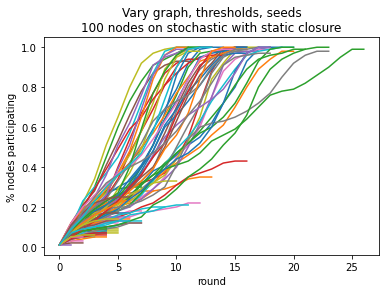

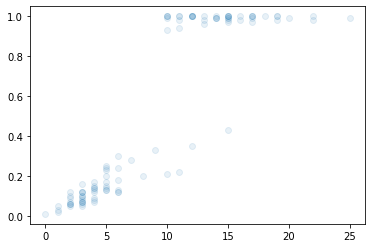

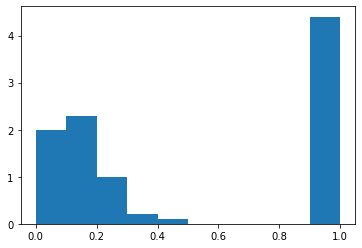

[100]


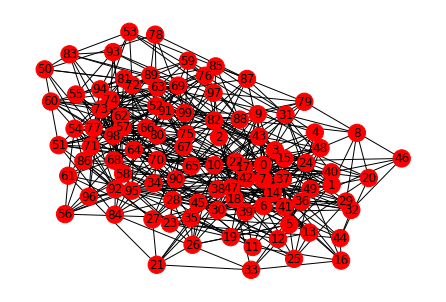

Now running static simulations for graph_params={'within_p': 0.19, 'between_p': 0.05}


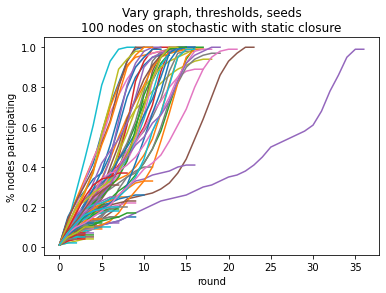

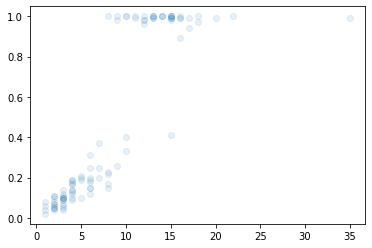

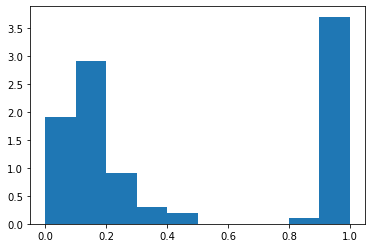

[100]


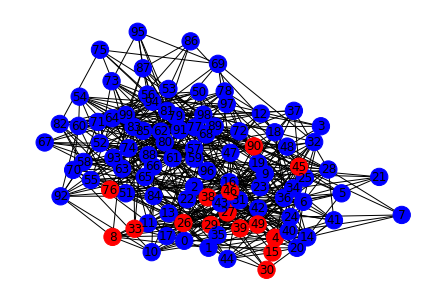

Now running static simulations for graph_params={'within_p': 0.19, 'between_p': 0.1}


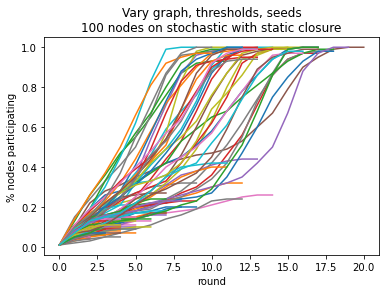

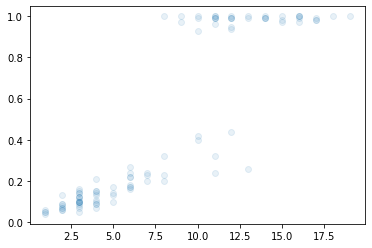

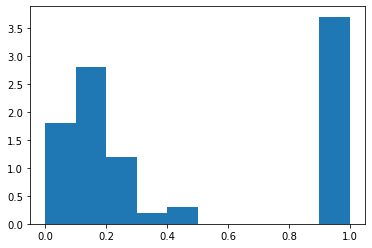

[100]


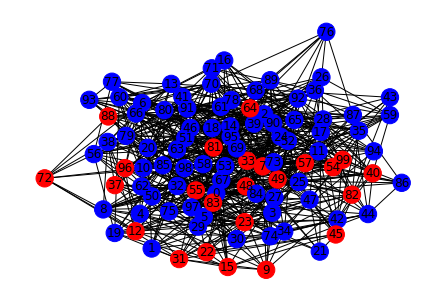

Now running static simulations for graph_params={'within_p': 0.2, 'between_p': 0.01}


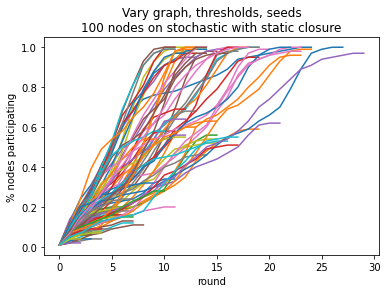

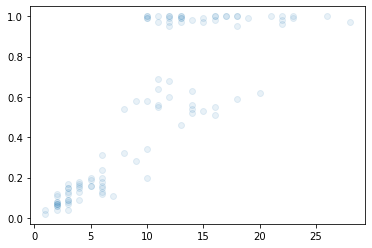

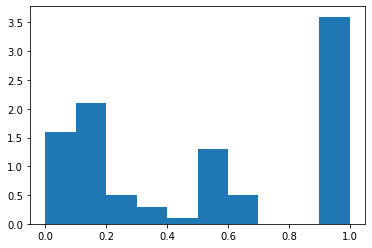

[50, 50]


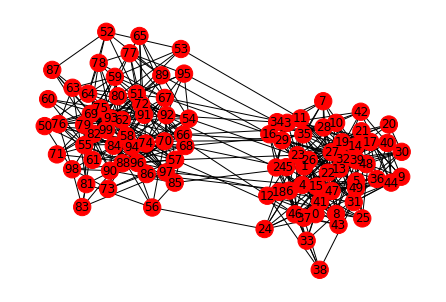

Now running static simulations for graph_params={'within_p': 0.2, 'between_p': 0.03}


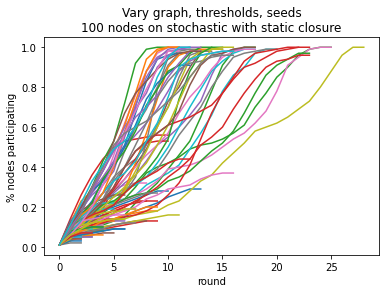

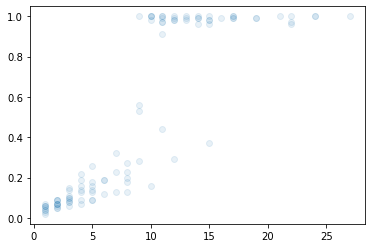

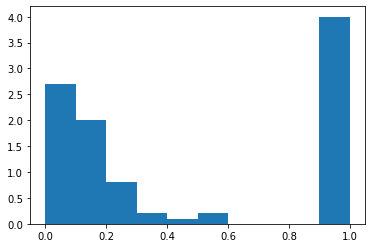

[50, 50]


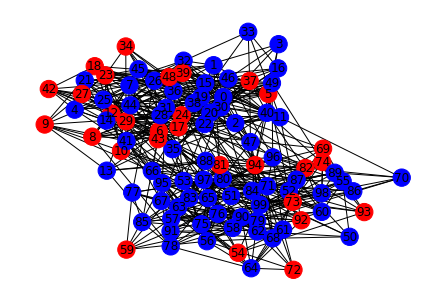

Now running static simulations for graph_params={'within_p': 0.2, 'between_p': 0.04}


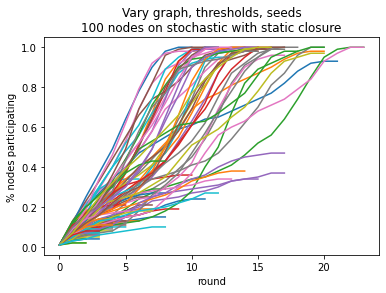

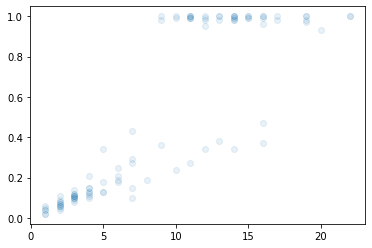

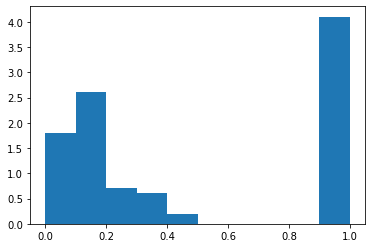

[100]


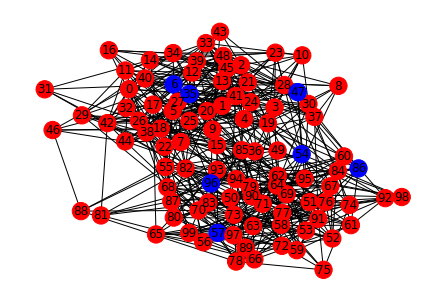

Now running static simulations for graph_params={'within_p': 0.2, 'between_p': 0.05}


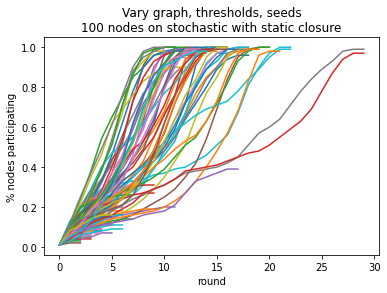

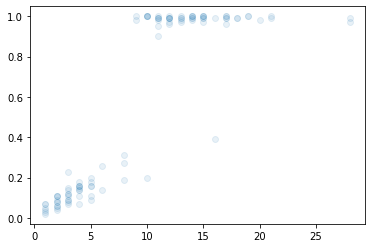

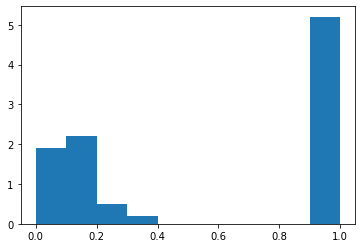

[100]


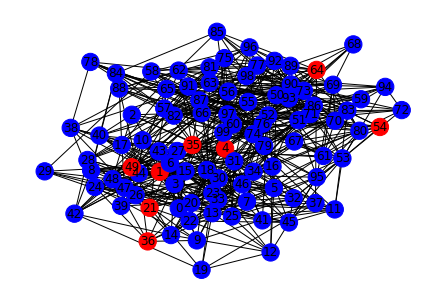

Now running static simulations for graph_params={'within_p': 0.2, 'between_p': 0.1}


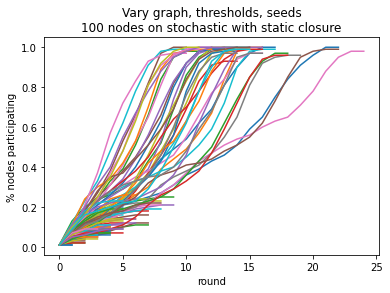

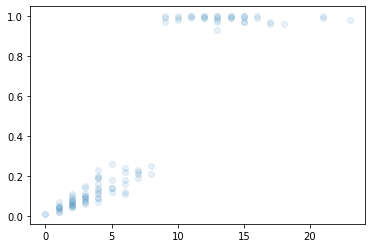

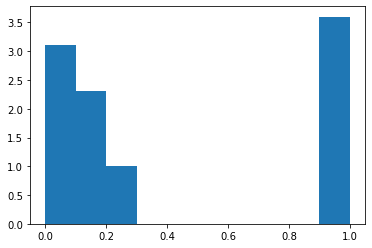

[100]


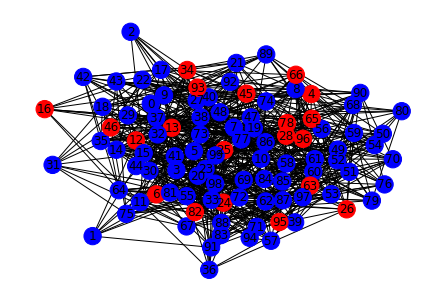

Now running static simulations for graph_params={'within_p': 0.3, 'between_p': 0.01}


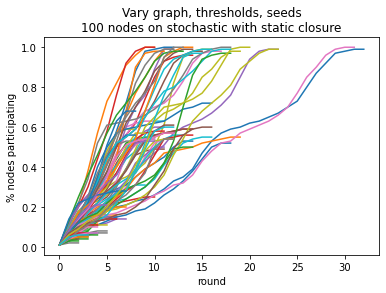

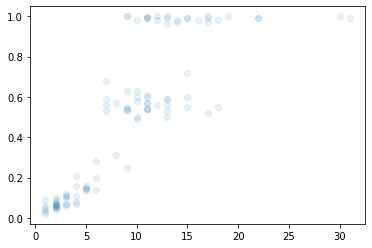

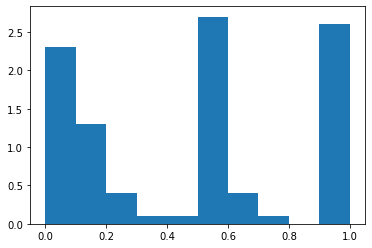

[50, 50]


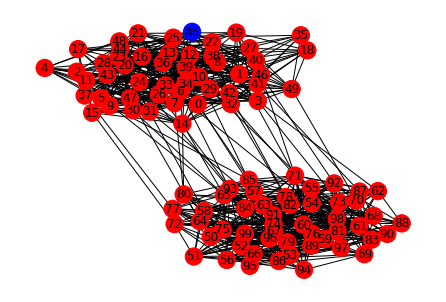

Now running static simulations for graph_params={'within_p': 0.3, 'between_p': 0.03}


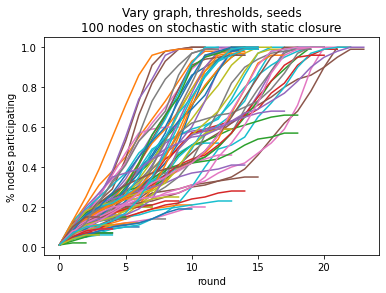

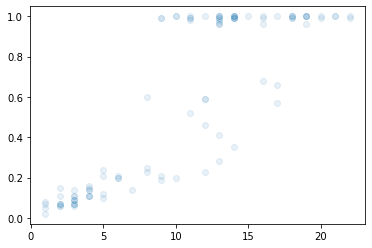

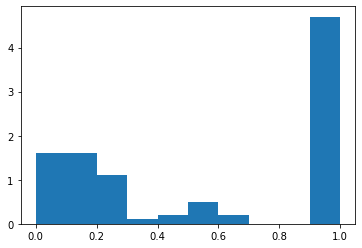

[50, 50]


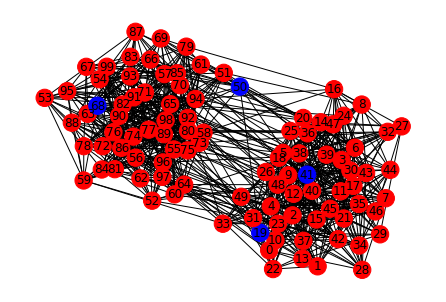

Now running static simulations for graph_params={'within_p': 0.3, 'between_p': 0.04}


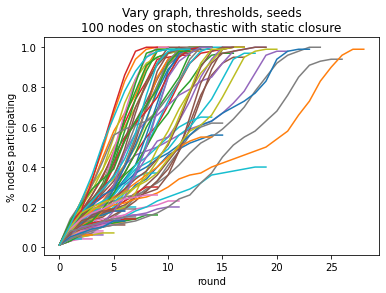

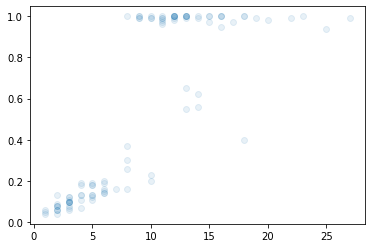

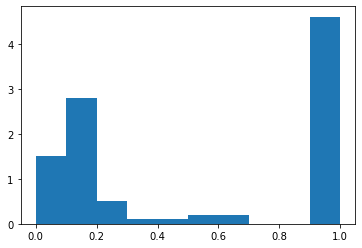

[100]


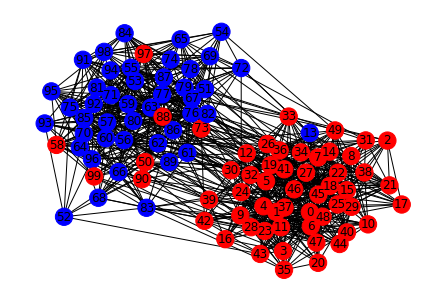

Now running static simulations for graph_params={'within_p': 0.3, 'between_p': 0.05}


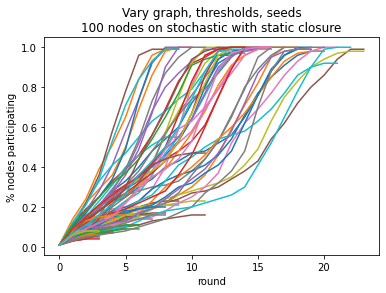

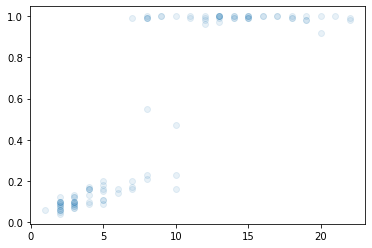

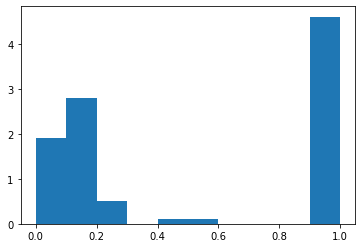

[100]


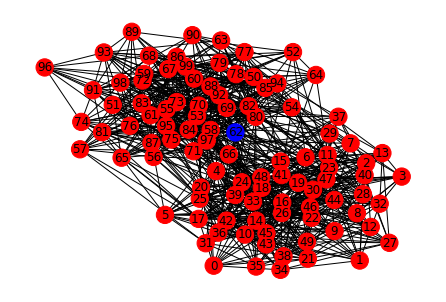

Now running static simulations for graph_params={'within_p': 0.3, 'between_p': 0.1}


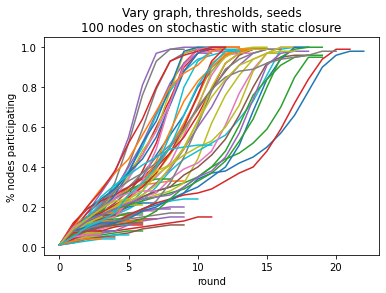

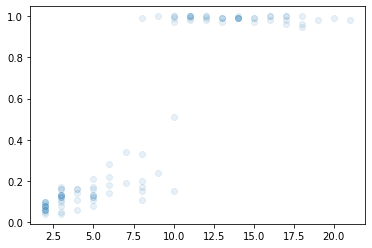

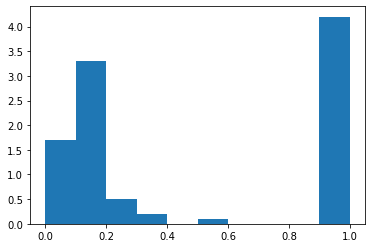

[100]


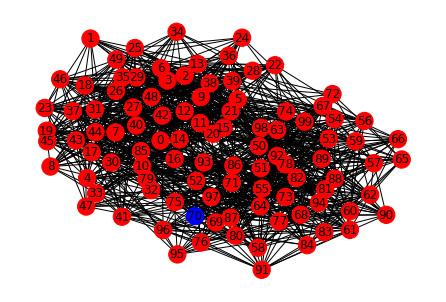

In [5]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
GRAPH_PARAMS_LIST = {
    'within_p': [0.1, 0.15, 0.19, 0.2, 0.3],
    'between_p': [0.01, 0.03, 0.04, 0.05, 0.1],
}
# Threshold hyperparameters
threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
seed_candidates = np.arange(num_nodes)
num_seeds = 1
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][4] if use_network else 'population_irrelevant'
closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for gp_within in GRAPH_PARAMS_LIST['within_p']:
    for gp_between in GRAPH_PARAMS_LIST['between_p']:
        graph_params = {'within_p':gp_within,'between_p':gp_between}
        print(f'Now running static simulations for graph_params={graph_params}')

        # Retrieve output from before
        (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = (None, None, None, None, None)

        rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
            sim_log,
            num_experiments, graph_type, num_nodes, graph_params, 
            threshold_mean, threshold_var, seed_candidates, num_seeds, 
            use_network, sticky_cascade, closure_method, closure_rate, 
            max_rounds, save_path=f'e2_communitysbm/sbm_modelstatic_paramwp{gp_within}bp{gp_between}.pkl', 
            use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
        )

        # print(rounds_filled)
        # print(rounds_frozen)
        # print(max_size_round)

        _ = plt.scatter(
            max_size_round,
            [r[-1] for r in sizes_round],
            alpha=0.1,
        )
        plt.show()

        _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
        plt.show()

        (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
            open(f'e2_communitysbm/sbm_modelstatic_paramwp{gp_within}bp{gp_between}.pkl', 'rb')
        )
        drawn_graph = sim_log[0][3][-1]
        drawn_colors = sim_log[0][4][-1]
        drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
        print(get_community_sizes(drawn_graph))
        nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
        plt.show()

## Visualize comparisons between these different metrics

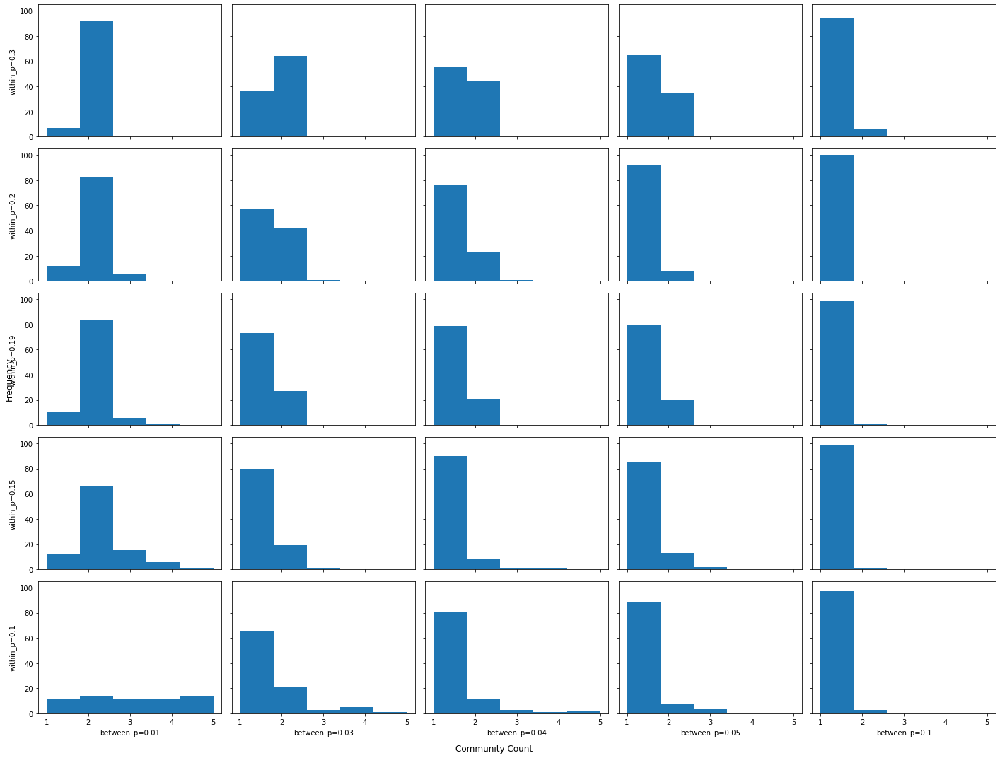

In [6]:
# Make community count histogram comparison

GRAPH_PARAMS_LIST = {
    'within_p': [0.1, 0.15, 0.19, 0.2, 0.3],
    'between_p': [0.01, 0.03, 0.04, 0.05, 0.1],
}

plt.rcParams['figure.figsize'] = [20, 15]
fig, axs = plt.subplots(5, 5, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('Community Count')
_ = fig.supylabel('Frequency')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    _ = axs[-gp_within_i-1][0].set_ylabel(f'within_p={gp_within}')
for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
    gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
    _ = axs[-1][gp_between_i].set_xlabel(f'between_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
        gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
        # Load files
        (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
            open(f'e2_communitysbm/sbm_modelstatic_paramwp{gp_within}bp{gp_between}.pkl', 'rb')
        )
        # Collect data
        community_counts = []
        for (drawn_graph, _, _, _, _, _, _) in sim_log:
            community_counts.append(len(get_community_sizes(drawn_graph)))
        # Make scatterplot
        _ = axs[-gp_within_i-1][gp_between_i].hist(
            community_counts, 
            bins=5, range=(1,5), 
        )
plt.show()

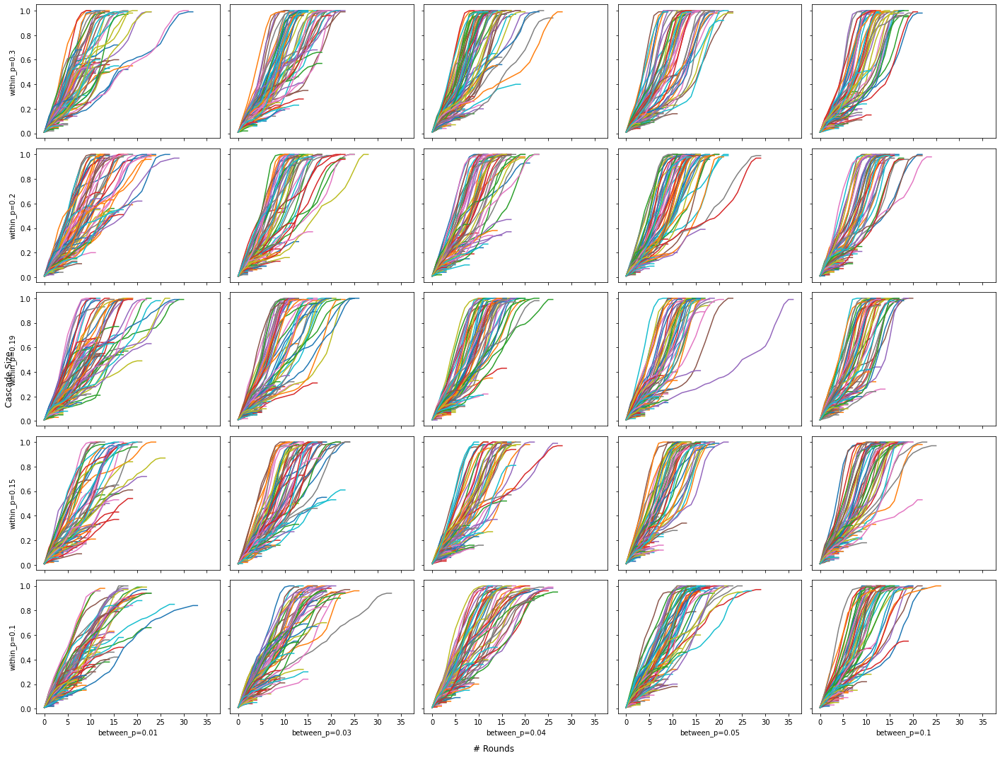

In [7]:
# Make line graph comparison

GRAPH_PARAMS_LIST = {
    'within_p': [0.1, 0.15, 0.19, 0.2, 0.3],
    'between_p': [0.01, 0.03, 0.04, 0.05, 0.1],
}

plt.rcParams['figure.figsize'] = [20, 15]
fig, axs = plt.subplots(5, 5, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('# Rounds')
_ = fig.supylabel('Cascade Size')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    _ = axs[-gp_within_i-1][0].set_ylabel(f'within_p={gp_within}')
for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
    gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
    _ = axs[-1][gp_between_i].set_xlabel(f'between_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
        gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
        # Load files
        (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
            open(f'e2_communitysbm/sbm_modelstatic_paramwp{gp_within}bp{gp_between}.pkl', 'rb')
        )
        # Make scatterplot
        for sizes_log in sizes_round:
            _ = axs[-gp_within_i-1][gp_between_i].plot(sizes_log)
plt.show()

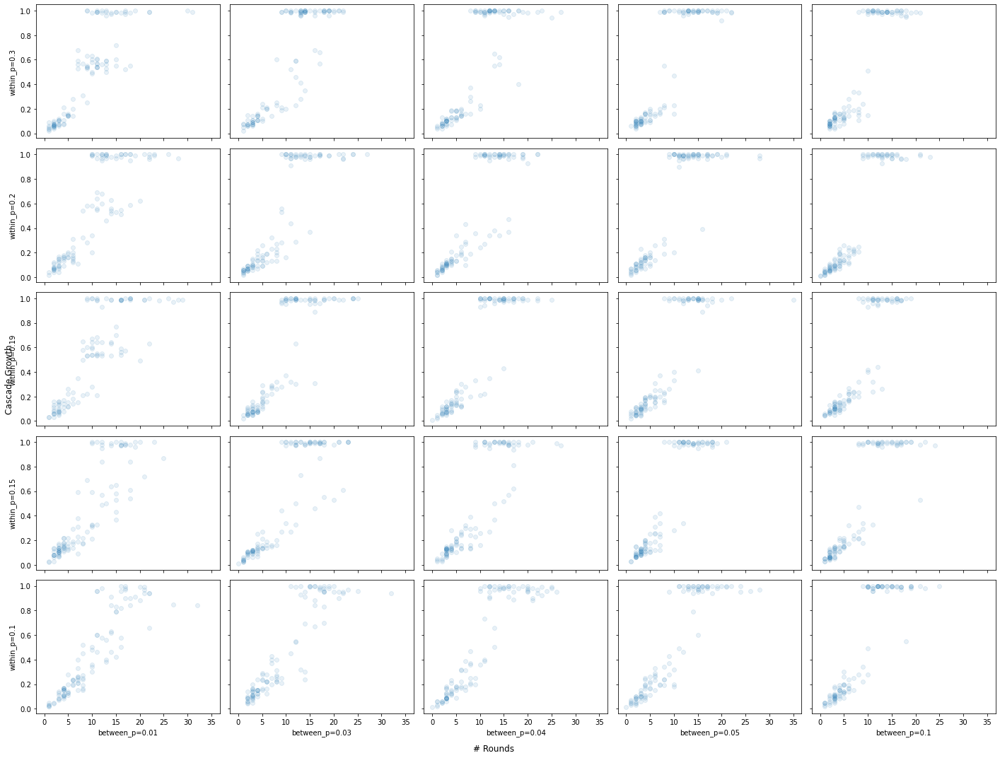

In [8]:
# Make scatterplot comparison

GRAPH_PARAMS_LIST = {
    'within_p': [0.1, 0.15, 0.19, 0.2, 0.3],
    'between_p': [0.01, 0.03, 0.04, 0.05, 0.1],
}

plt.rcParams['figure.figsize'] = [20, 15]
fig, axs = plt.subplots(5, 5, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('# Rounds')
_ = fig.supylabel('Cascade Growth')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    _ = axs[-gp_within_i-1][0].set_ylabel(f'within_p={gp_within}')
for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
    gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
    _ = axs[-1][gp_between_i].set_xlabel(f'between_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
        gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
        # Load files
        (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
            open(f'e2_communitysbm/sbm_modelstatic_paramwp{gp_within}bp{gp_between}.pkl', 'rb')
        )
        # Make scatterplot
        _ = axs[-gp_within_i-1][gp_between_i].scatter(
            max_size_round,
            [r[-1] for r in sizes_round],
            alpha=0.1,
        )
plt.show()

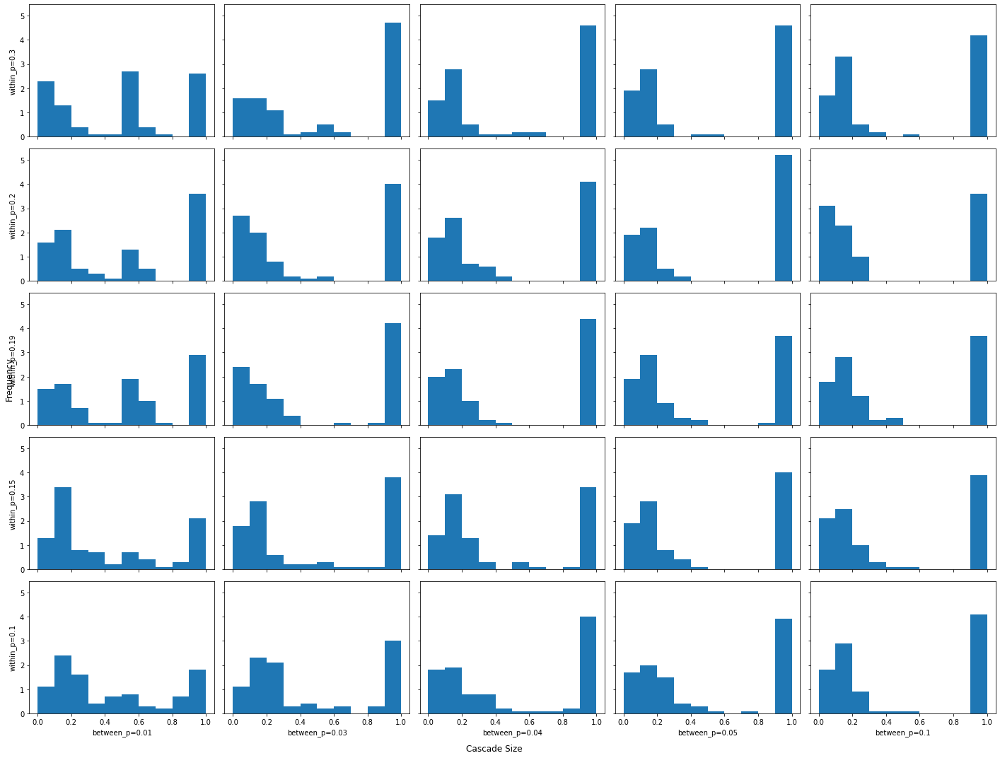

In [9]:
# Make final size histogram comparison

GRAPH_PARAMS_LIST = {
    'within_p': [0.1, 0.15, 0.19, 0.2, 0.3],
    'between_p': [0.01, 0.03, 0.04, 0.05, 0.1],
}

plt.rcParams['figure.figsize'] = [20, 15]
fig, axs = plt.subplots(5, 5, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('Cascade Size')
_ = fig.supylabel('Frequency')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    _ = axs[-gp_within_i-1][0].set_ylabel(f'within_p={gp_within}')
for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
    gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
    _ = axs[-1][gp_between_i].set_xlabel(f'between_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_LIST['within_p'])):
    gp_within = GRAPH_PARAMS_LIST['within_p'][gp_within_i]
    for gp_between_i in range(len(GRAPH_PARAMS_LIST['between_p'])):
        gp_between = GRAPH_PARAMS_LIST['between_p'][gp_between_i]
        # Load files
        (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
            open(f'e2_communitysbm/sbm_modelstatic_paramwp{gp_within}bp{gp_between}.pkl', 'rb')
        )
        # Make histogram
        _ = axs[-gp_within_i-1][gp_between_i].hist(
            [r[-1] for r in sizes_round], 
            range=(0,1), 
            bins=10, 
            density=True
        )
plt.show()

# Find a set of hyperparameters that create SBM with expected degree 10

Now running static simulations for graph_params={'within_p': 0.1825, 'between_p': 0.017500000000000005}


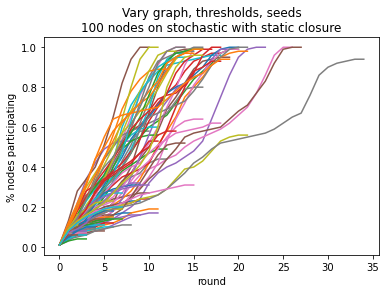

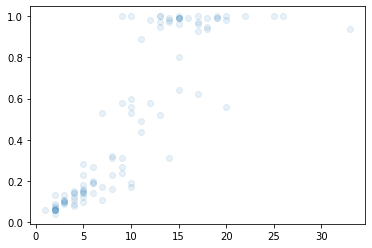

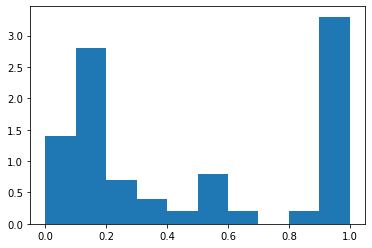

[79, 21]


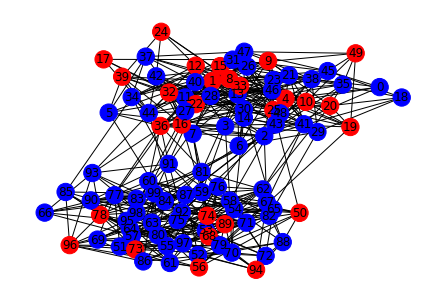

Now running static simulations for graph_params={'within_p': 0.185, 'between_p': 0.014999999999999993}


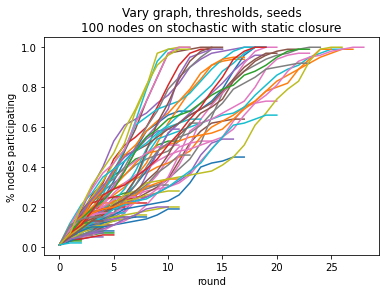

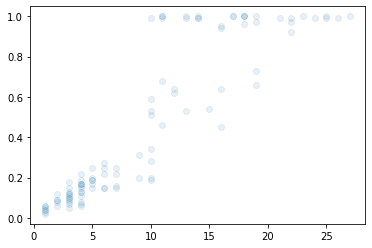

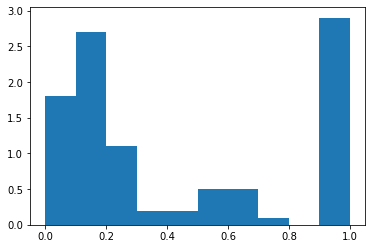

[50, 11, 22, 17]


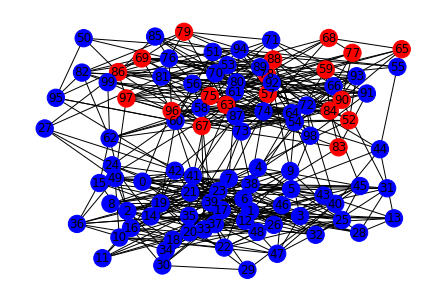

Now running static simulations for graph_params={'within_p': 0.1875, 'between_p': 0.0125}


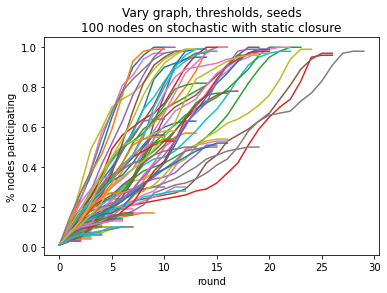

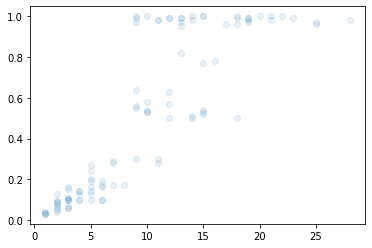

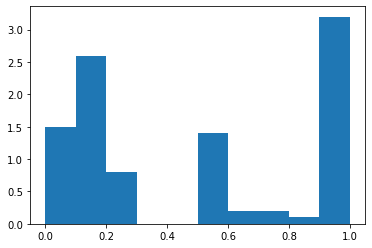

[50, 50]


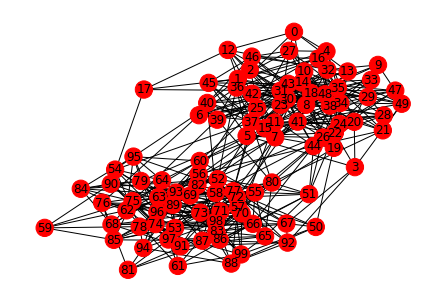

Now running static simulations for graph_params={'within_p': 0.19, 'between_p': 0.010000000000000009}


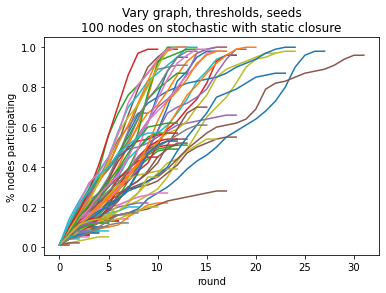

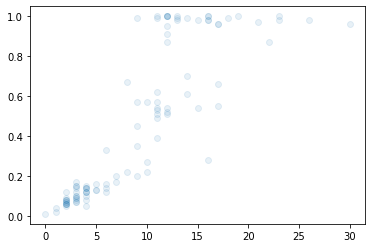

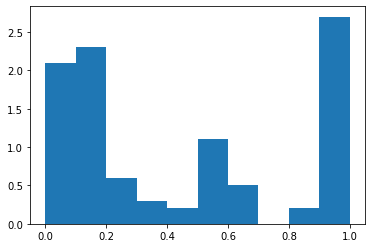

[33, 17, 50]


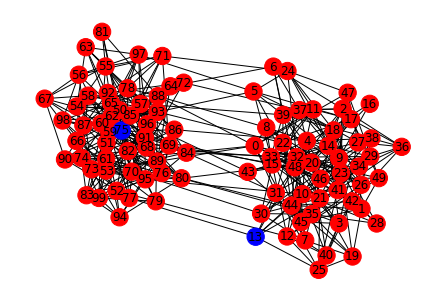

Now running static simulations for graph_params={'within_p': 0.1925, 'between_p': 0.007499999999999996}


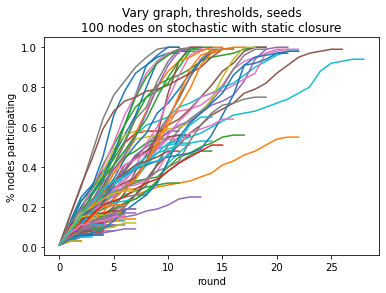

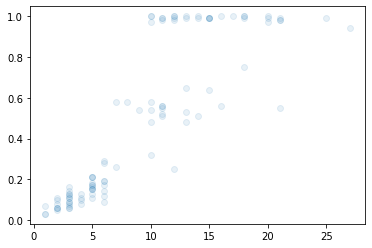

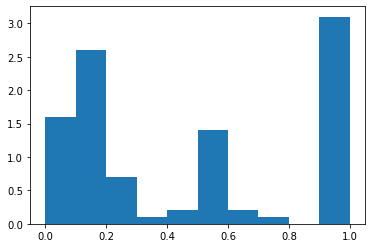

[17, 33, 50]


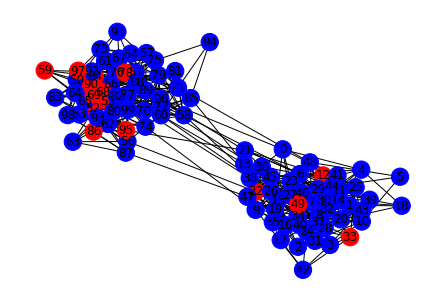

Now running static simulations for graph_params={'within_p': 0.195, 'between_p': 0.004999999999999983}


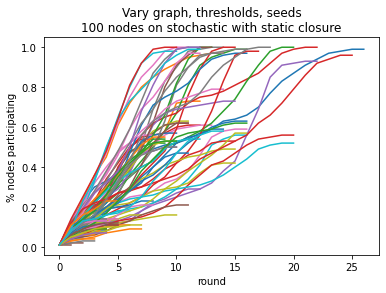

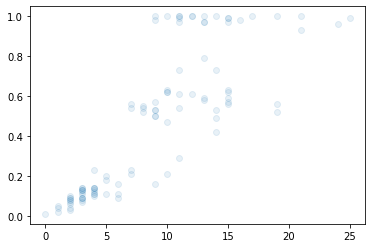

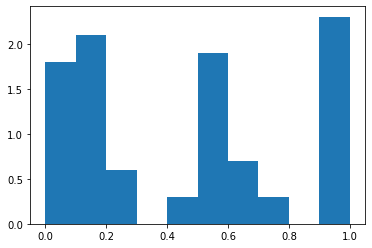

[100]


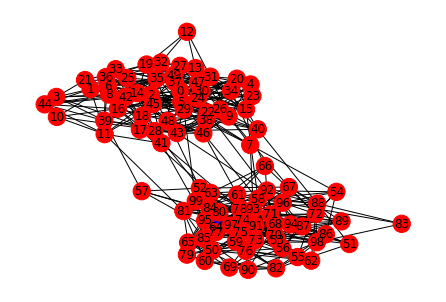

Now running static simulations for graph_params={'within_p': 0.1975, 'between_p': 0.0024999999999999914}


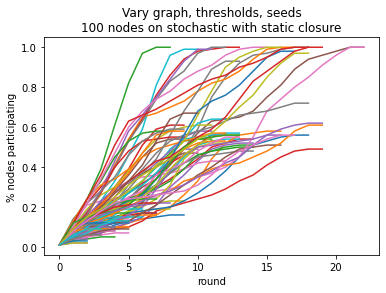

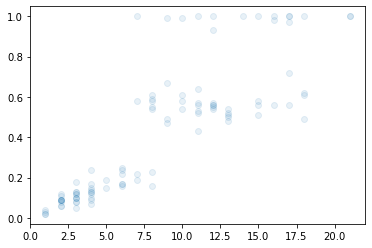

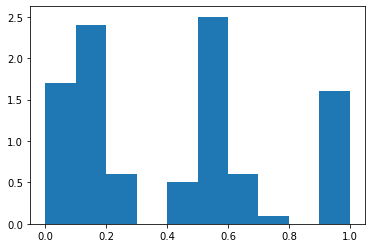

[50, 50]


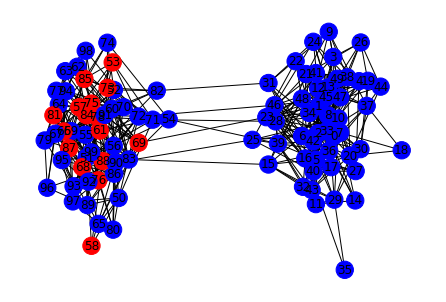

In [10]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
GRAPH_PARAMS_WITHIN_LIST = [0.1825, 0.185, 0.1875, 0.19, 0.1925, 0.195, 0.1975]
# Threshold hyperparameters
threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
seed_candidates = np.arange(num_nodes)
num_seeds = 1
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][4] if use_network else 'population_irrelevant'
closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for gp_within in GRAPH_PARAMS_WITHIN_LIST:
    gp_between = 0.2*(1-(5*gp_within))
    graph_params = {'within_p':gp_within,'between_p':gp_between}
    print(f'Now running static simulations for graph_params={graph_params}')

    # Retrieve output from before
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = (None, None, None, None, None)

    rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
        sim_log,
        num_experiments, graph_type, num_nodes, graph_params, 
        threshold_mean, threshold_var, seed_candidates, num_seeds, 
        use_network, sticky_cascade, closure_method, closure_rate, 
        max_rounds, save_path=f'e2_communitysbm/sbm_modelstatic_deg10wp{gp_within}.pkl', 
        use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
    )

    # print(rounds_filled)
    # print(rounds_frozen)
    # print(max_size_round)

    _ = plt.scatter(
        max_size_round,
        [r[-1] for r in sizes_round],
        alpha=0.1,
    )
    plt.show()

    _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
    plt.show()

    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_modelstatic_deg10wp{gp_within}.pkl', 'rb')
    )
    drawn_graph = sim_log[0][3][-1]
    drawn_colors = sim_log[0][4][-1]
    drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
    print(get_community_sizes(drawn_graph))
    nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
    plt.show()

## Visualize comparisons between different hyperparameters and common community count

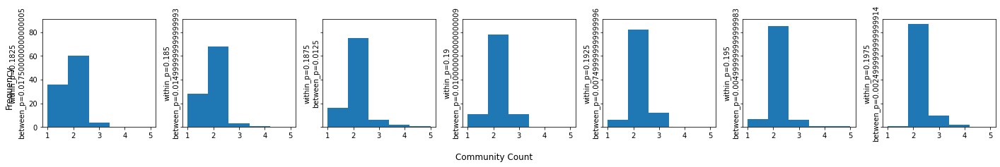

In [11]:
# Make community count histogram comparison

GRAPH_PARAMS_WITHIN_LIST = [0.1825, 0.185, 0.1875, 0.19, 0.1925, 0.195, 0.1975]

plt.rcParams['figure.figsize'] = [20, 3]
fig, axs = plt.subplots(1, 7, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('Community Count')
_ = fig.supylabel('Frequency')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    _ = axs[gp_within_i].set_ylabel(f'within_p={gp_within}\nbetween_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    # Load files
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_modelstatic_deg10wp{gp_within}.pkl', 'rb')
    )
    # Collect data
    community_counts = []
    for (drawn_graph, _, _, _, _, _, _) in sim_log:
        community_counts.append(len(get_community_sizes(drawn_graph)))
    # Make scatterplot
    _ = axs[gp_within_i].hist(
        community_counts, 
        bins=5, range=(1,5), 
    )
plt.show()

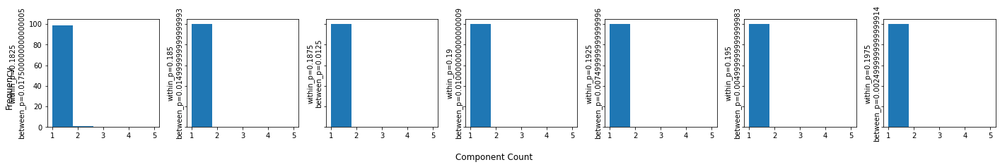

In [12]:
# Make component count histogram comparison

GRAPH_PARAMS_WITHIN_LIST = [0.1825, 0.185, 0.1875, 0.19, 0.1925, 0.195, 0.1975]

plt.rcParams['figure.figsize'] = [20, 3]
fig, axs = plt.subplots(1, 7, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('Component Count')
_ = fig.supylabel('Frequency')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    _ = axs[gp_within_i].set_ylabel(f'within_p={gp_within}\nbetween_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    # Load files
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_modelstatic_deg10wp{gp_within}.pkl', 'rb')
    )
    # Collect data
    component_counts = []
    for (drawn_graph, _, _, _, _, _, _) in sim_log:
        component_counts.append(nx.algorithms.components.number_connected_components(drawn_graph))
    # Make miniplot
    _ = axs[gp_within_i].hist(
        component_counts, 
        bins=5, range=(1,5), 
    )
plt.show()

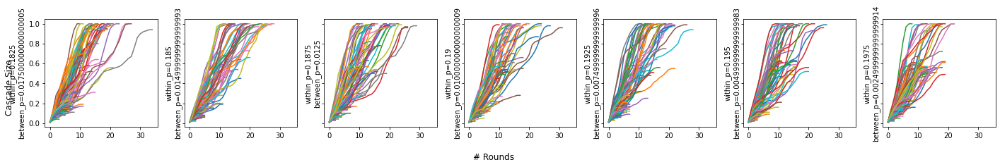

In [13]:
# Make line graph comparison

GRAPH_PARAMS_WITHIN_LIST = [0.1825, 0.185, 0.1875, 0.19, 0.1925, 0.195, 0.1975]

plt.rcParams['figure.figsize'] = [20, 3]
fig, axs = plt.subplots(1, 7, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('# Rounds')
_ = fig.supylabel('Cascade Size')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    _ = axs[gp_within_i].set_ylabel(f'within_p={gp_within}\nbetween_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    # Load files
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_modelstatic_deg10wp{gp_within}.pkl', 'rb')
    )
    # Make miniplot
    for sizes_log in sizes_round:
        _ = axs[gp_within_i].plot(sizes_log)
plt.show()

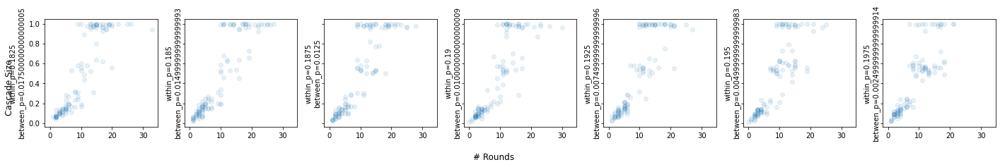

In [14]:
# Make scatterplot comparison

GRAPH_PARAMS_WITHIN_LIST = [0.1825, 0.185, 0.1875, 0.19, 0.1925, 0.195, 0.1975]

plt.rcParams['figure.figsize'] = [20, 3]
fig, axs = plt.subplots(1, 7, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('# Rounds')
_ = fig.supylabel('Cascade Size')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    _ = axs[gp_within_i].set_ylabel(f'within_p={gp_within}\nbetween_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    # Load files
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_modelstatic_deg10wp{gp_within}.pkl', 'rb')
    )
    # Make miniplot
    _ = axs[gp_within_i].scatter(
        max_size_round,
        [r[-1] for r in sizes_round],
        alpha=0.1,
    )
plt.show()

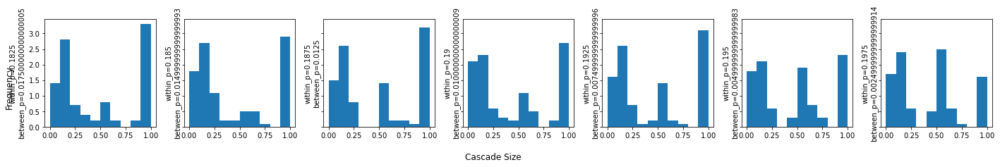

In [15]:
# Make final size histogram comparison

GRAPH_PARAMS_WITHIN_LIST = [0.1825, 0.185, 0.1875, 0.19, 0.1925, 0.195, 0.1975]

plt.rcParams['figure.figsize'] = [20, 3]
fig, axs = plt.subplots(1, 7, sharey=True, sharex=True, tight_layout=True)
_ = fig.supxlabel('Cascade Size')
_ = fig.supylabel('Frequency')

# Add labels
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    _ = axs[gp_within_i].set_ylabel(f'within_p={gp_within}\nbetween_p={gp_between}')
# Add data
for gp_within_i in range(len(GRAPH_PARAMS_WITHIN_LIST)):
    gp_within = GRAPH_PARAMS_WITHIN_LIST[gp_within_i]
    gp_between = 0.2*(1-(5*gp_within))
    # Load files
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_modelstatic_deg10wp{gp_within}.pkl', 'rb')
    )
    # Make miniplot
    _ = axs[gp_within_i].hist(
        [r[-1] for r in sizes_round],
        range=(0,1),
        bins=10,
        density=True
    )
plt.show()

# Compare the impact that different edge creation rates have on 1-seed SBM cascade behavior

## Graph (100 nodes 0.19 wp 0.01 bp) Threshold (0.4 mean 0.25 var) Seed (1) Closure (Max X) ; X in (1, 5, 10, 25, 50, 75, 100, 250, 500)

Now running simulation for closure_rate=1


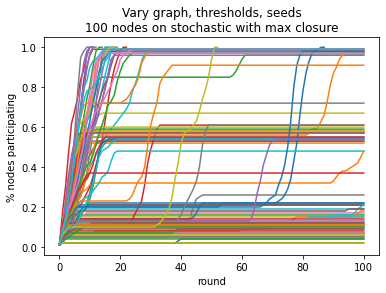

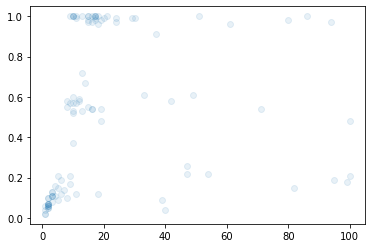

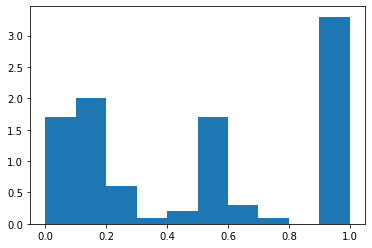

[50, 50]


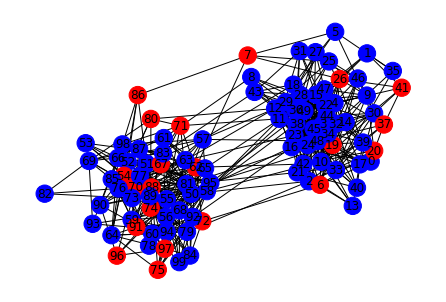

Now running simulation for closure_rate=5


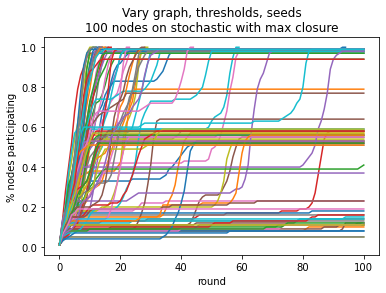

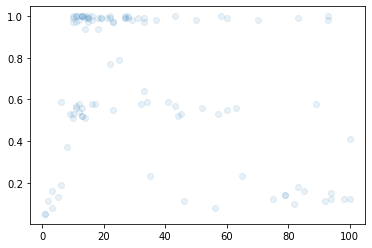

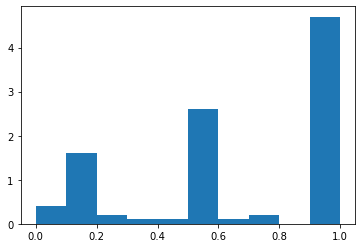

[50, 50]


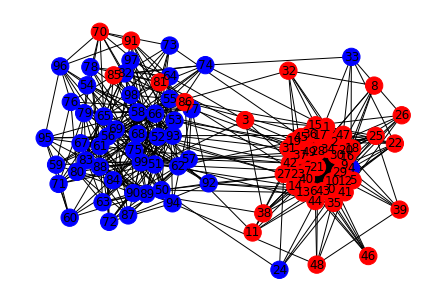

Now running simulation for closure_rate=10


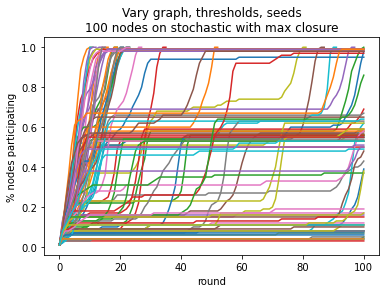

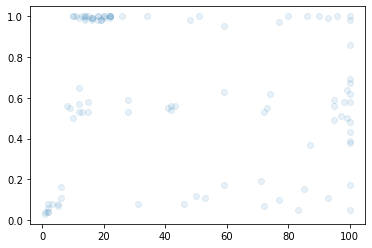

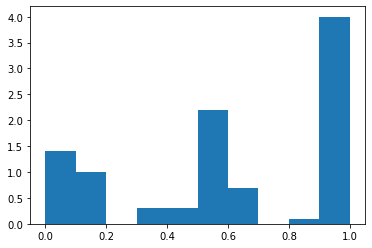

[50, 50]


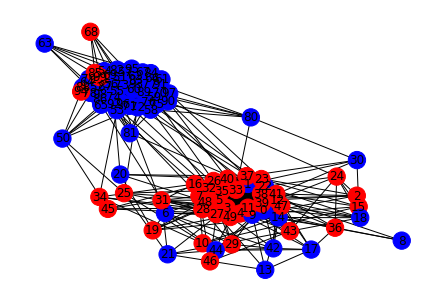

Now running simulation for closure_rate=25


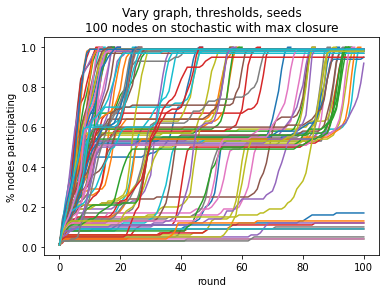

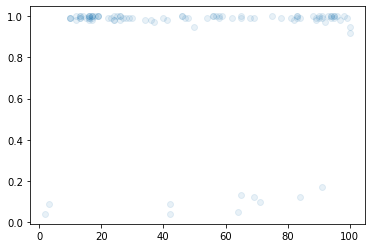

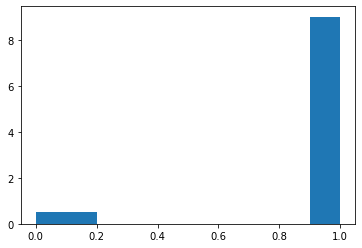

[100]


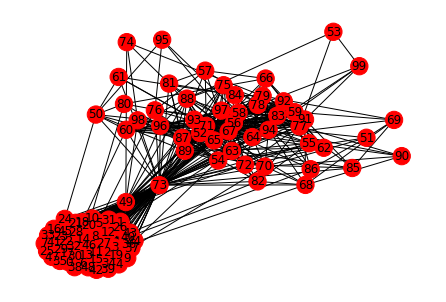

Now running simulation for closure_rate=50


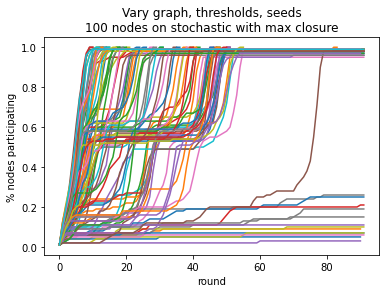

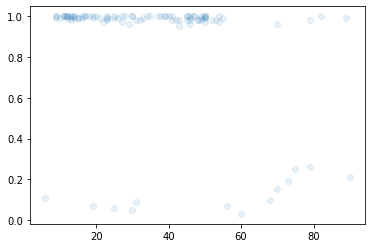

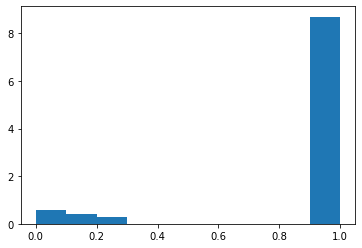

[50, 50]


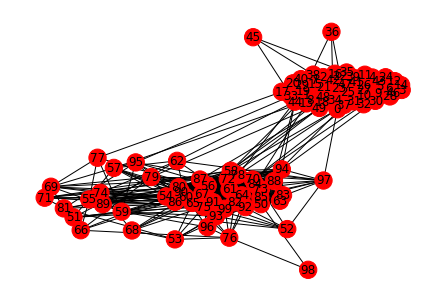

Now running simulation for closure_rate=75


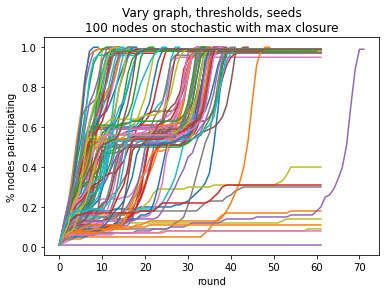

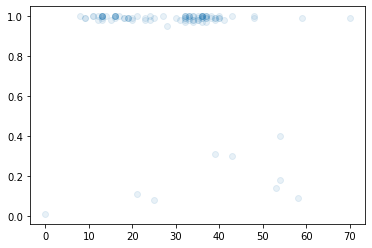

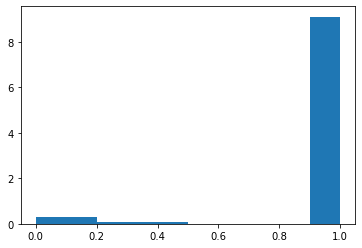

[50, 50]


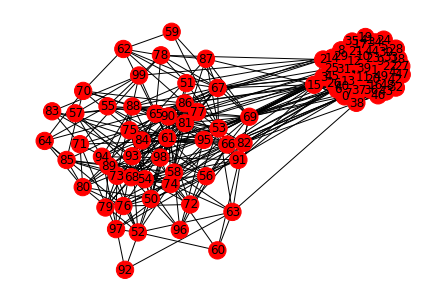

Now running simulation for closure_rate=100


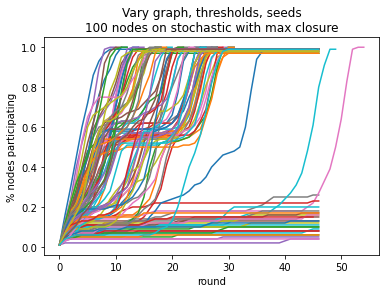

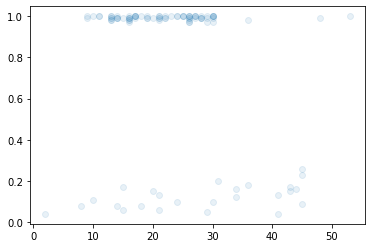

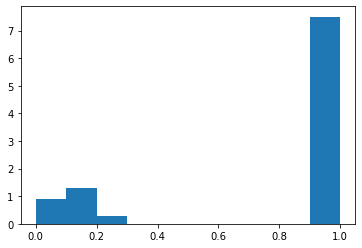

[100]


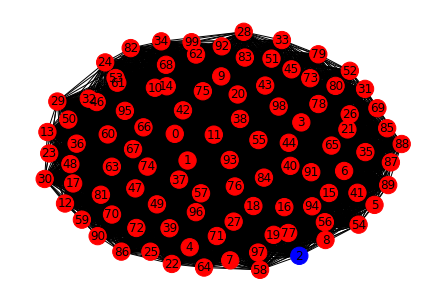

Now running simulation for closure_rate=250


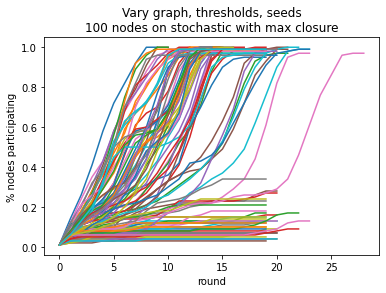

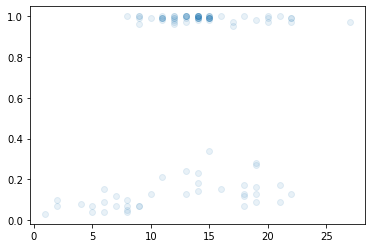

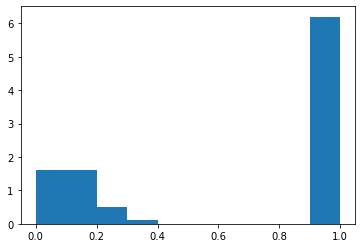

[100]


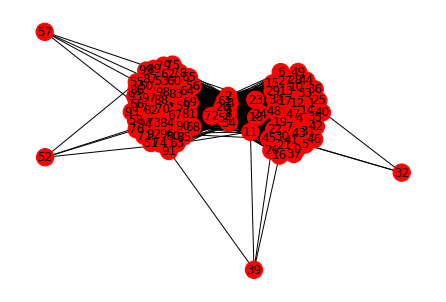

Now running simulation for closure_rate=500


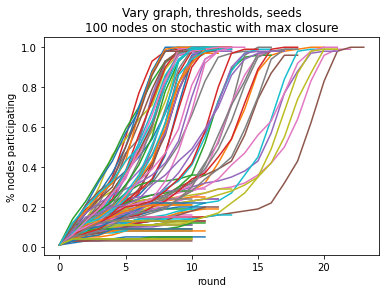

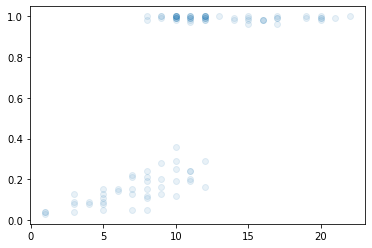

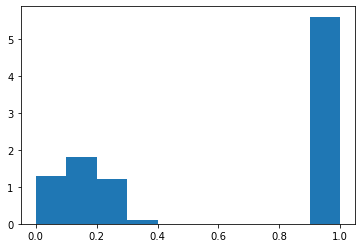

[100]


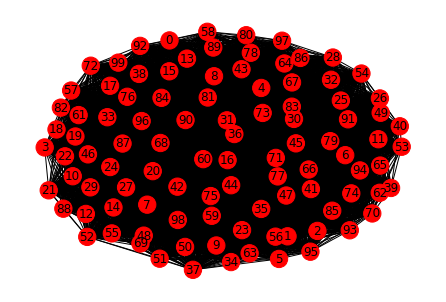

In [16]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
seed_candidates = np.arange(num_nodes)
num_seeds = 1
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][0] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for closure_rate in CLOSURE_RATE_LIST:
    print(f'Now running simulation for closure_rate={closure_rate}')

    # Retrieve output from before
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = (None, None, None, None, None)

    rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
        sim_log,
        num_experiments, graph_type, num_nodes, graph_params, 
        threshold_mean, threshold_var, seed_candidates, num_seeds, 
        use_network, sticky_cascade, closure_method, closure_rate, 
        max_rounds, save_path=f'e2_communitysbm/sbm_1seed_modelmax_closure{closure_rate}.pkl', 
        use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
    )

    # print(rounds_filled)
    # print(rounds_frozen)
    # print(max_size_round)

    _ = plt.scatter(
        max_size_round,
        [r[-1] for r in sizes_round],
        alpha=0.1,
    )
    plt.show()

    _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
    plt.show()

    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_1seed_modelmax_closure{closure_rate}.pkl', 'rb')
    )
    drawn_graph = sim_log[0][3][-1]
    drawn_colors = sim_log[0][4][-1]
    drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
    print(get_community_sizes(drawn_graph))
    nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
    plt.show()

## IDENTICAL AS ABOVE Graph Threshold Seed settings ; Simulating with Closure (Static)

Now running simulation for closure_rate=1


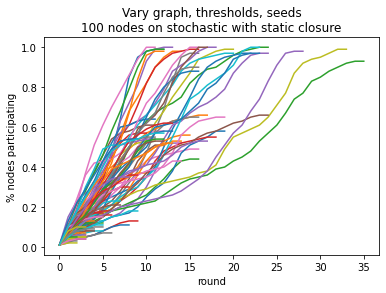

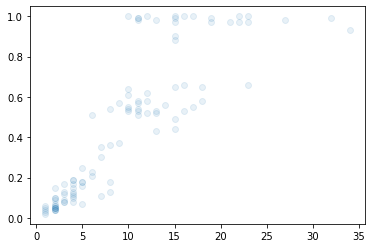

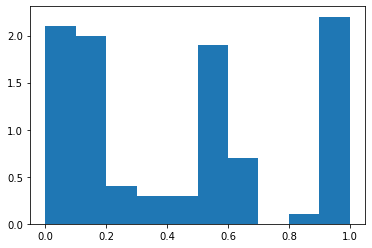

[50, 50]


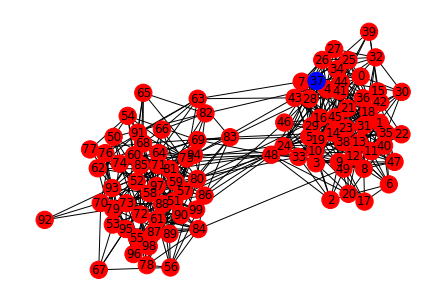

Now running simulation for closure_rate=5


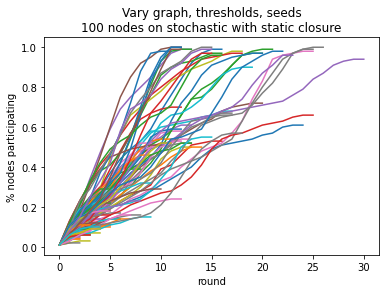

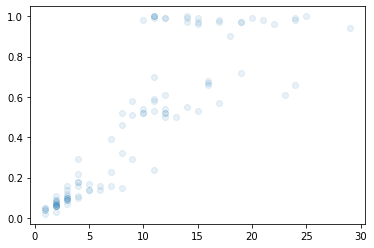

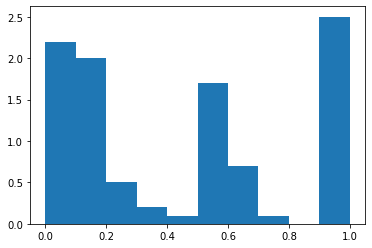

[50, 50]


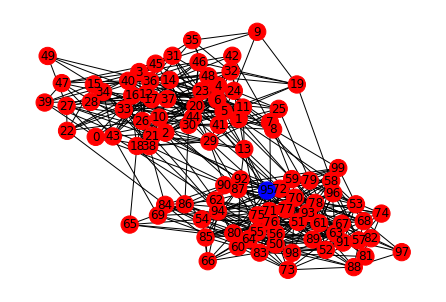

Now running simulation for closure_rate=10


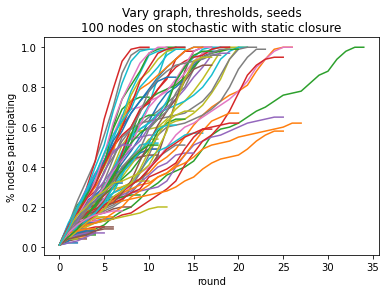

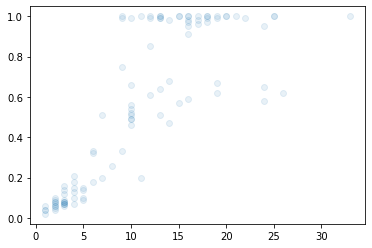

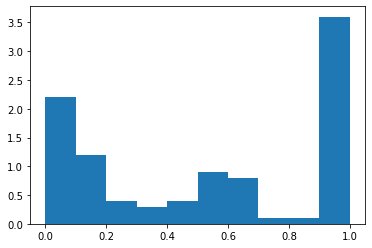

[27, 23, 50]


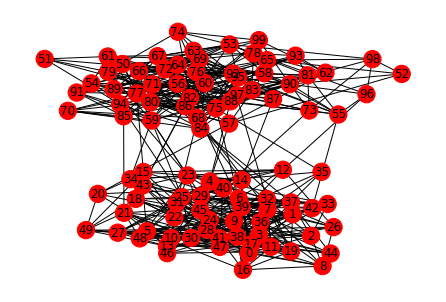

Now running simulation for closure_rate=25


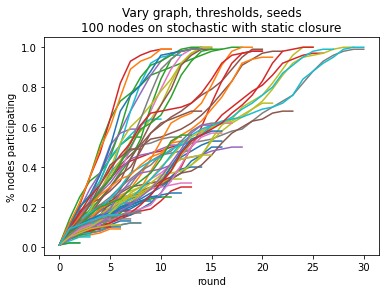

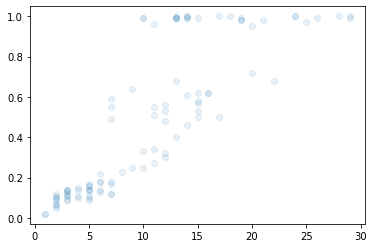

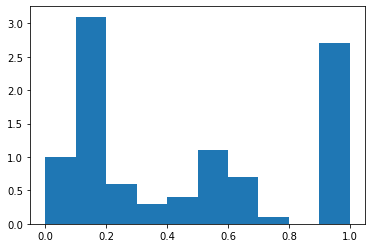

[50, 50]


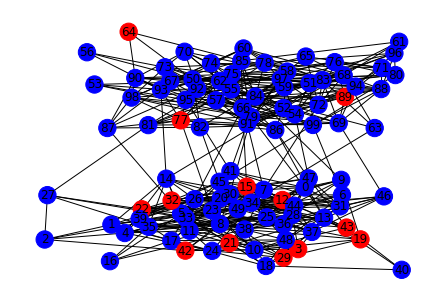

Now running simulation for closure_rate=50


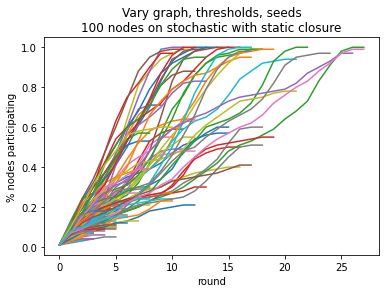

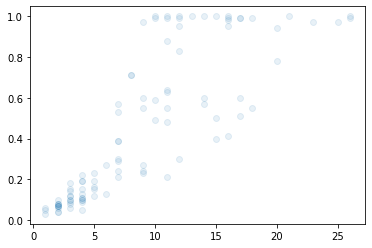

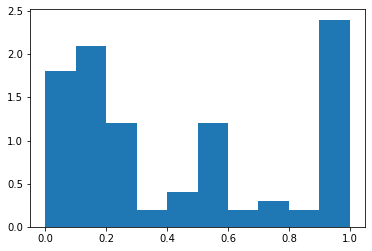

[50, 50]


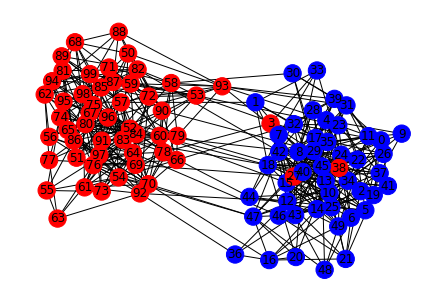

Now running simulation for closure_rate=75


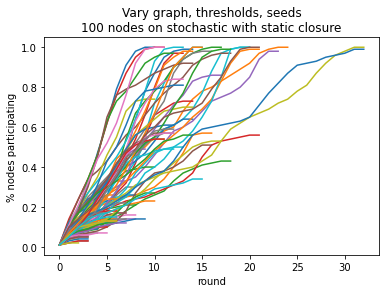

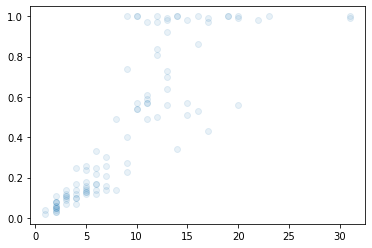

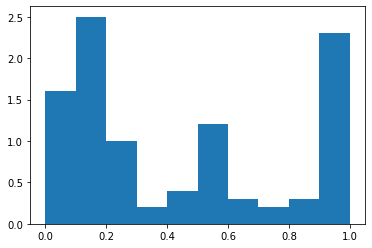

[100]


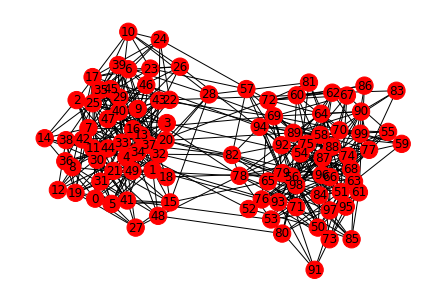

Now running simulation for closure_rate=100


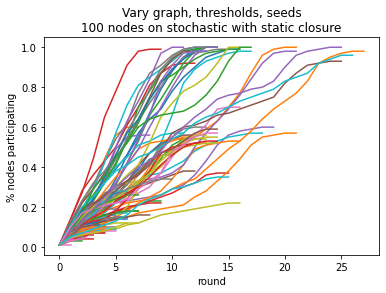

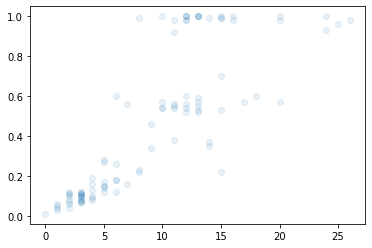

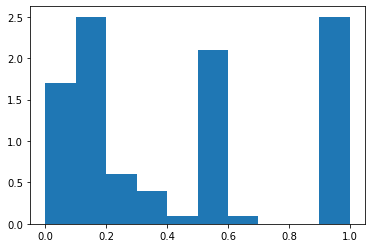

[100]


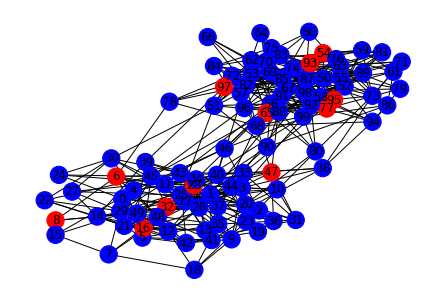

Now running simulation for closure_rate=250


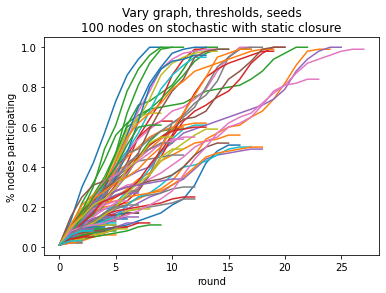

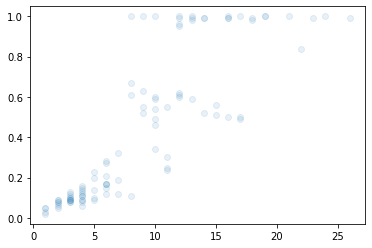

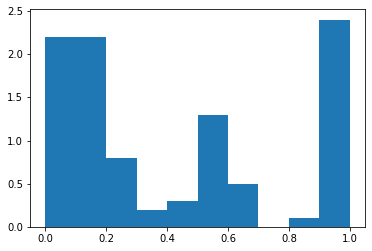

[50, 50]


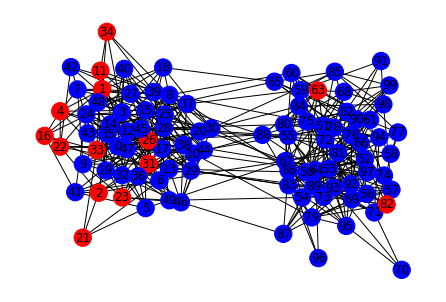

Now running simulation for closure_rate=500


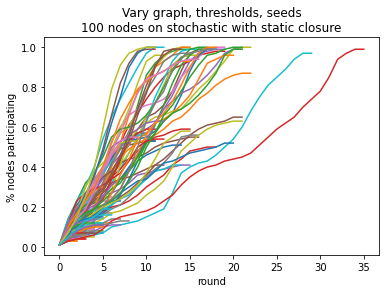

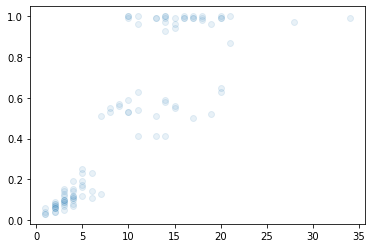

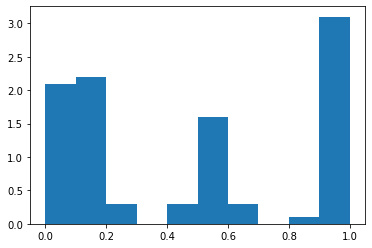

[50, 50]


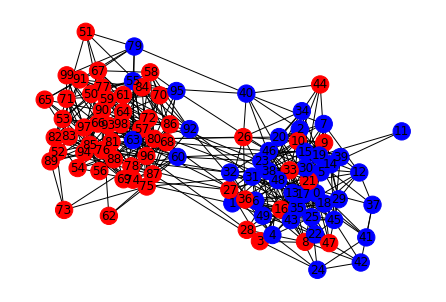

In [18]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
seed_candidates = np.arange(num_nodes)
num_seeds = 1
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][4] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for closure_rate in CLOSURE_RATE_LIST:
    print(f'Now running simulation for closure_rate={closure_rate}')

    # Retrieve output from before
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_1seed_modelmax_closure{closure_rate}.pkl', 'rb')
    )
    
    rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
        sim_log,
        num_experiments, graph_type, num_nodes, graph_params, 
        threshold_mean, threshold_var, seed_candidates, num_seeds, 
        use_network, sticky_cascade, closure_method, closure_rate, 
        max_rounds, save_path=f'e2_communitysbm/sbm_1seed_modelstatic_closure{closure_rate}.pkl', 
        use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
    )

    # print(rounds_filled)
    # print(rounds_frozen)
    # print(max_size_round)

    _ = plt.scatter(
        max_size_round,
        [r[-1] for r in sizes_round],
        alpha=0.1,
    )
    plt.show()

    _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
    plt.show()

    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_1seed_modelstatic_closure{closure_rate}.pkl', 'rb')
    )
    drawn_graph = sim_log[0][3][-1]
    drawn_colors = sim_log[0][4][-1]
    drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
    print(get_community_sizes(drawn_graph))
    nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
    plt.show()

## IDENTICAL AS ABOVE Graph Threshold Seed settings ; Simulating with Closure (Population)

Now running simulation for closure_rate=1


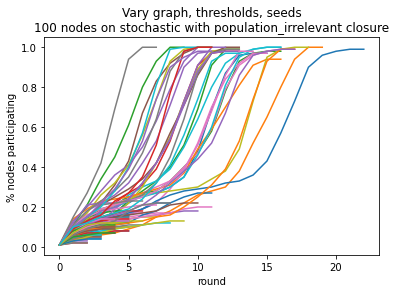

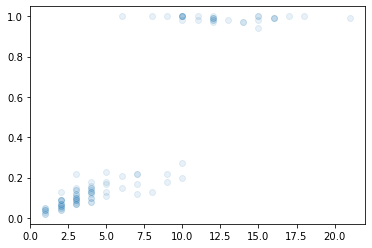

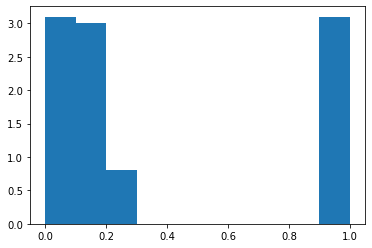

[100]


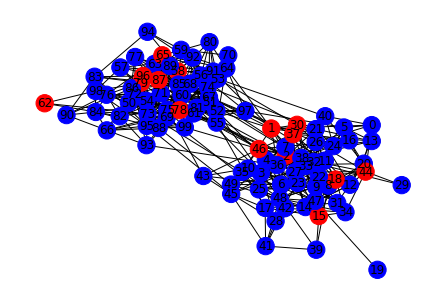

Now running simulation for closure_rate=5


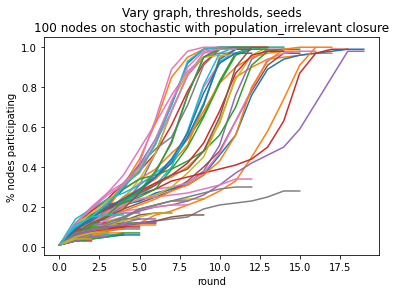

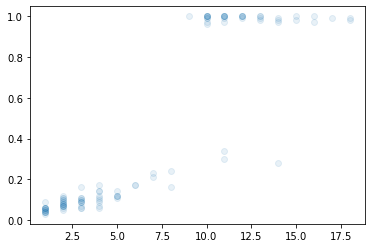

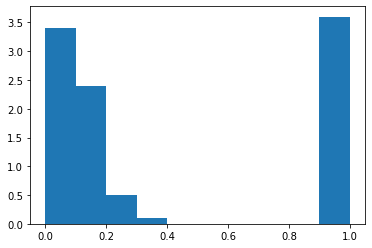

[100]


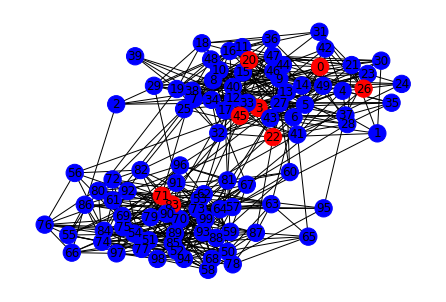

Now running simulation for closure_rate=10


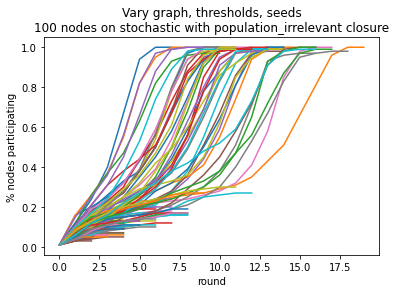

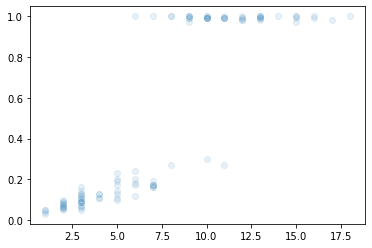

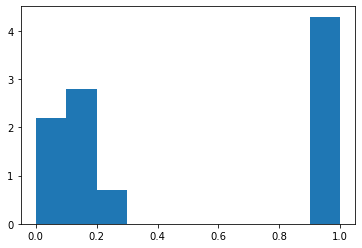

[31, 19, 50]


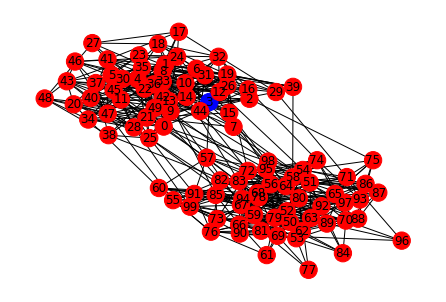

Now running simulation for closure_rate=25


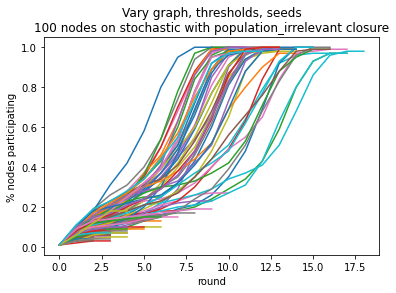

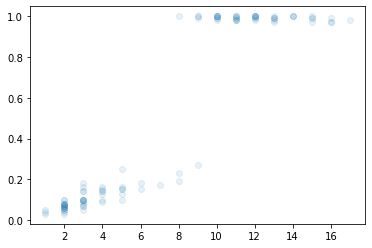

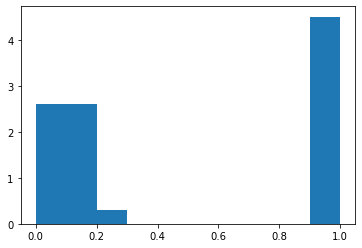

[50, 50]


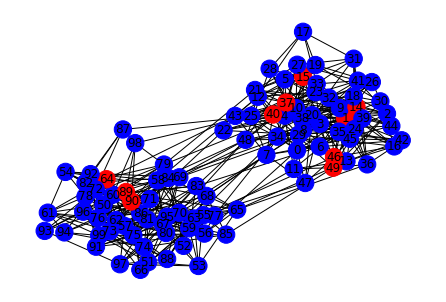

Now running simulation for closure_rate=50


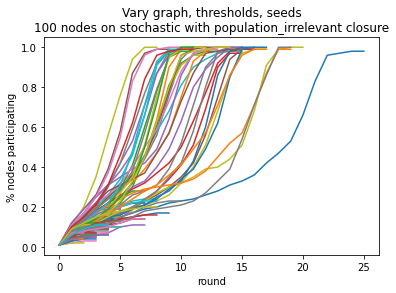

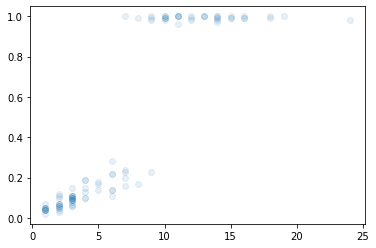

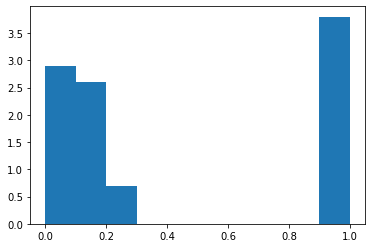

[50, 50]


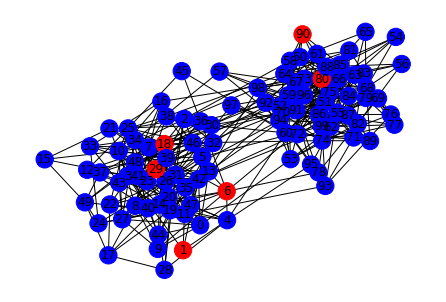

Now running simulation for closure_rate=75


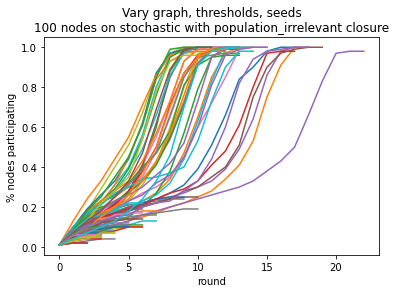

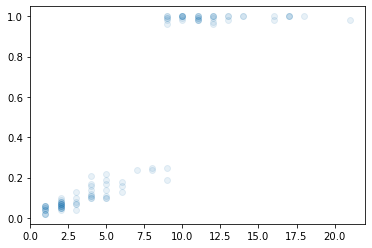

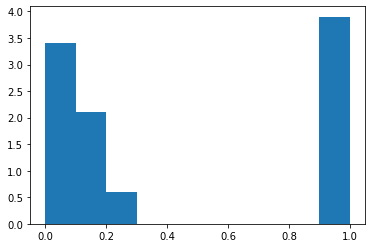

[50, 50]


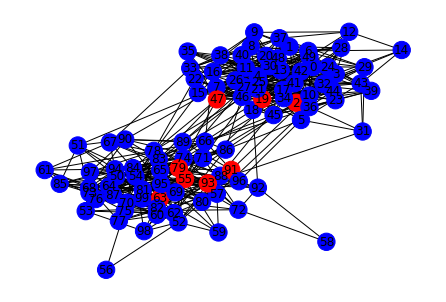

Now running simulation for closure_rate=100


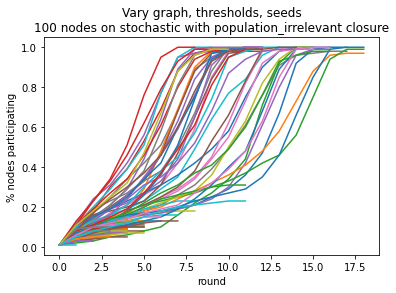

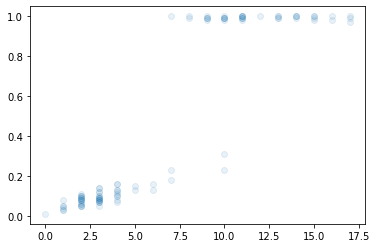

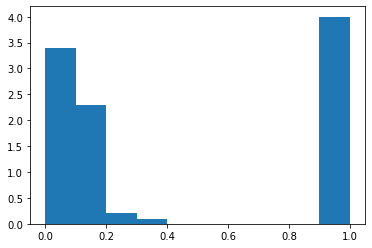

[50, 50]


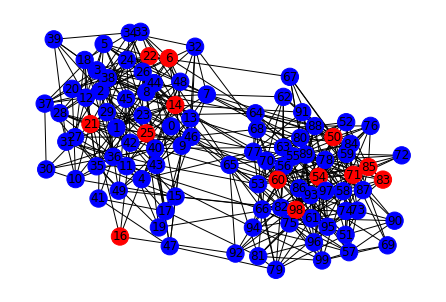

Now running simulation for closure_rate=250


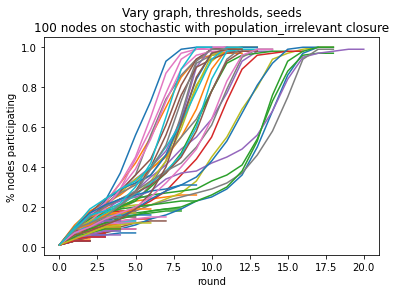

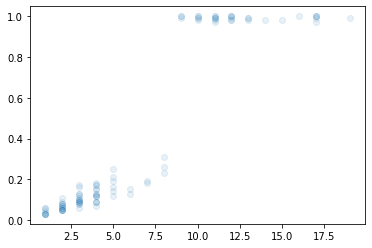

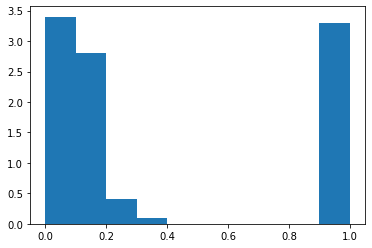

[50, 50]


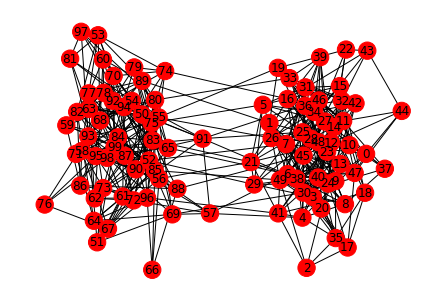

Now running simulation for closure_rate=500


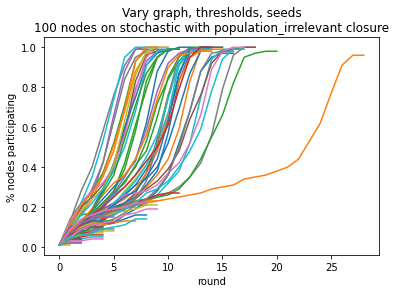

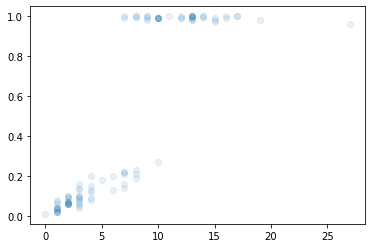

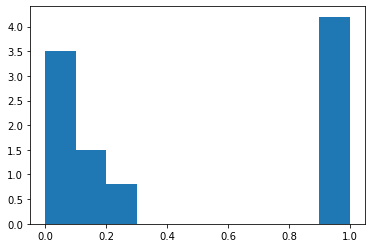

[100]


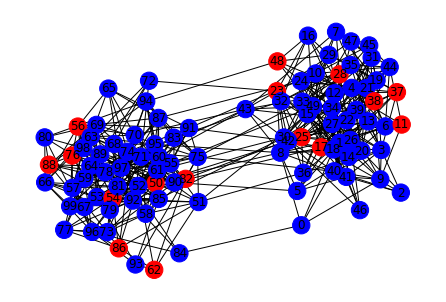

In [19]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
seed_candidates = np.arange(num_nodes)
num_seeds = 1
# Simulation hyperparameters
use_network = False
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][5] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for closure_rate in CLOSURE_RATE_LIST:
    print(f'Now running simulation for closure_rate={closure_rate}')

    # Retrieve output from before
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_1seed_modelmax_closure{closure_rate}.pkl', 'rb')
    )
    
    rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
        sim_log,
        num_experiments, graph_type, num_nodes, graph_params, 
        threshold_mean, threshold_var, seed_candidates, num_seeds, 
        use_network, sticky_cascade, closure_method, closure_rate, 
        max_rounds, save_path=f'e2_communitysbm/sbm_1seed_modelpop_closure{closure_rate}.pkl', 
        use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
    )

    # print(rounds_filled)
    # print(rounds_frozen)
    # print(max_size_round)

    _ = plt.scatter(
        max_size_round,
        [r[-1] for r in sizes_round],
        alpha=0.1,
    )
    plt.show()

    _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
    plt.show()

    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_1seed_modelpop_closure{closure_rate}.pkl', 'rb')
    )
    drawn_graph = sim_log[0][3][-1]
    drawn_colors = sim_log[0][4][-1]
    drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
    print(get_community_sizes(drawn_graph))
    nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
    plt.show()

## IDENTICAL AS ABOVE Graph Threshold Seed settings ; Simulating with Closure (Random)

Now running simulation for closure_rate=1


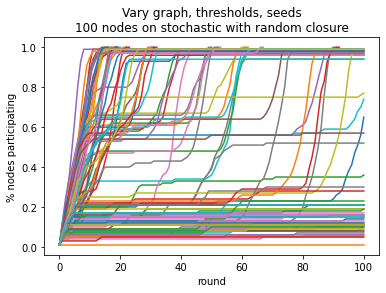

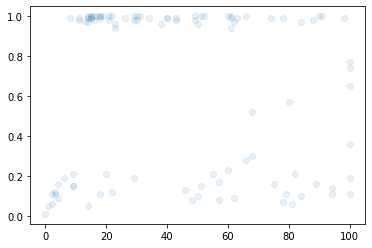

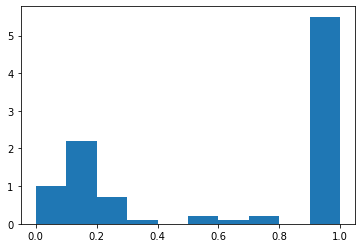

[100]


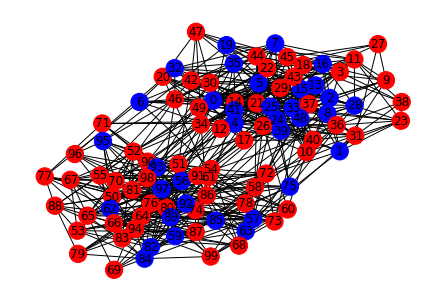

Now running simulation for closure_rate=5


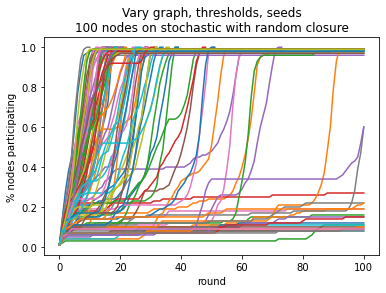

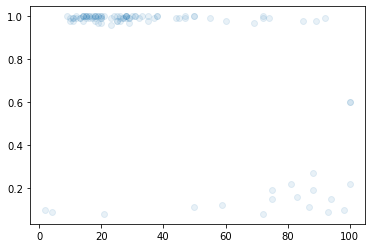

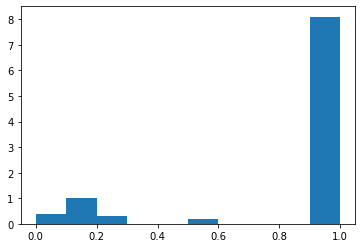

[100]


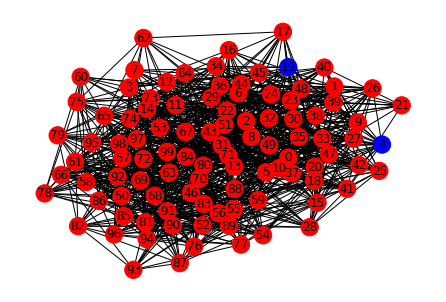

Now running simulation for closure_rate=10


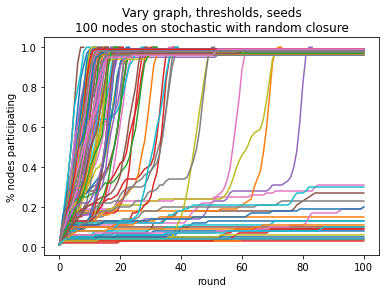

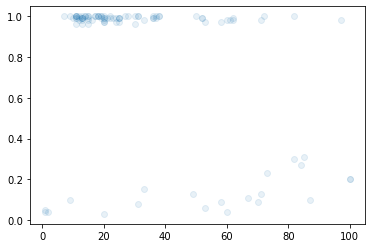

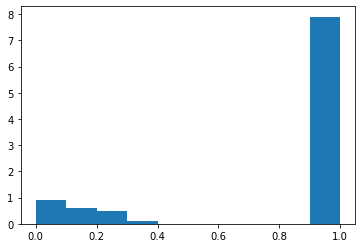

[100]


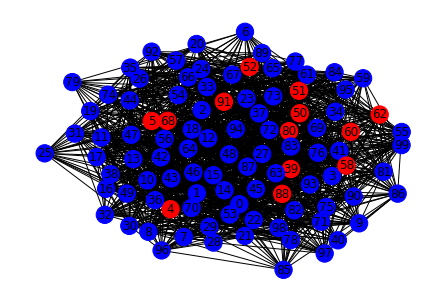

Now running simulation for closure_rate=25


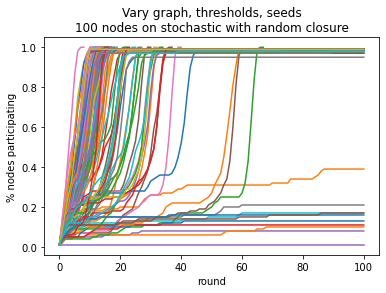

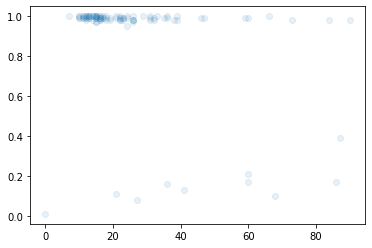

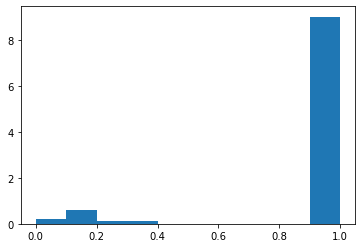

[100]


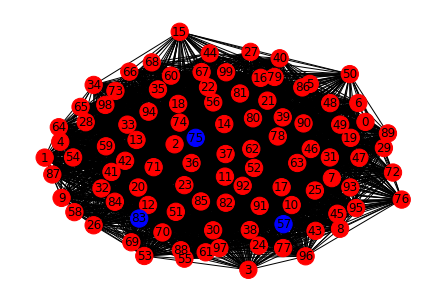

Now running simulation for closure_rate=50


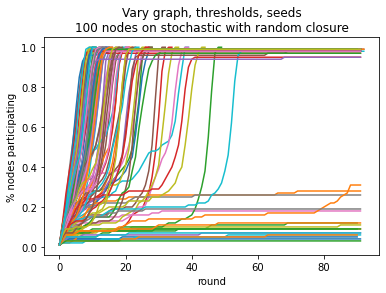

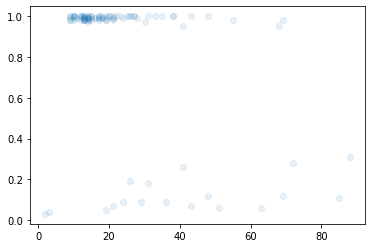

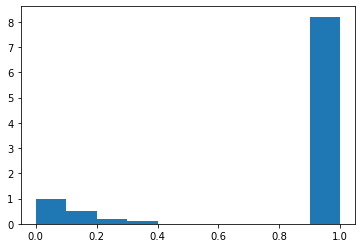

[100]


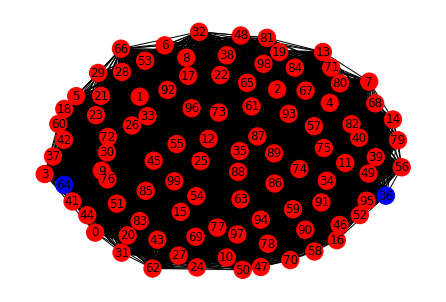

Now running simulation for closure_rate=75


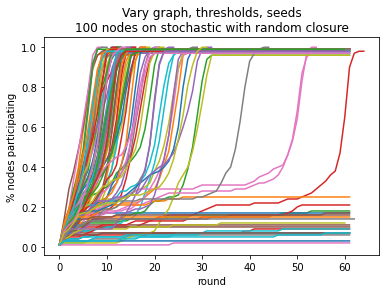

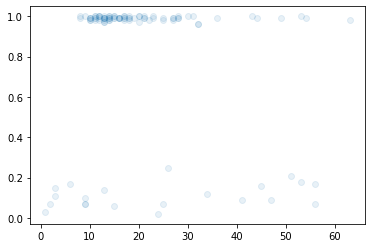

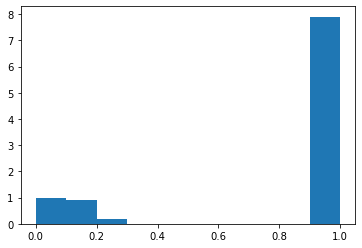

[100]


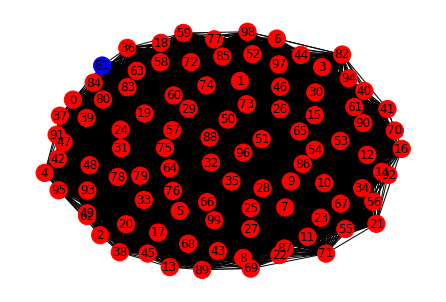

Now running simulation for closure_rate=100


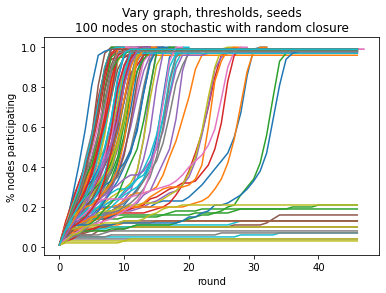

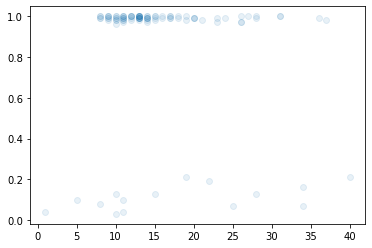

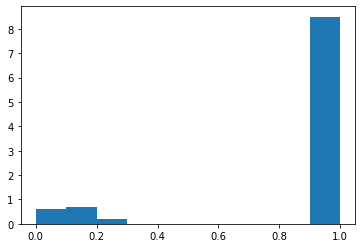

[100]


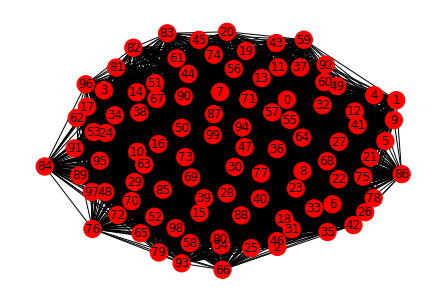

Now running simulation for closure_rate=250


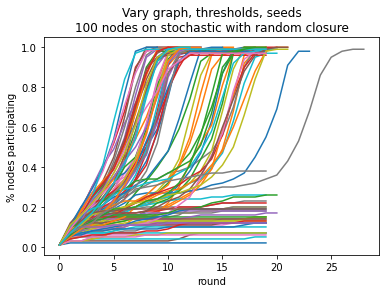

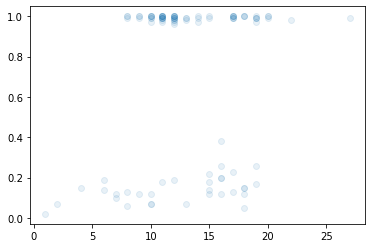

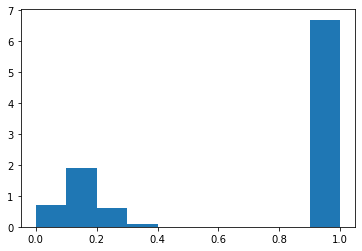

[100]


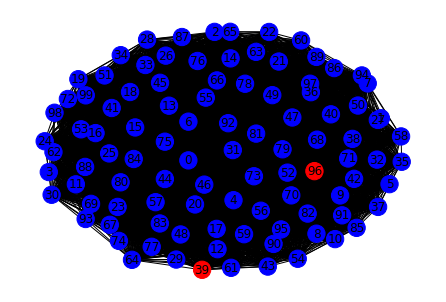

Now running simulation for closure_rate=500


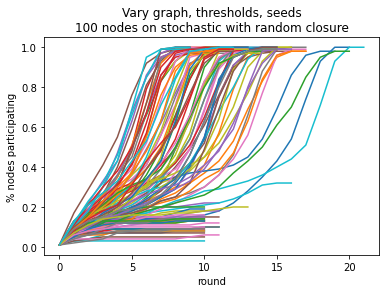

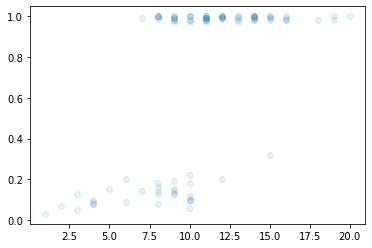

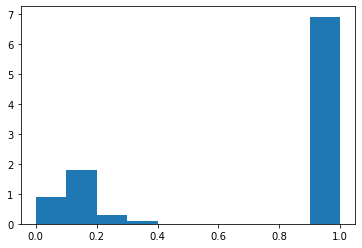

[100]


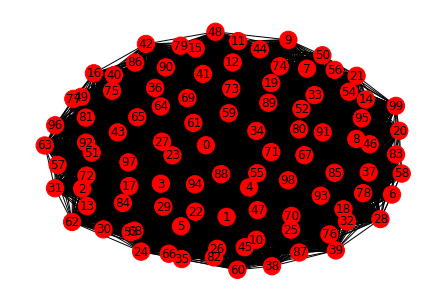

In [20]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
seed_candidates = np.arange(num_nodes)
num_seeds = 1
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][3] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for closure_rate in CLOSURE_RATE_LIST:
    print(f'Now running simulation for closure_rate={closure_rate}')

    # Retrieve output from before
    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_1seed_modelmax_closure{closure_rate}.pkl', 'rb')
    )
    
    rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
        sim_log,
        num_experiments, graph_type, num_nodes, graph_params, 
        threshold_mean, threshold_var, seed_candidates, num_seeds, 
        use_network, sticky_cascade, closure_method, closure_rate, 
        max_rounds, save_path=f'e2_communitysbm/sbm_1seed_modelrandom_closure{closure_rate}.pkl', 
        use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
    )

    # print(rounds_filled)
    # print(rounds_frozen)
    # print(max_size_round)

    _ = plt.scatter(
        max_size_round,
        [r[-1] for r in sizes_round],
        alpha=0.1,
    )
    plt.show()

    _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
    plt.show()

    (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
        open(f'e2_communitysbm/sbm_1seed_modelrandom_closure{closure_rate}.pkl', 'rb')
    )
    drawn_graph = sim_log[0][3][-1]
    drawn_colors = sim_log[0][4][-1]
    drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
    print(get_community_sizes(drawn_graph))
    nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
    plt.show()

# Compare 2-same-team "joined" seed selection vs 1-vs-1 seed "forked" selection policies 

## Graph (100 nodes 0.19 wp 0.01 bp) Threshold (0.4 mean 0.25 var) Seed (2 joined vs forked) Closure (Max X) ; X in (1, 5, 10, 25, 50, 75, 100, 250, 500)

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=1


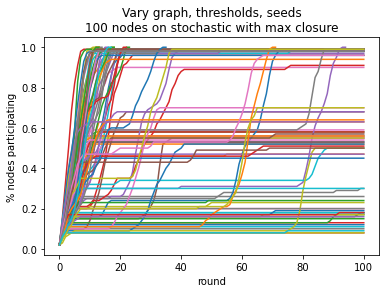

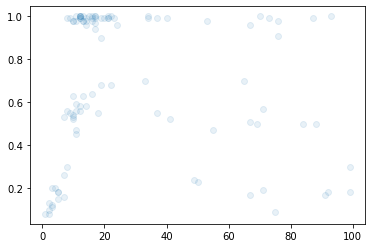

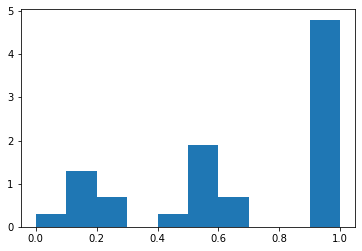

[50, 50]


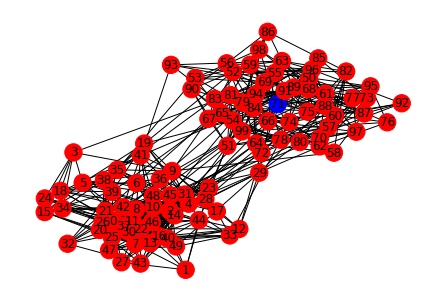

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=5


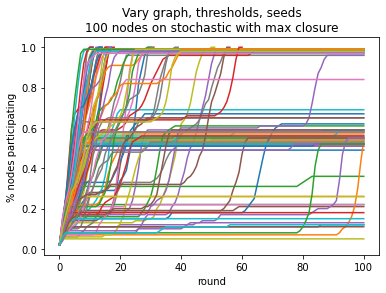

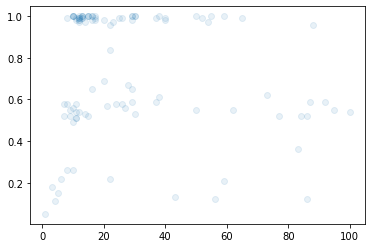

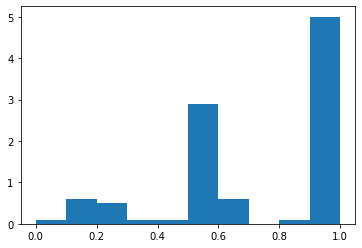

[50, 50]


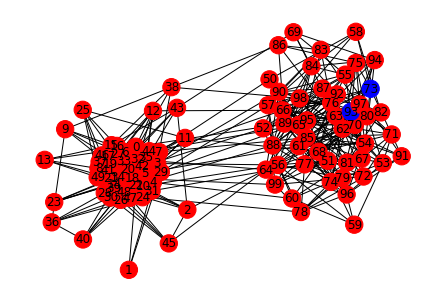

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=10


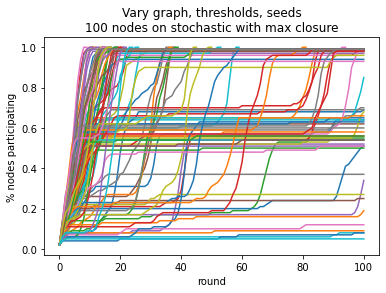

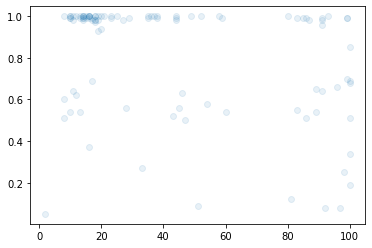

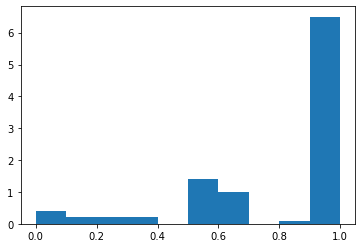

[50, 50]


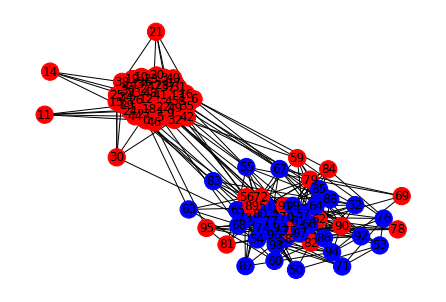

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=25


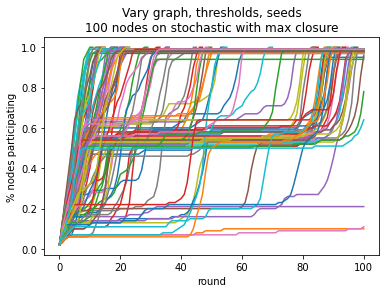

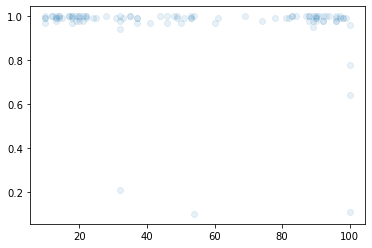

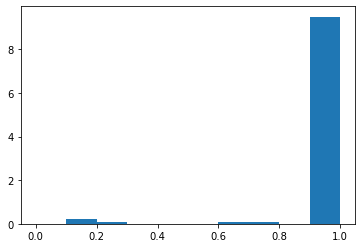

[100]


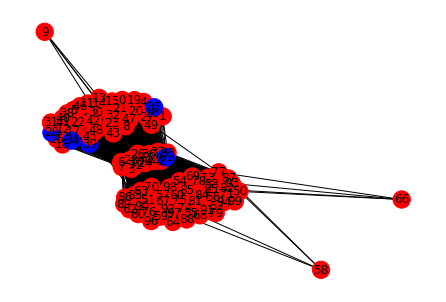

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=50


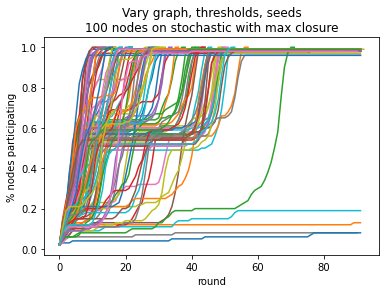

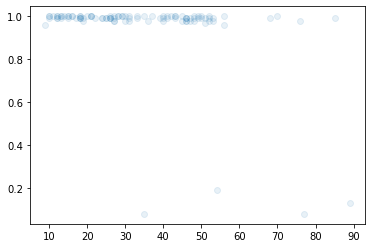

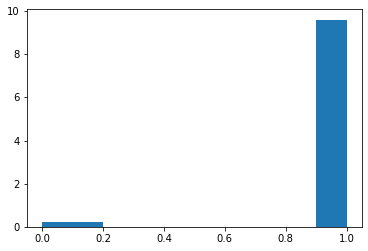

[100]


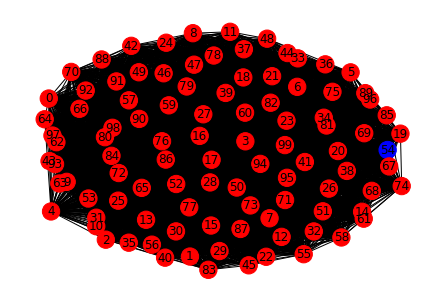

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=75


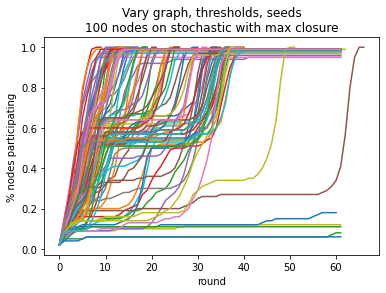

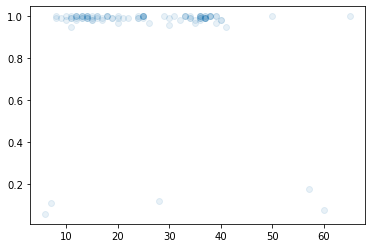

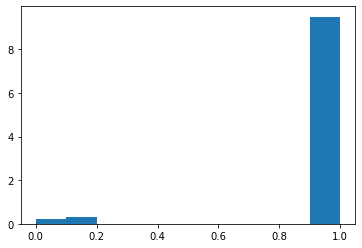

[50, 50]


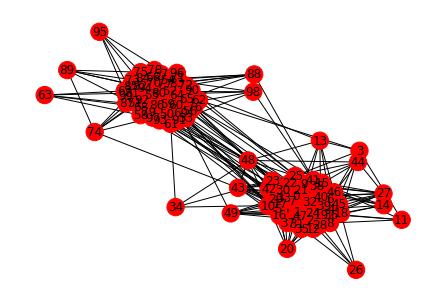

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=100


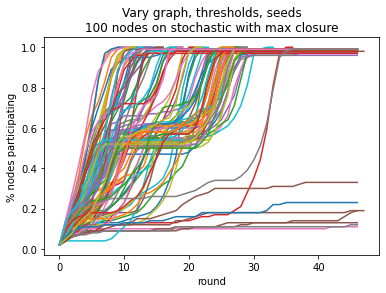

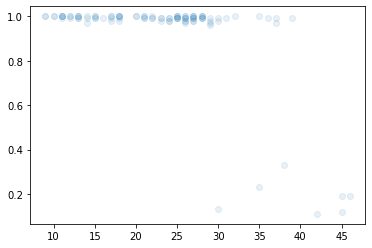

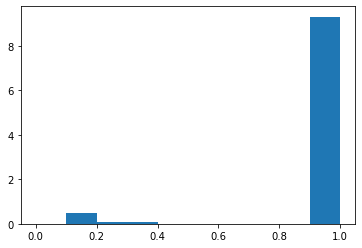

[100]


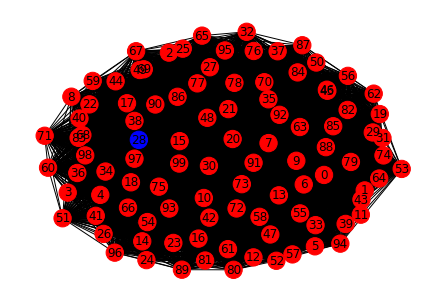

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=250


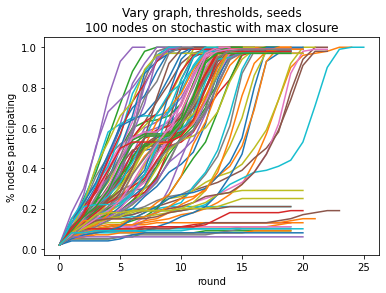

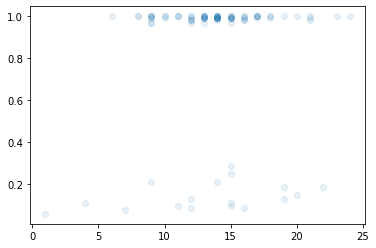

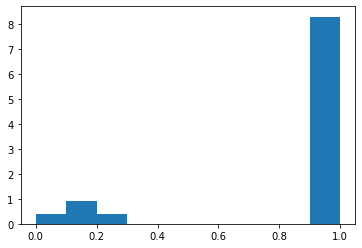

[100]


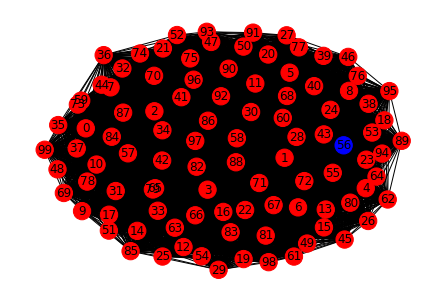

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=500


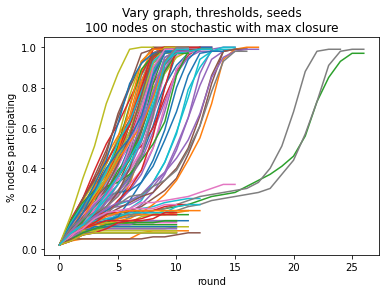

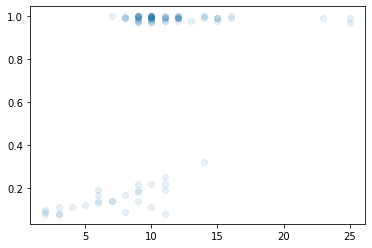

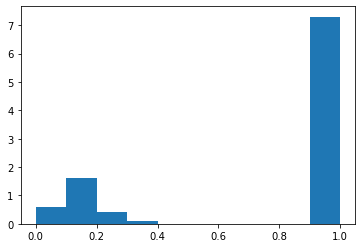

[100]


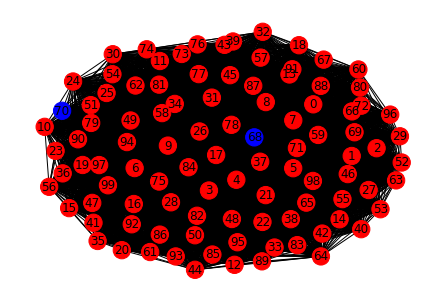

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=1


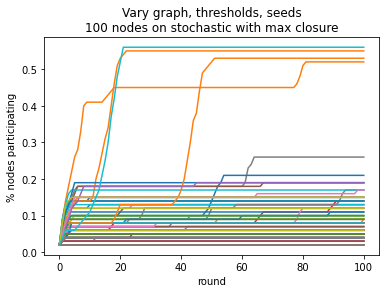

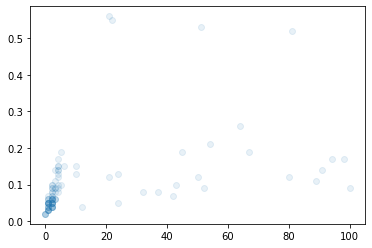

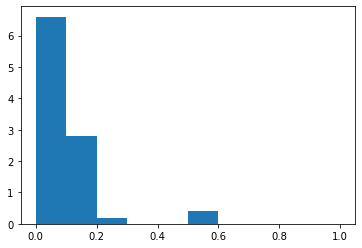

[50, 50]


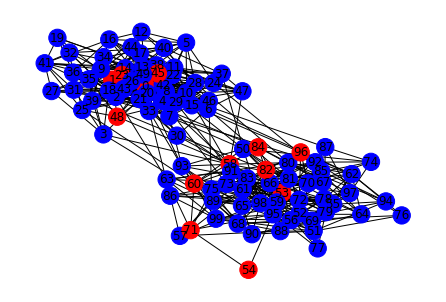

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=5


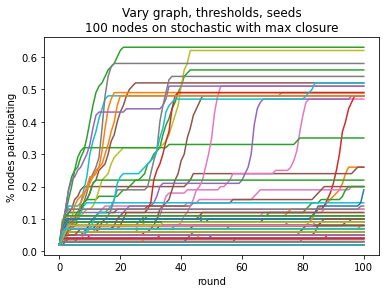

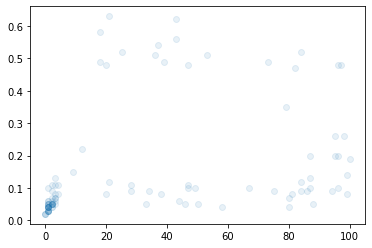

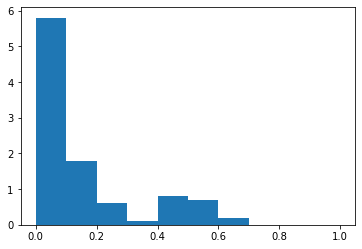

[50, 50]


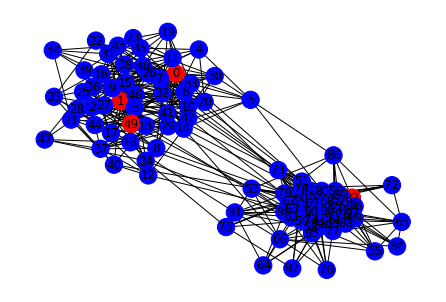

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=10


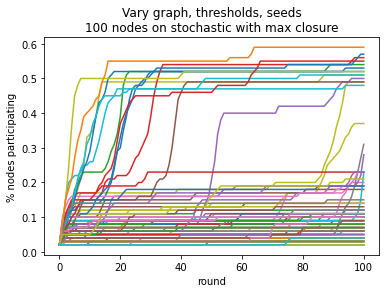

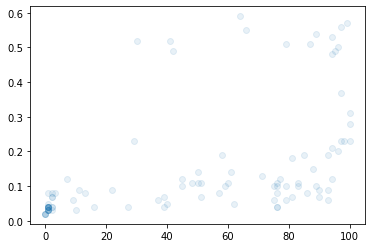

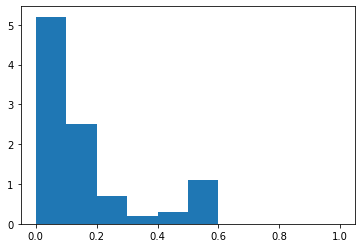

[50, 50]


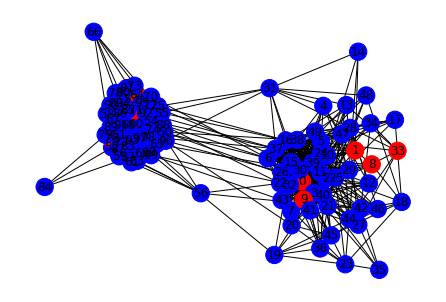

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=25


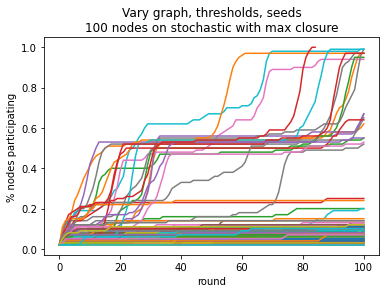

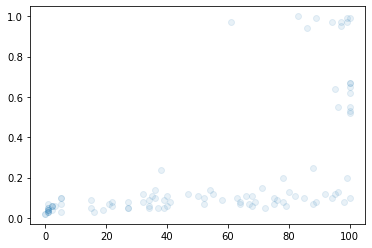

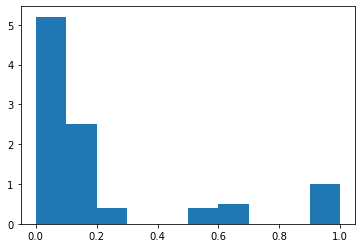

[100]


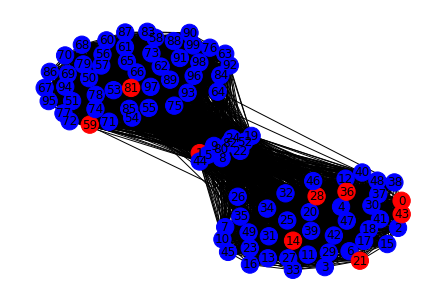

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=50


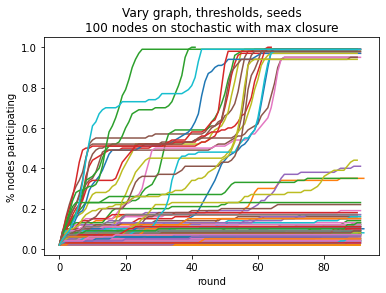

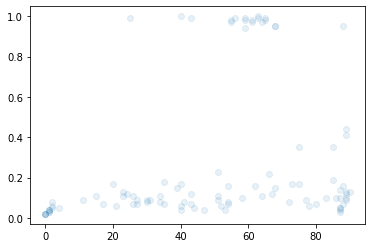

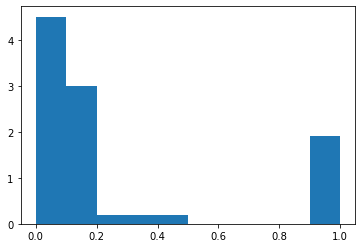

[100]


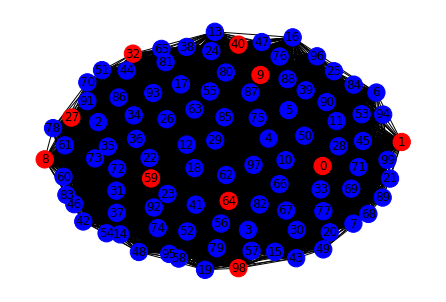

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=75


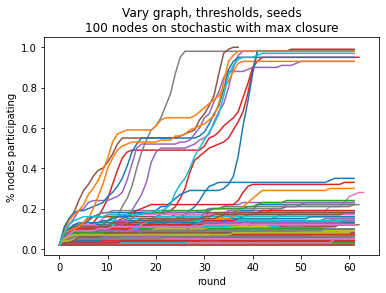

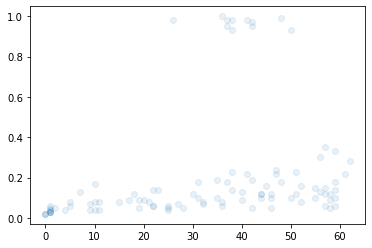

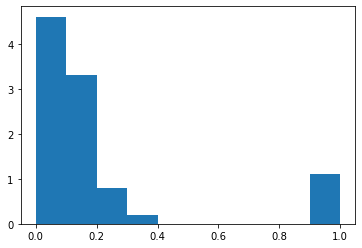

[100]


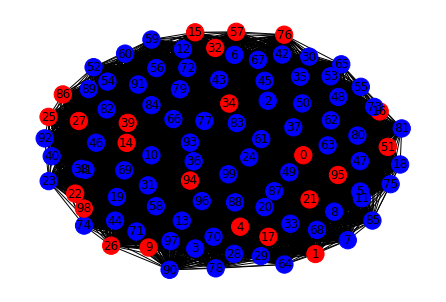

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=100


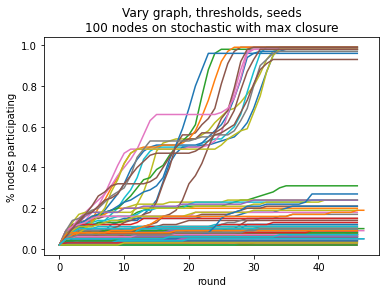

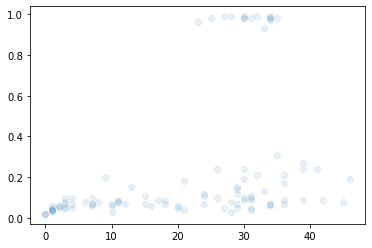

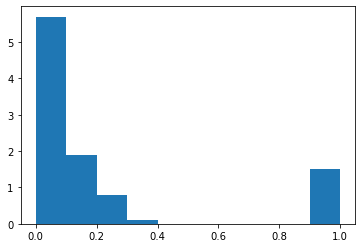

[100]


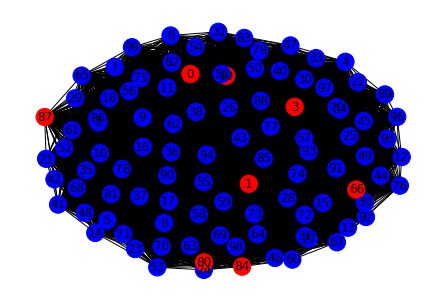

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=250


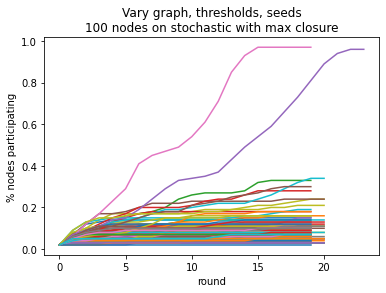

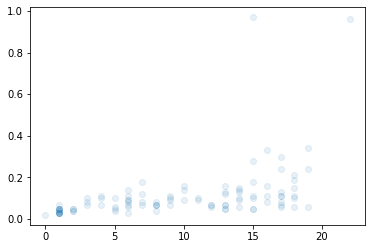

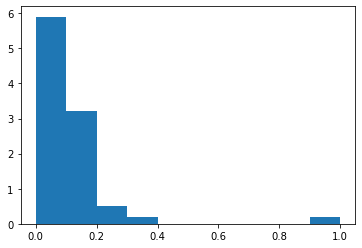

[100]


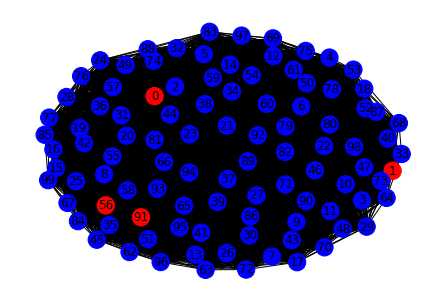

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=500


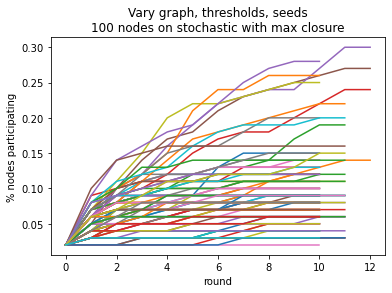

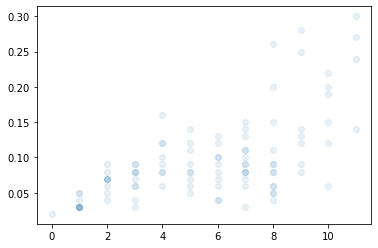

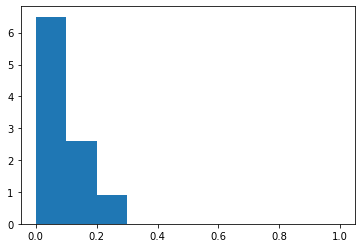

[100]


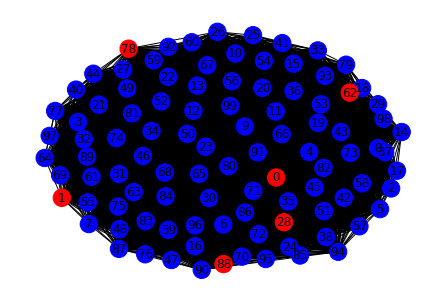

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=1


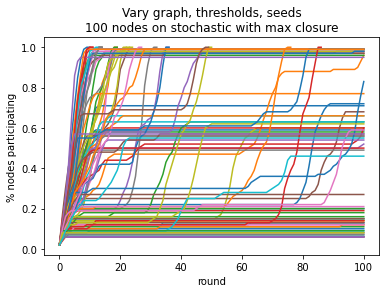

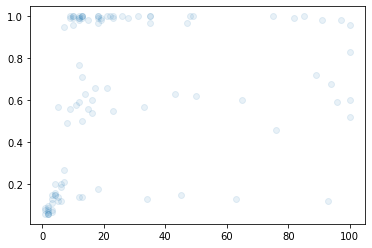

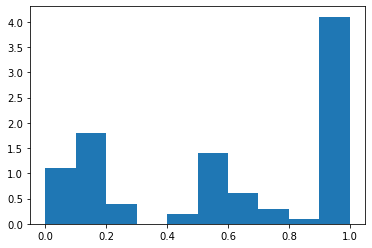

[50, 50]


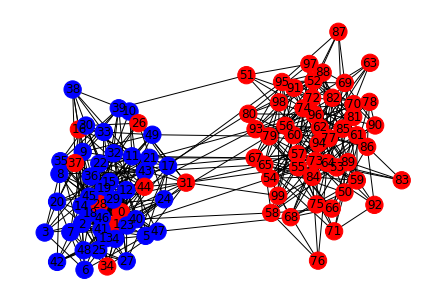

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=5


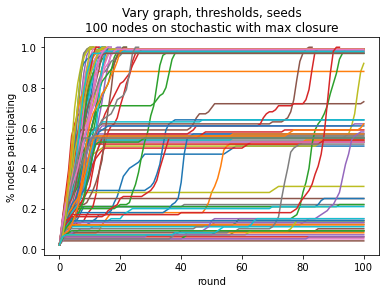

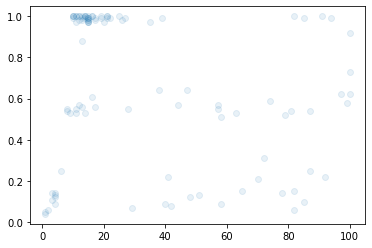

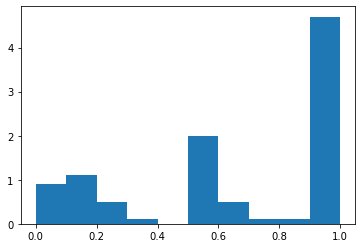

[100]


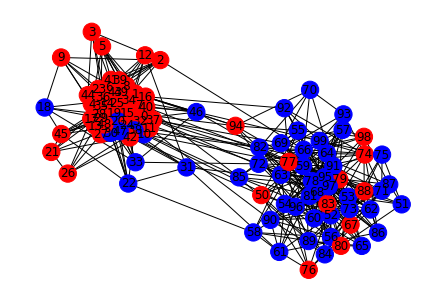

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=10


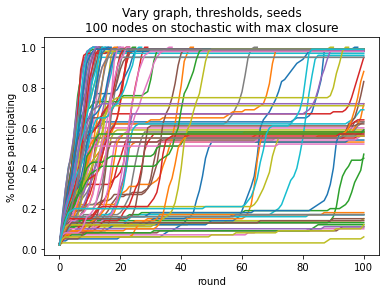

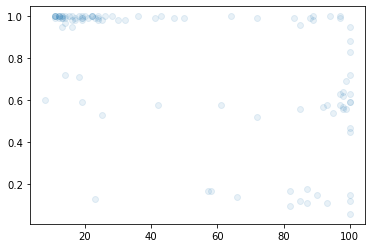

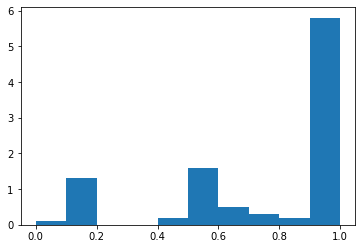

[50, 50]


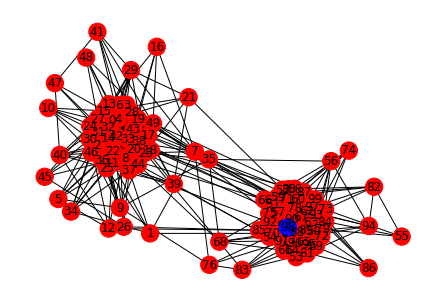

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=25


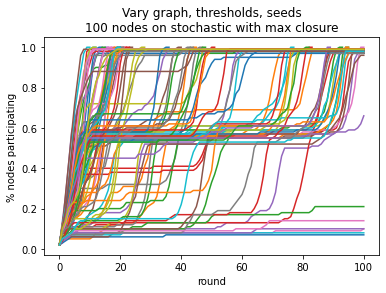

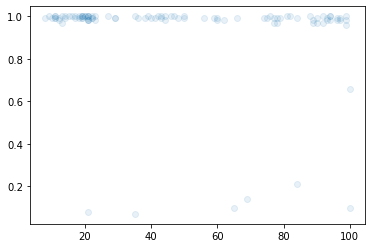

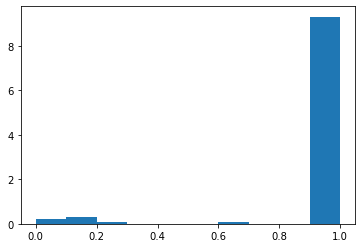

[50, 50]


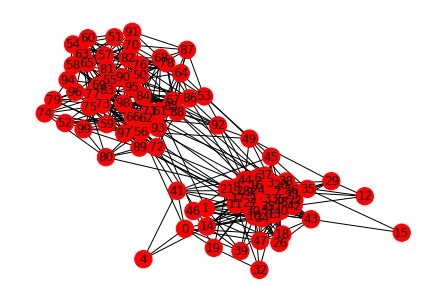

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=50


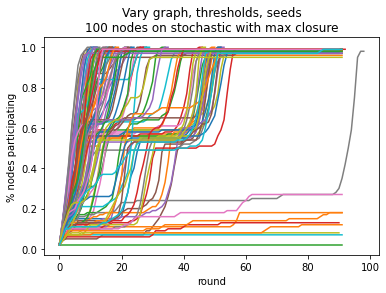

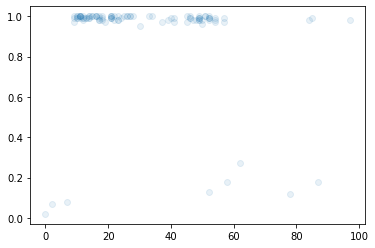

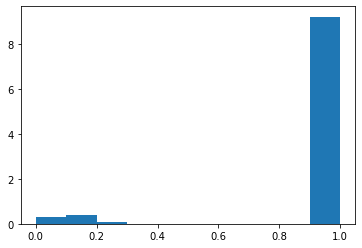

[100]


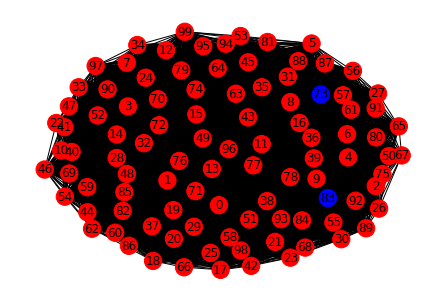

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=75


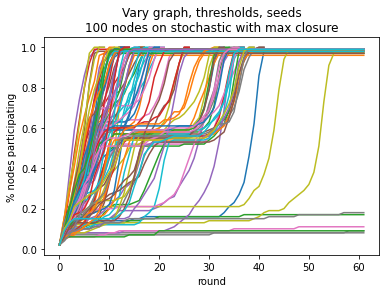

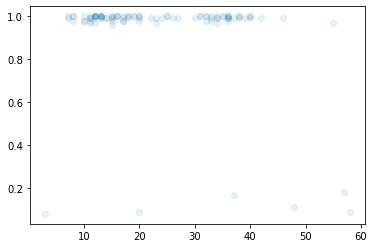

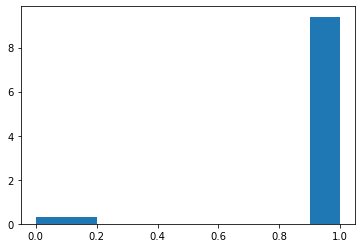

[100]


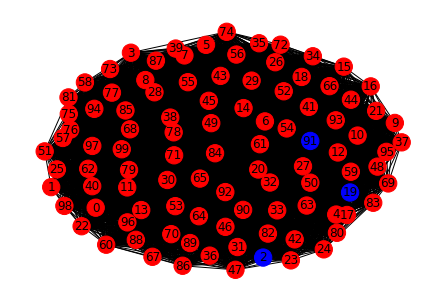

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=100


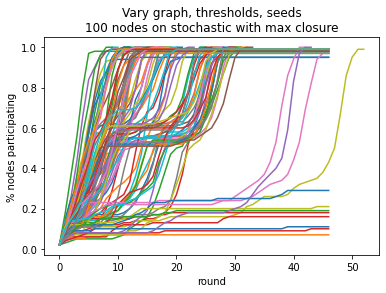

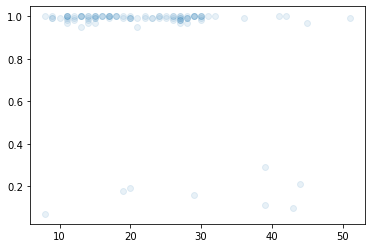

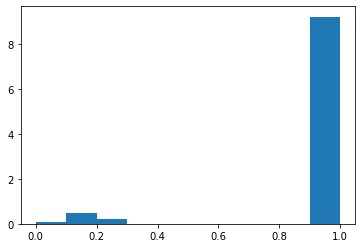

[100]


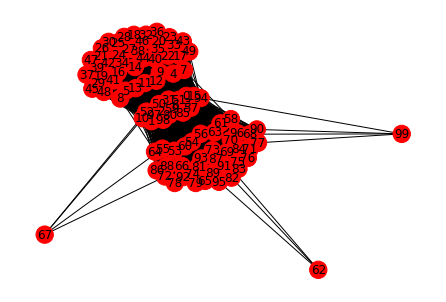

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=250


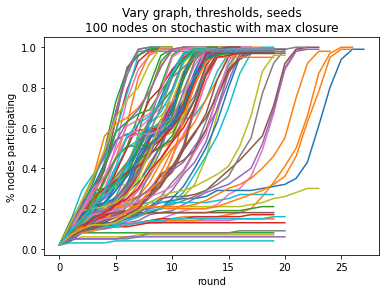

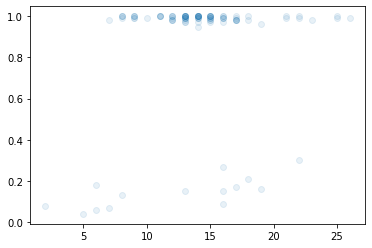

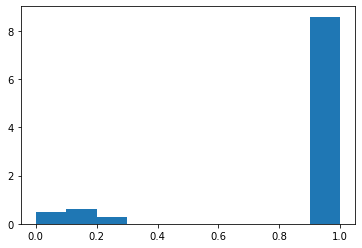

[100]


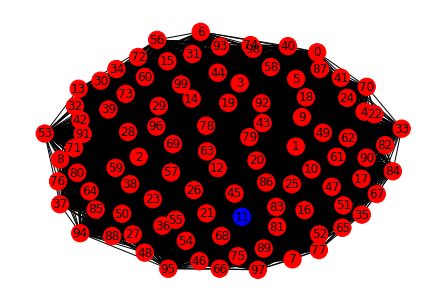

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=500


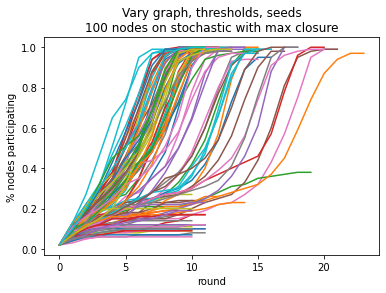

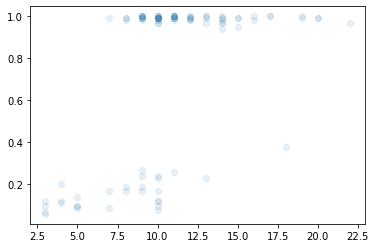

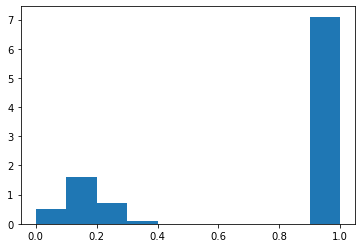

[100]


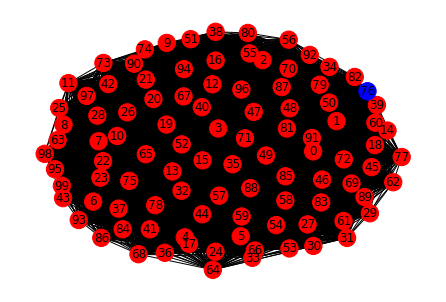

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=1


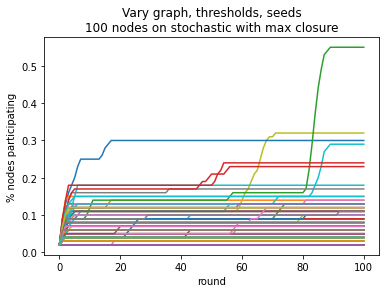

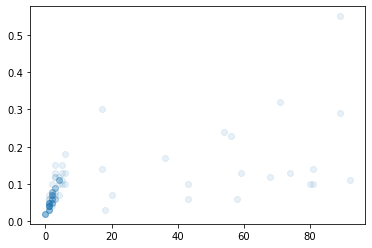

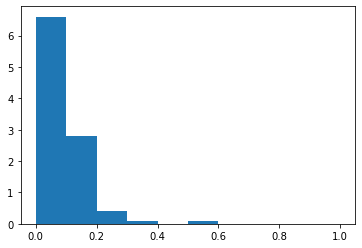

[100]


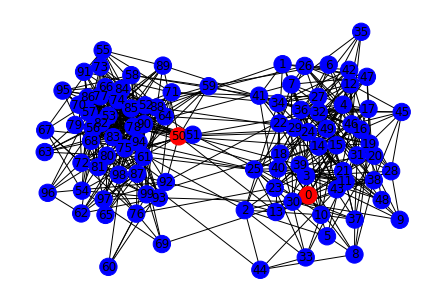

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=5


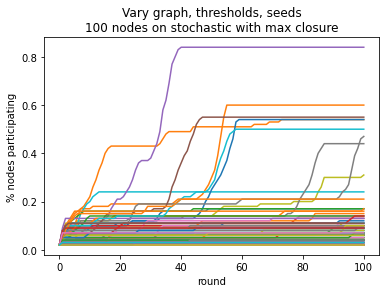

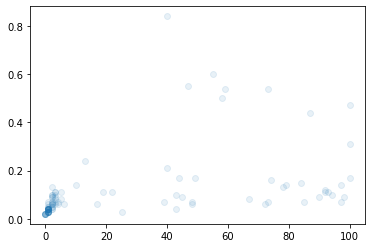

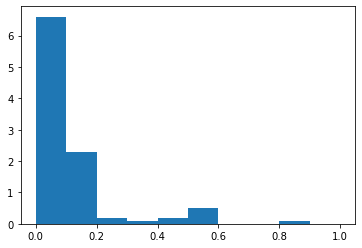

[50, 50]


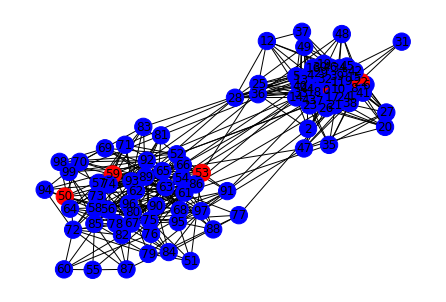

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=10


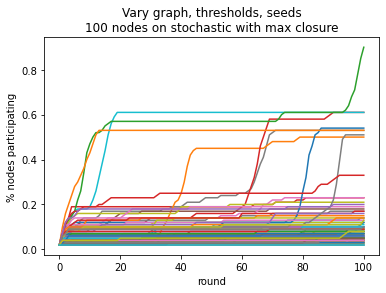

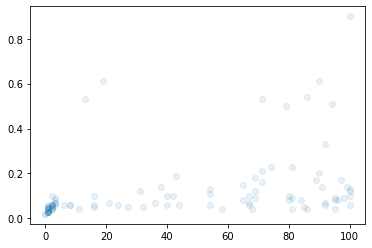

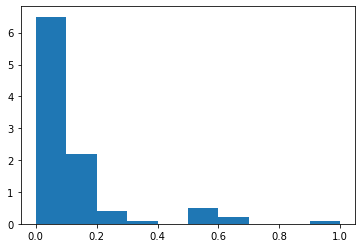

[50, 50]


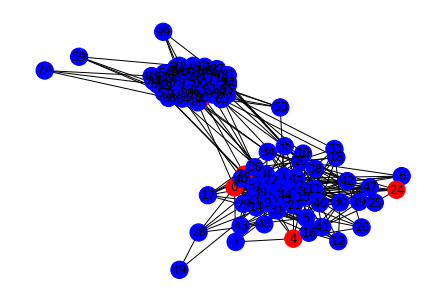

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=25


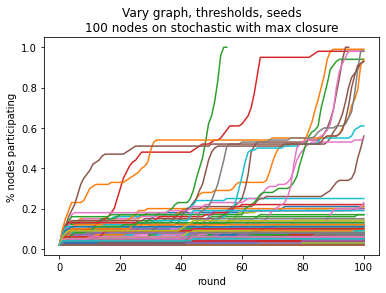

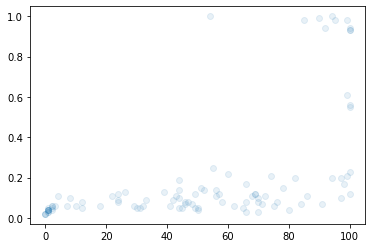

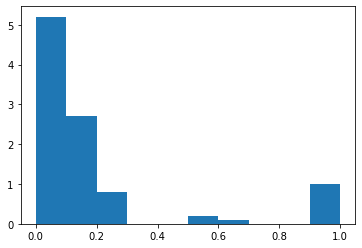

[100]


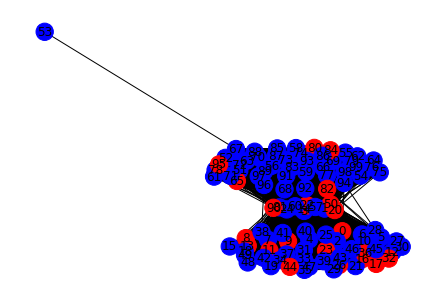

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=50


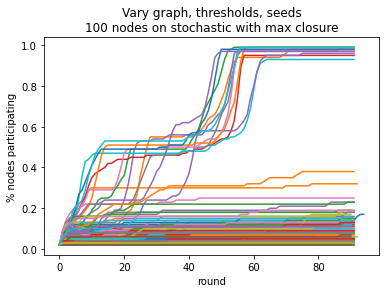

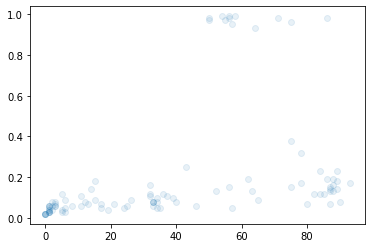

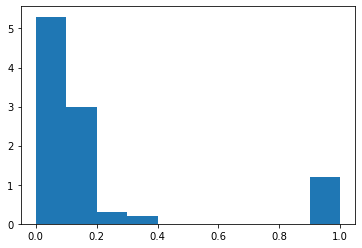

[100]


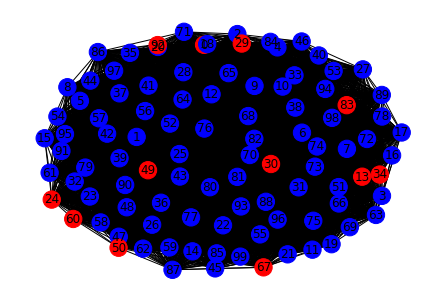

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=75


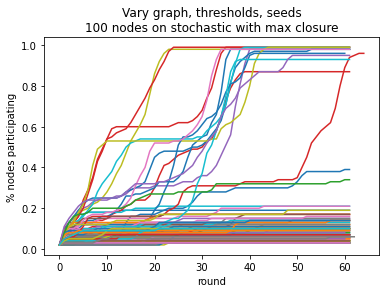

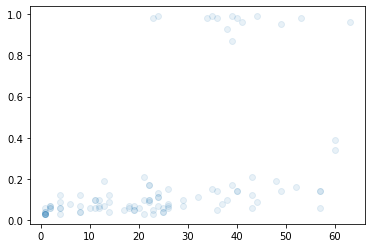

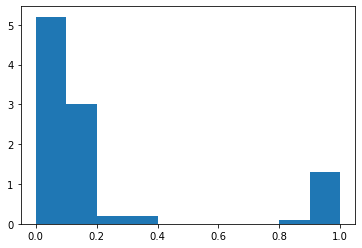

[100]


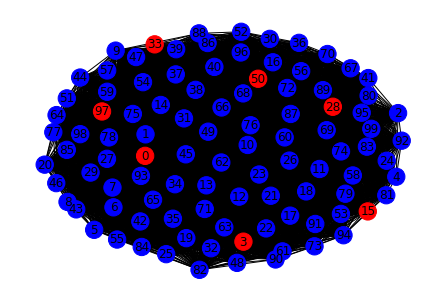

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=100


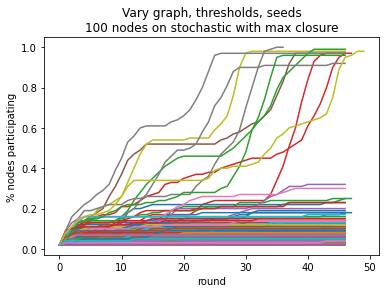

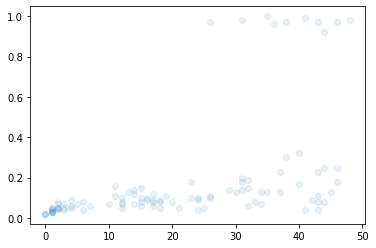

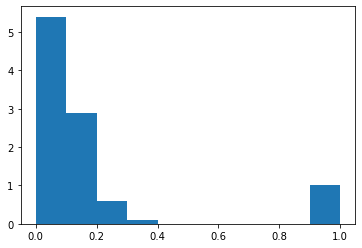

[100]


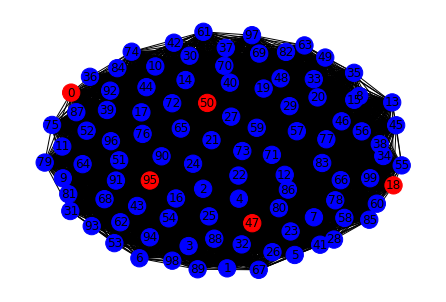

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=250


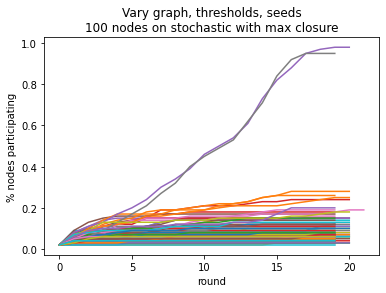

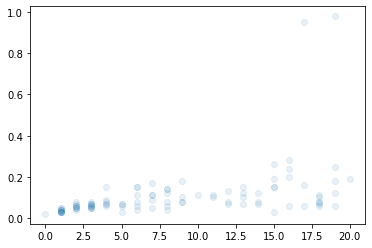

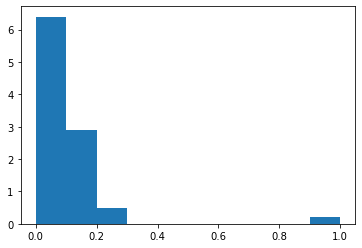

[100]


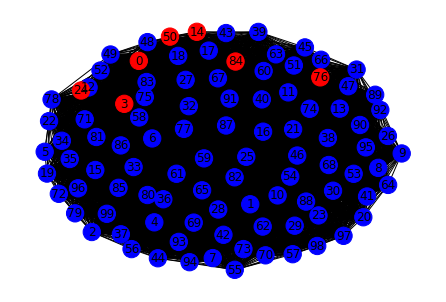

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=500


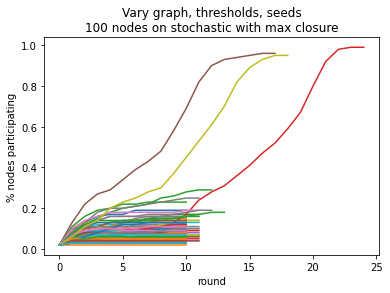

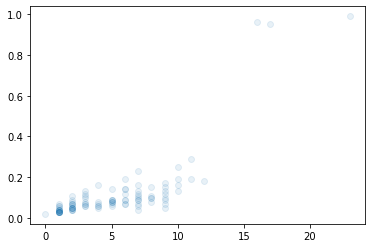

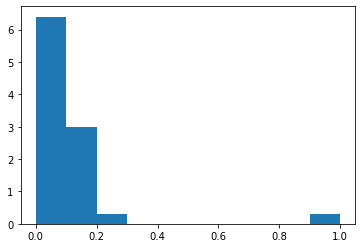

[100]


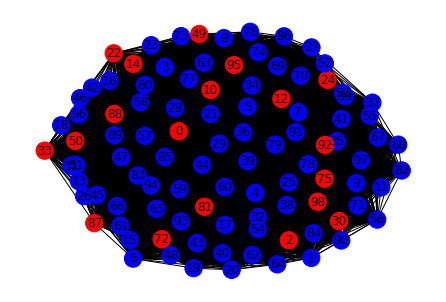

In [5]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
THRESHOLD_MEAN_LIST = [0.4, 0.5] # threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
SEED_CANDIDATES_DICT = {
    'joined': [0,1], # can define without loss of generality
    'forked': [0,50],
}
num_seeds = 2
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][0] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for seed_candidate_type in SEED_CANDIDATES_DICT:
    seed_candidates = SEED_CANDIDATES_DICT[seed_candidate_type]
    for threshold_mean in THRESHOLD_MEAN_LIST:
        for closure_rate in CLOSURE_RATE_LIST:
            print(f'Now running simulation for seed_candidates={seed_candidates} threshold={threshold_mean} closure_rate={closure_rate}')

            # Retrieve output from before
            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = (None, None, None, None, None)

            rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
                sim_log,
                num_experiments, graph_type, num_nodes, graph_params, 
                threshold_mean, threshold_var, seed_candidates, num_seeds, 
                use_network, sticky_cascade, closure_method, closure_rate, 
                max_rounds, save_path=f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelmax_thres{threshold_mean}clos{closure_rate}.pkl', 
                use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
            )

            # print(rounds_filled)
            # print(rounds_frozen)
            # print(max_size_round)

            _ = plt.scatter(
                max_size_round,
                [r[-1] for r in sizes_round],
                alpha=0.1,
            )
            plt.show()

            _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
            plt.show()

            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
                open(f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelmax_thres{threshold_mean}clos{closure_rate}.pkl', 'rb')
            )
            drawn_graph = sim_log[0][3][-1]
            drawn_colors = sim_log[0][4][-1]
            drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
            print(get_community_sizes(drawn_graph))
            nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
            plt.show()

## IDENTICAL AS ABOVE Graph Threshold Seed settings ; Simulating with Closure (Static)

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=1


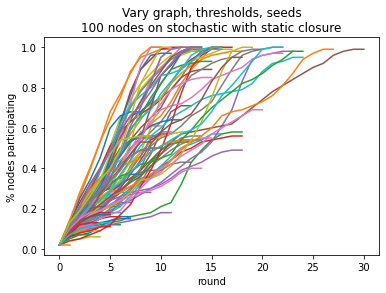

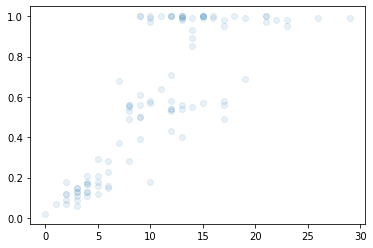

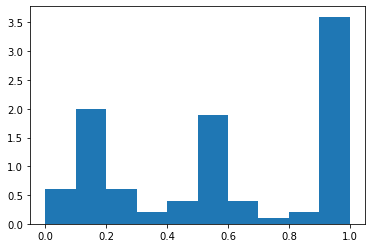

[50, 50]


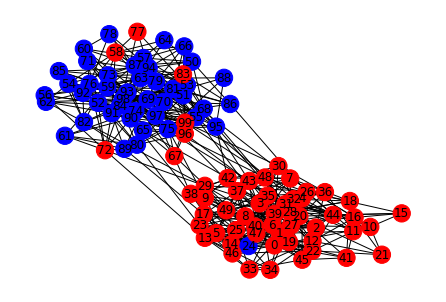

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=5


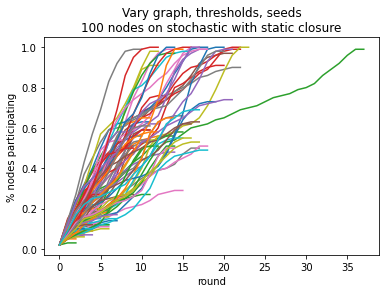

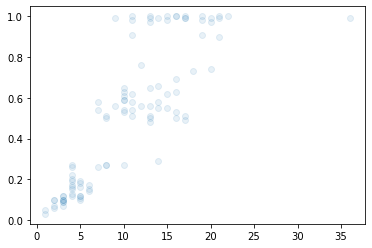

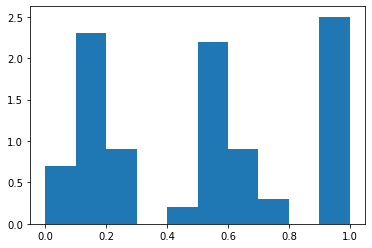

[50, 50]


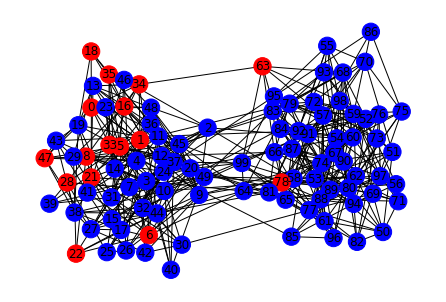

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=10


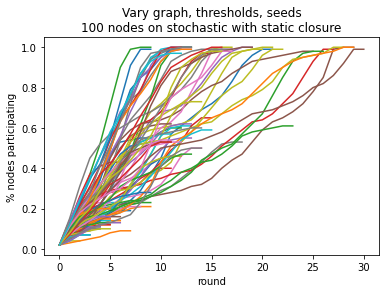

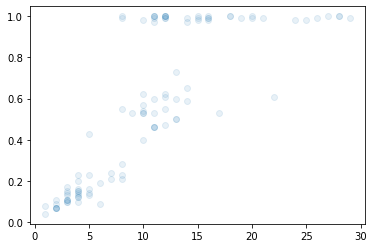

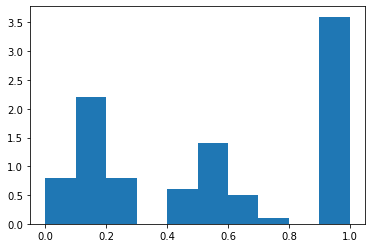

[50, 50]


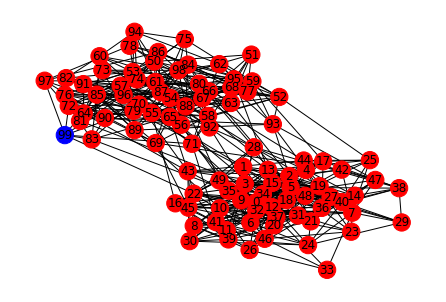

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=25


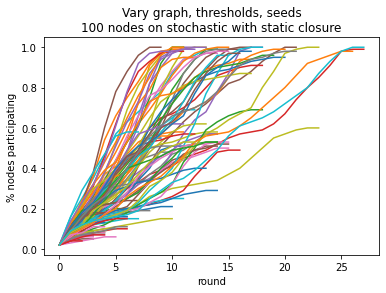

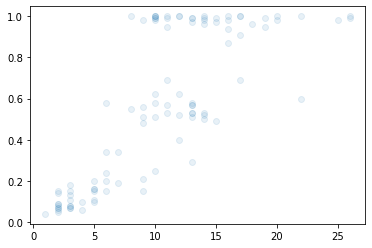

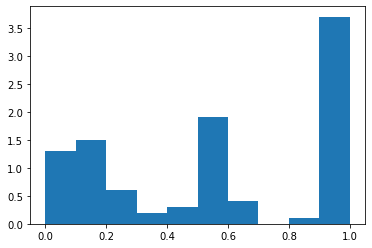

[50, 50]


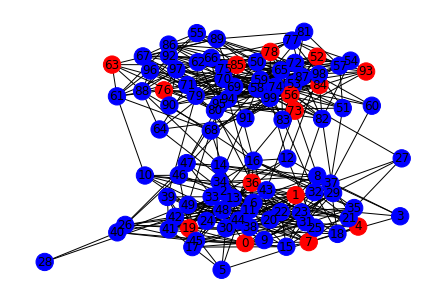

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=50


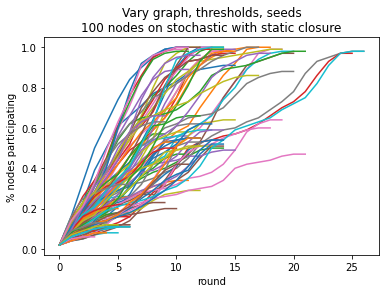

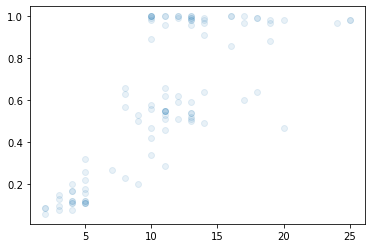

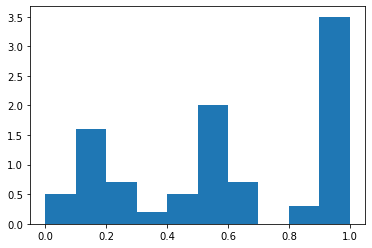

[50, 50]


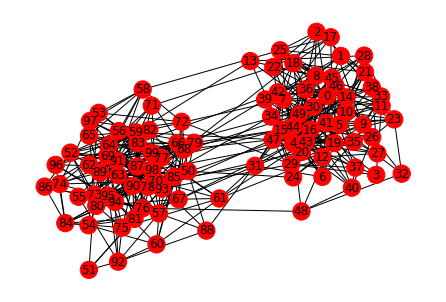

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=75


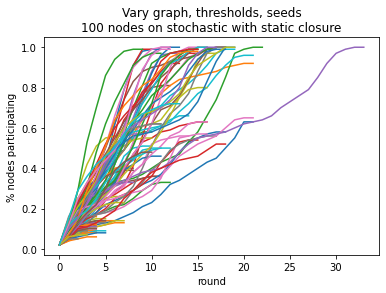

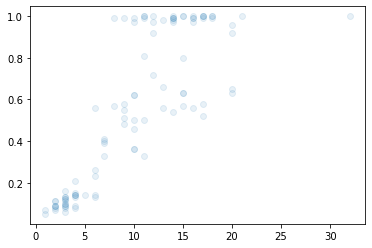

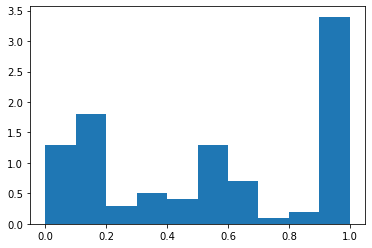

[50, 50]


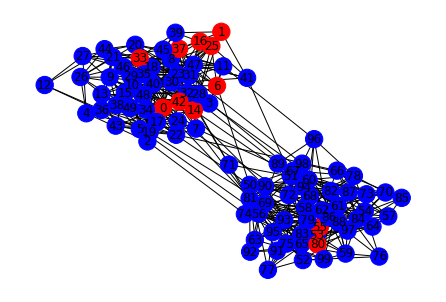

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=100


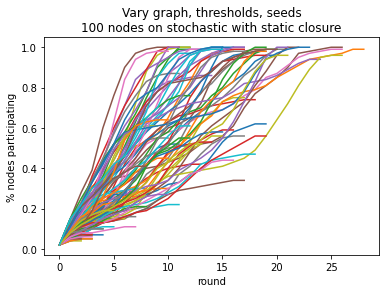

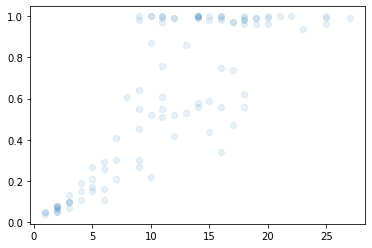

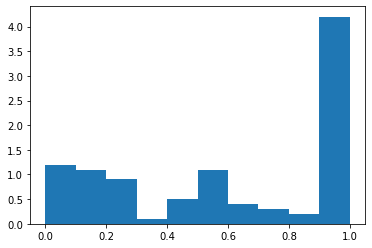

[50, 50]


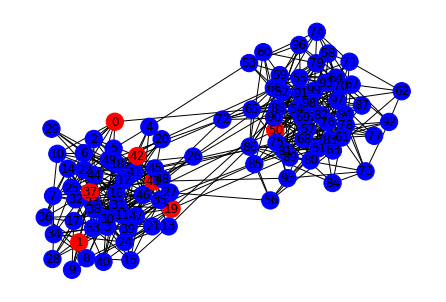

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=250


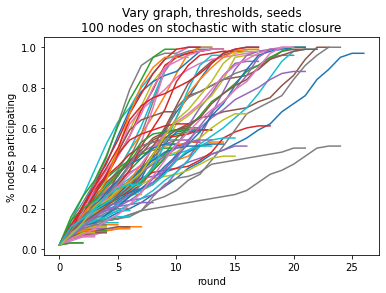

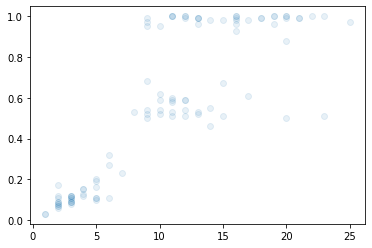

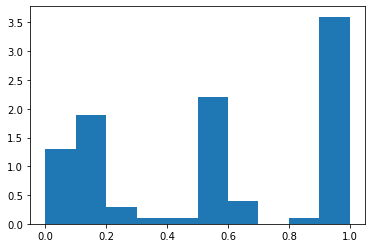

[50, 50]


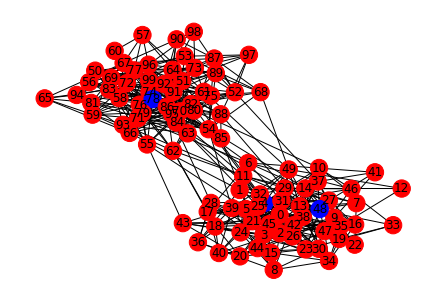

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=500


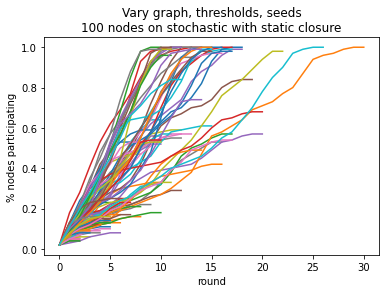

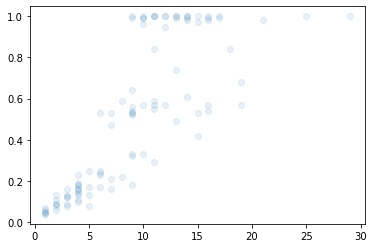

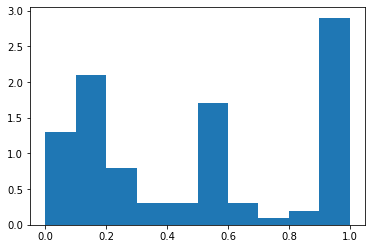

[50, 50]


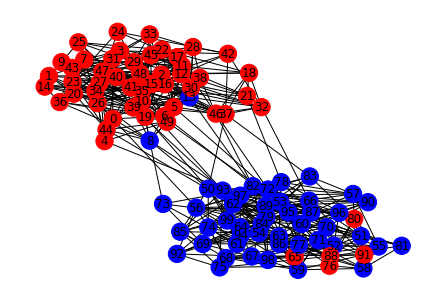

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=1


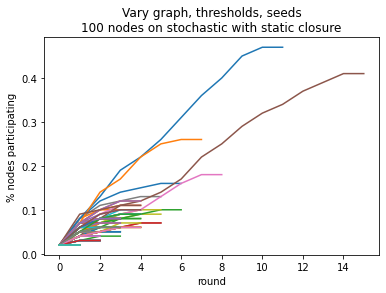

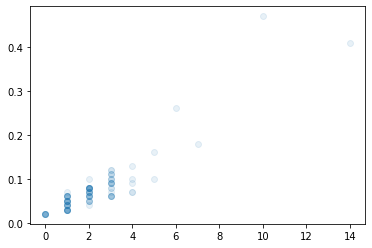

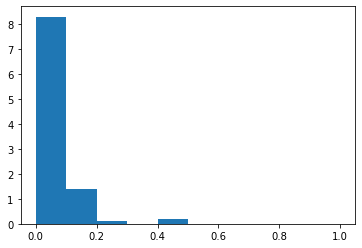

[50, 50]


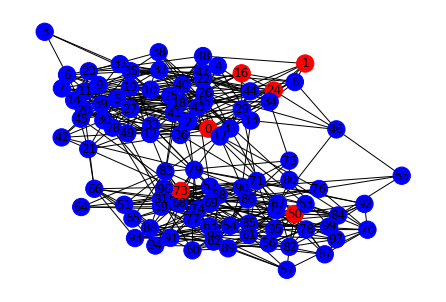

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=5


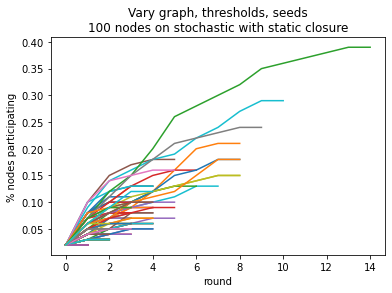

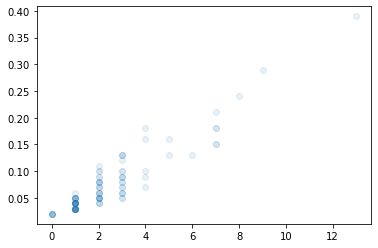

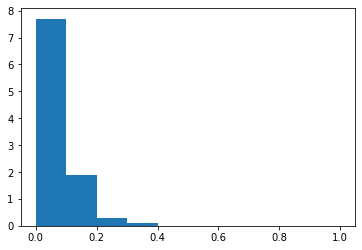

[50, 50]


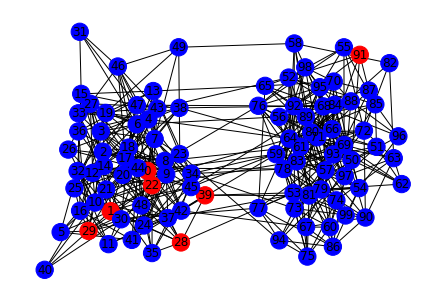

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=10


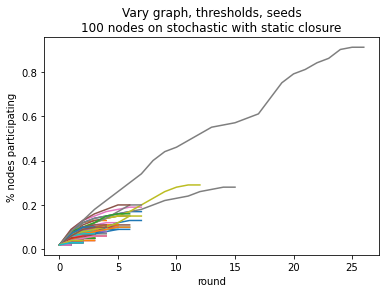

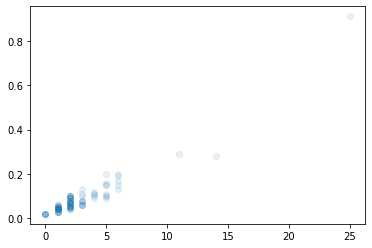

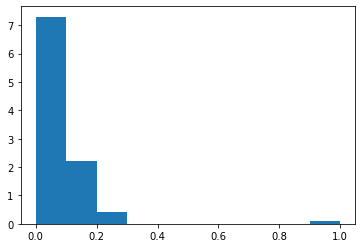

[50, 50]


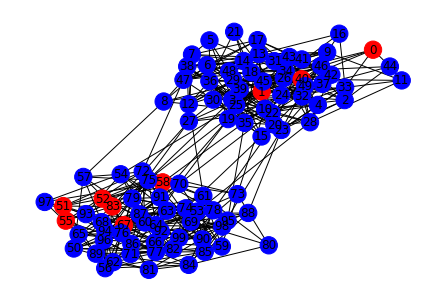

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=25


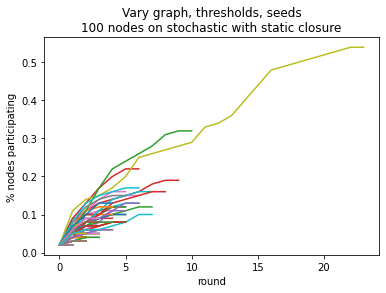

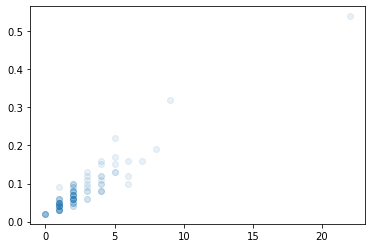

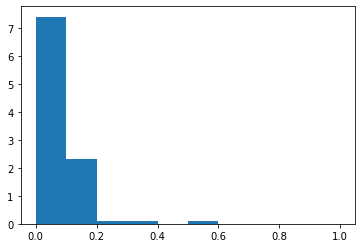

[50, 50]


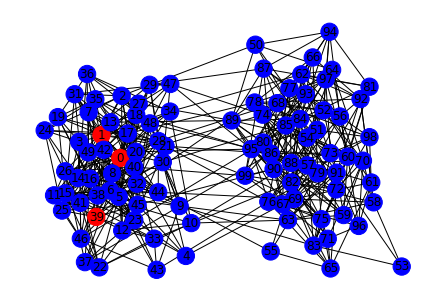

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=50


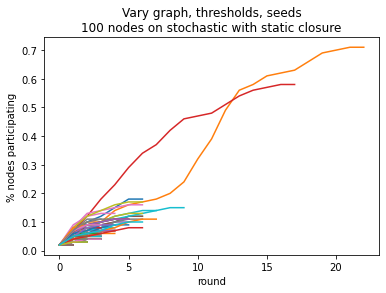

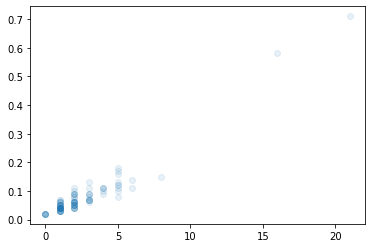

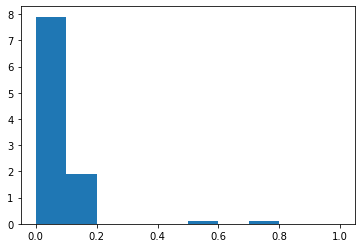

[20, 30, 50]


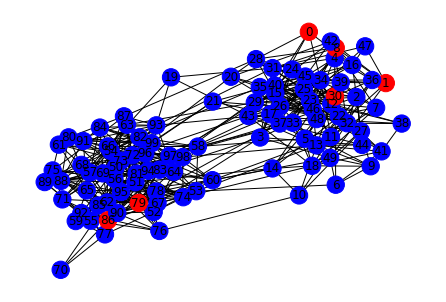

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=75


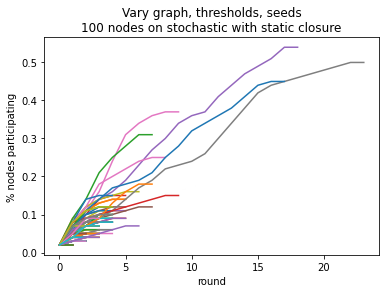

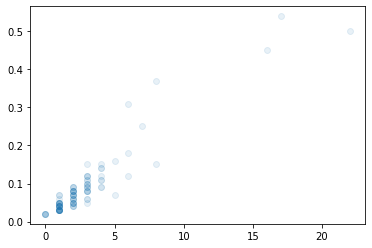

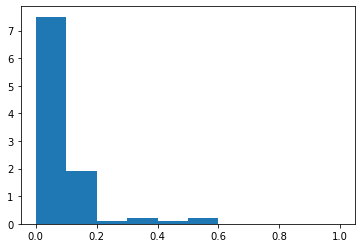

[100]


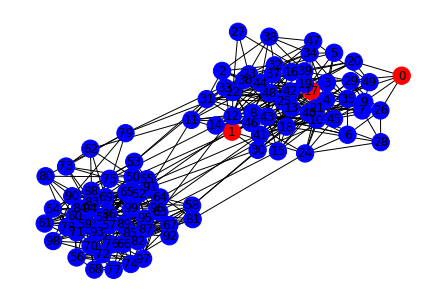

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=100


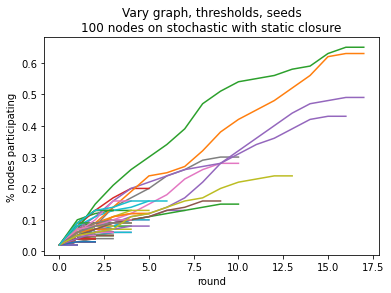

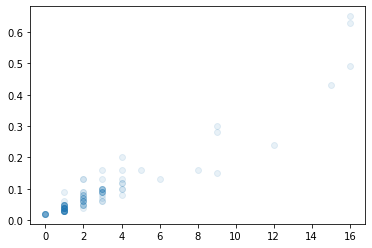

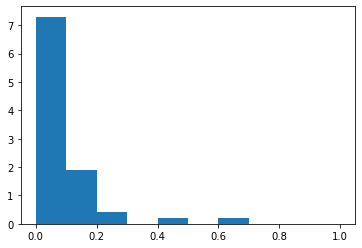

[50, 50]


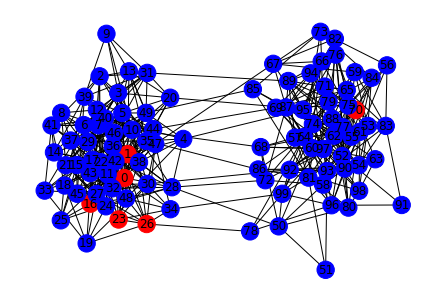

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=250


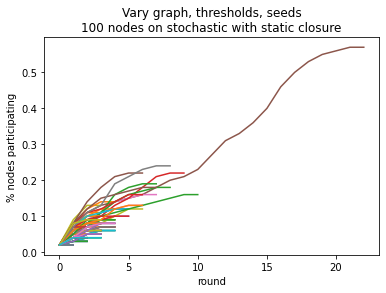

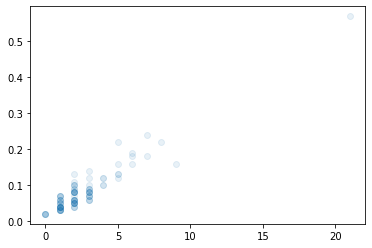

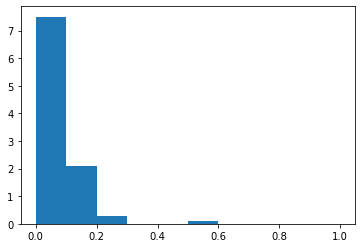

[32, 18, 50]


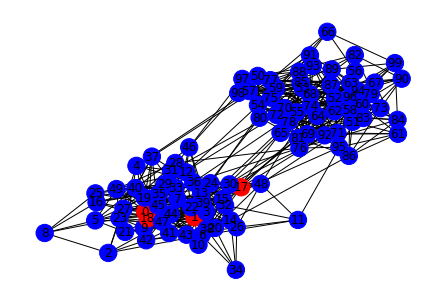

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=500


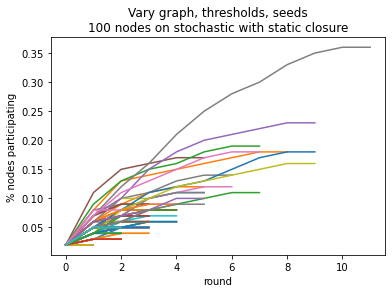

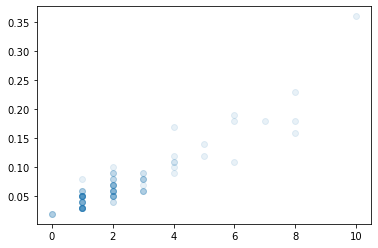

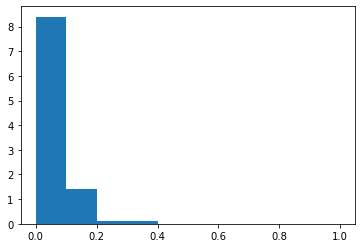

[50, 50]


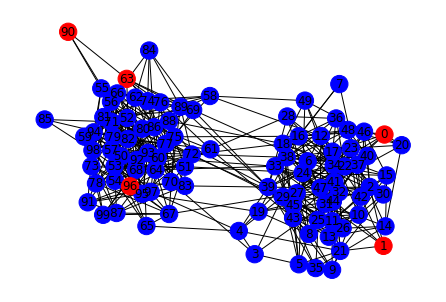

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=1


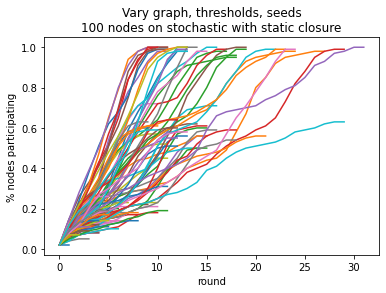

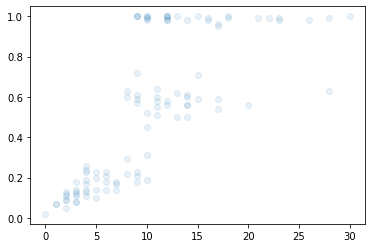

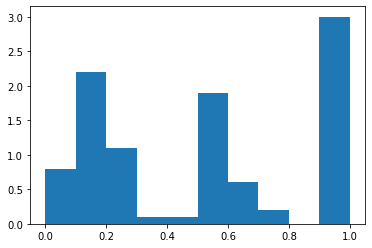

[50, 50]


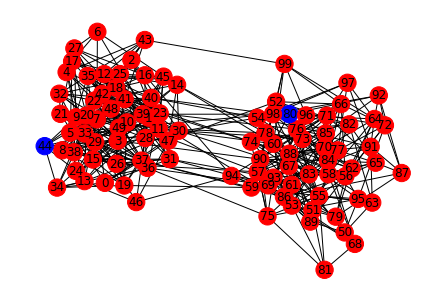

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=5


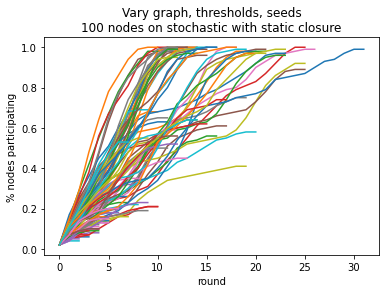

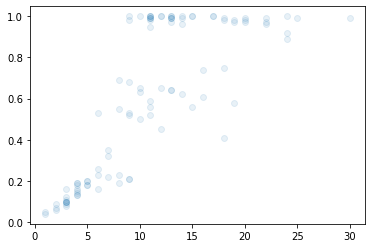

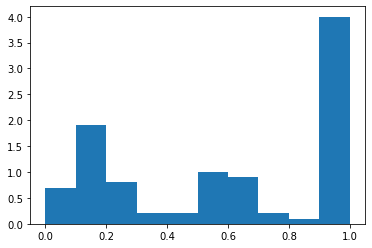

[50, 50]


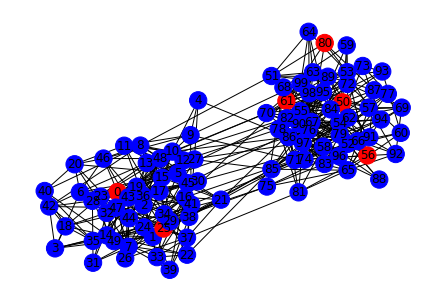

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=10


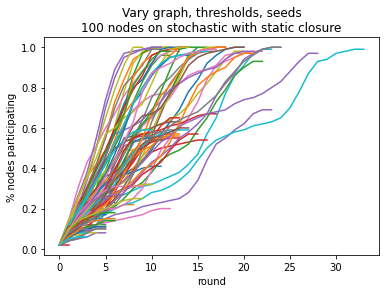

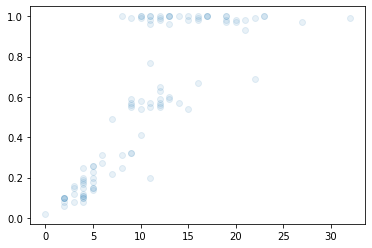

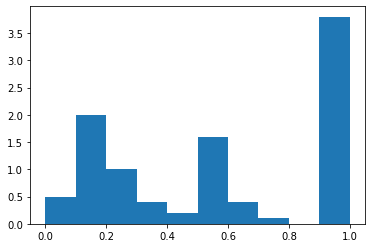

[50, 50]


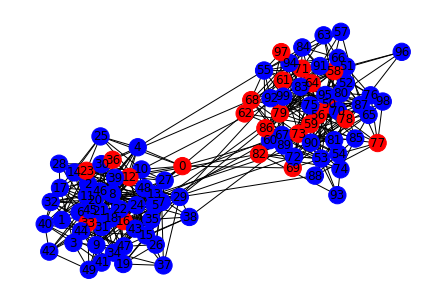

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=25


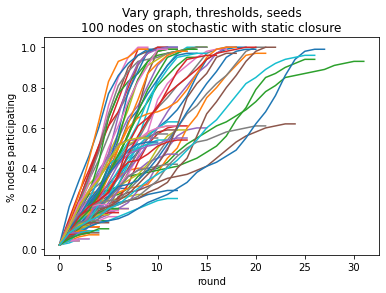

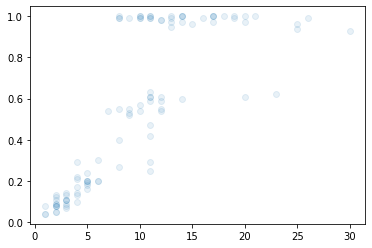

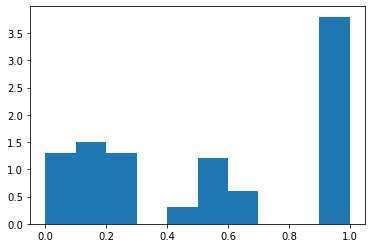

[50, 50]


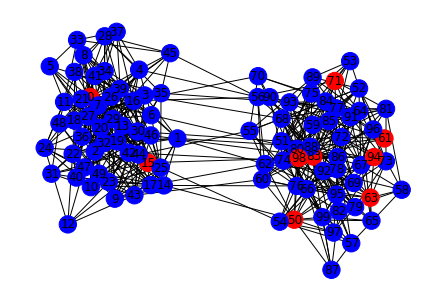

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=50


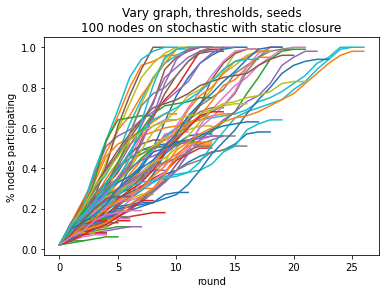

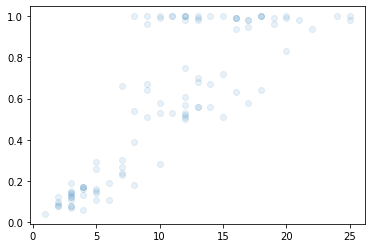

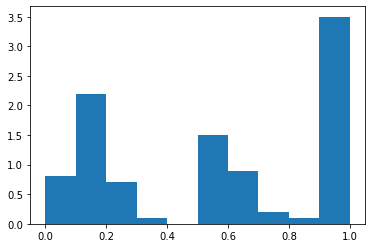

[50, 50]


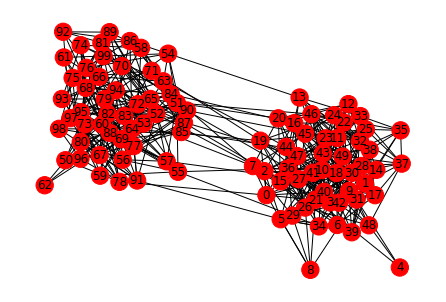

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=75


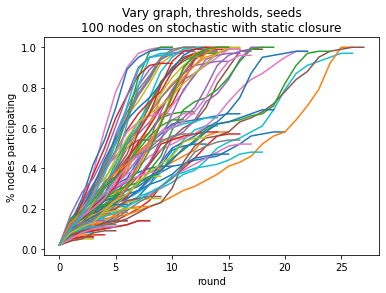

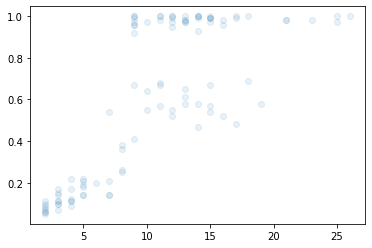

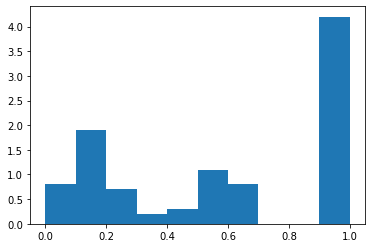

[100]


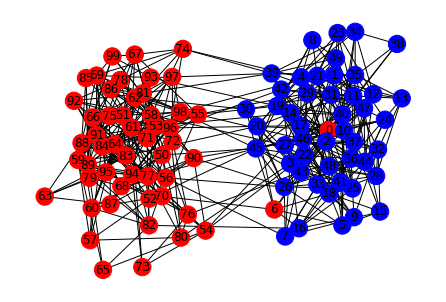

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=100


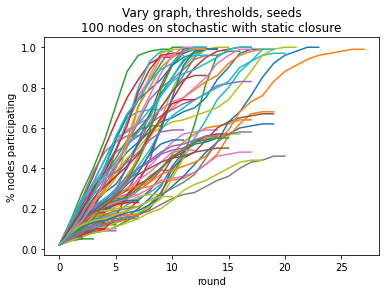

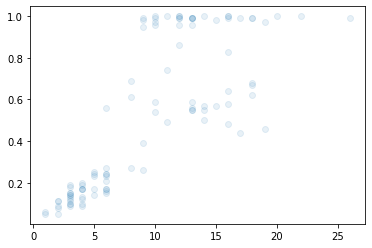

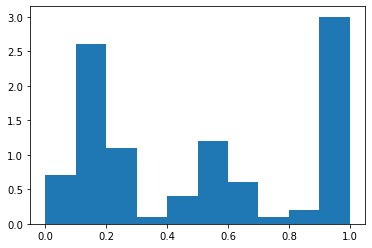

[50, 50]


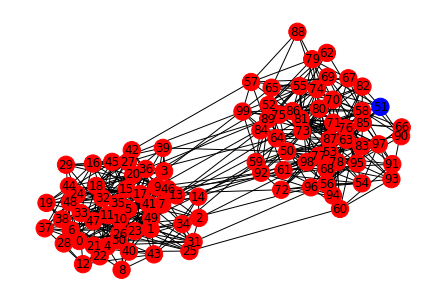

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=250


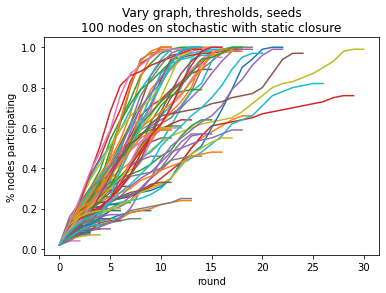

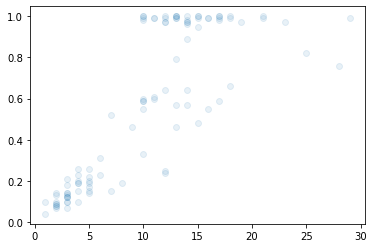

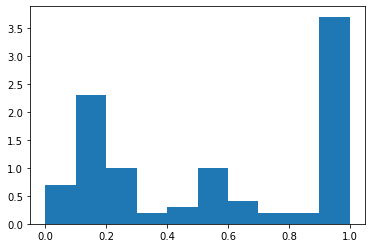

[50, 50]


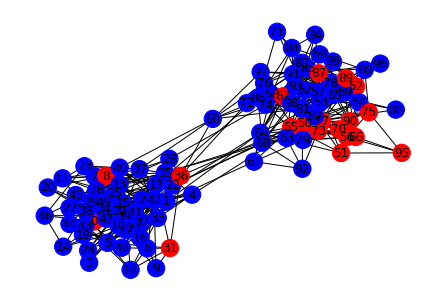

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=500


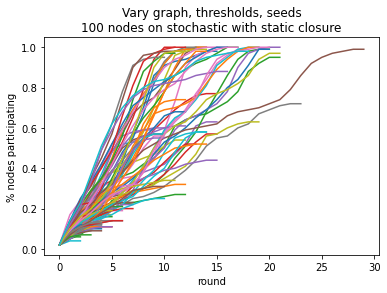

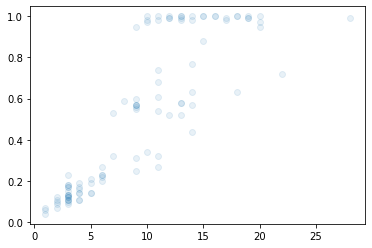

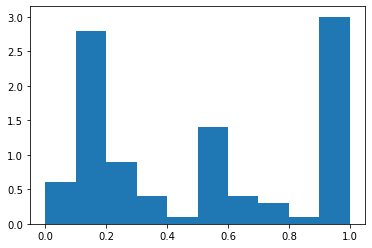

[50, 50]


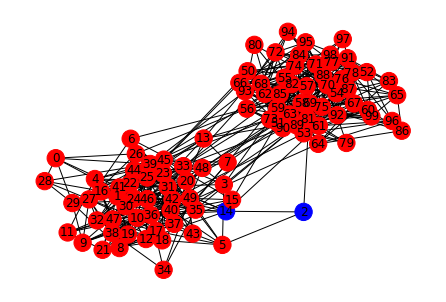

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=1


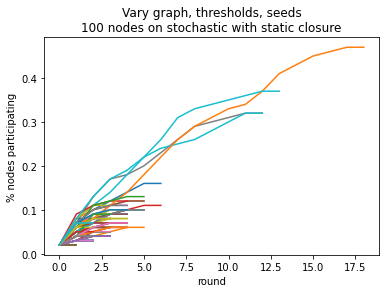

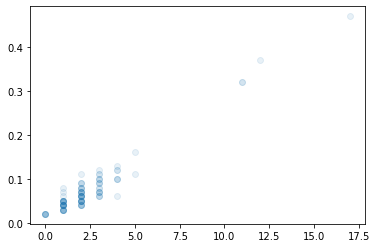

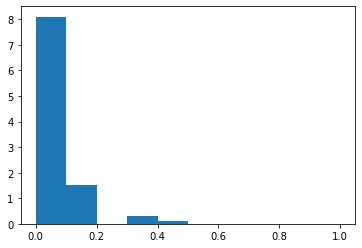

[50, 50]


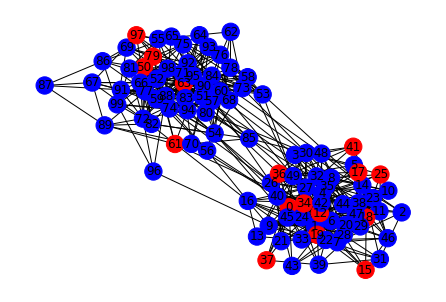

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=5


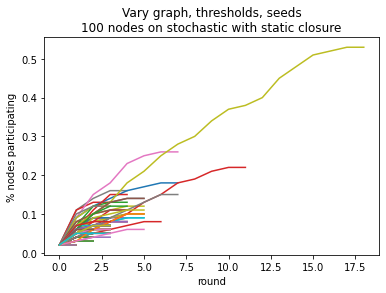

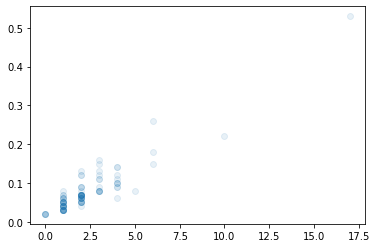

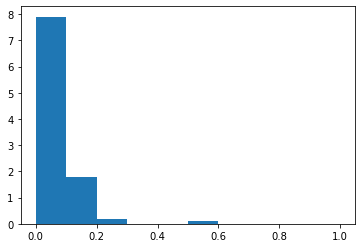

[100]


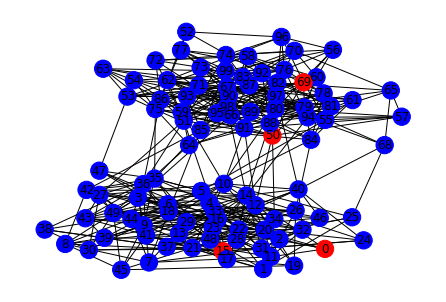

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=10


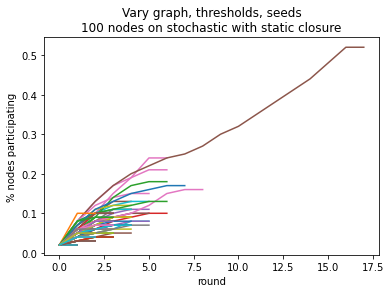

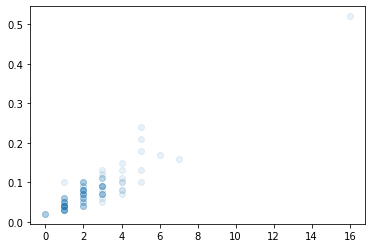

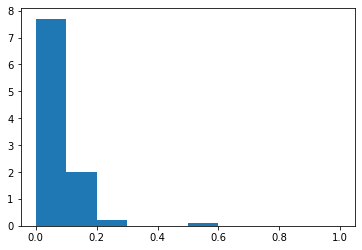

[50, 50]


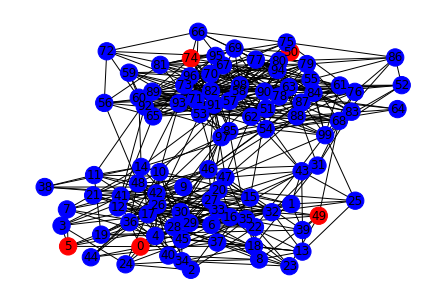

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=25


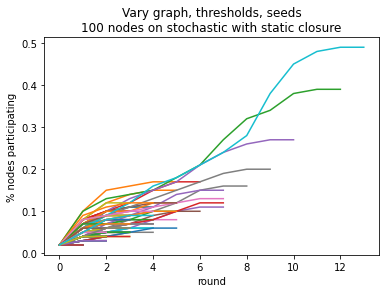

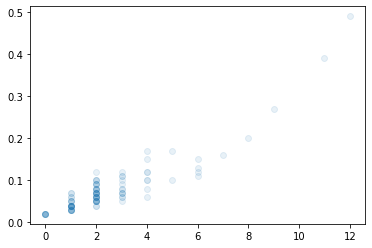

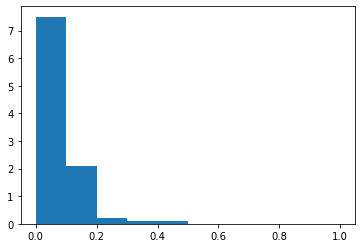

[50, 50]


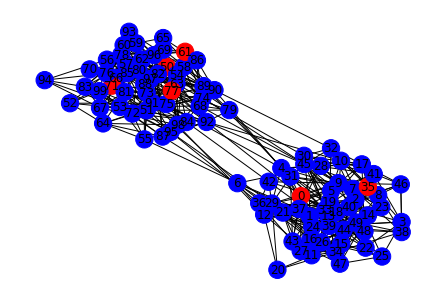

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=50


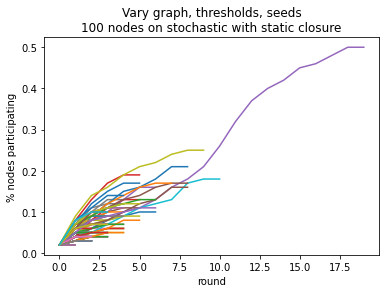

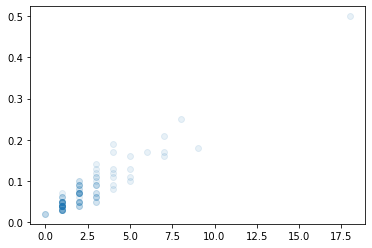

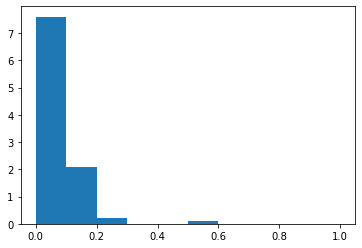

[50, 50]


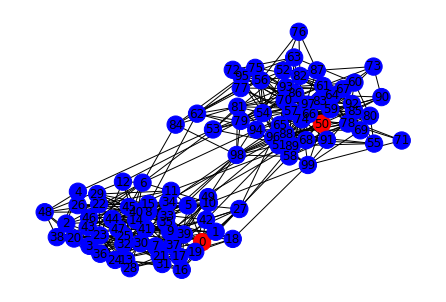

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=75


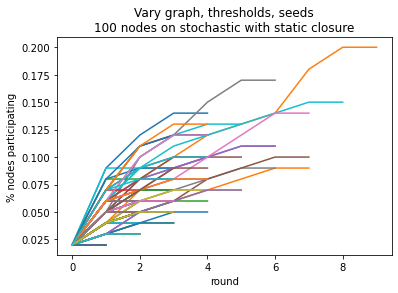

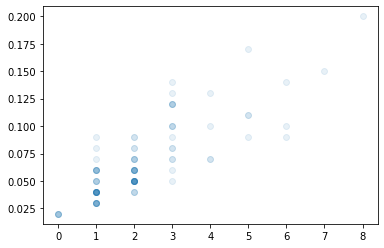

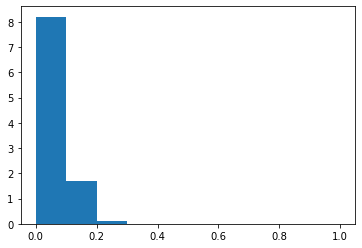

[100]


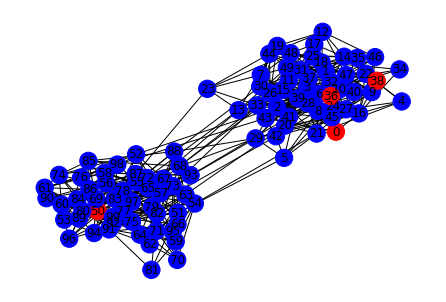

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=100


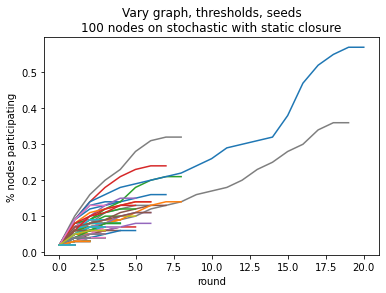

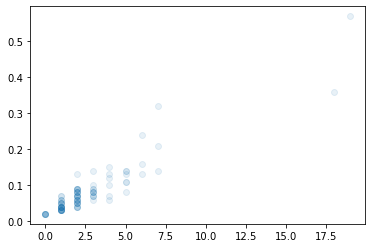

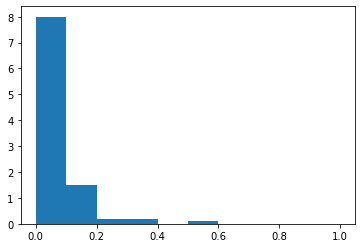

[100]


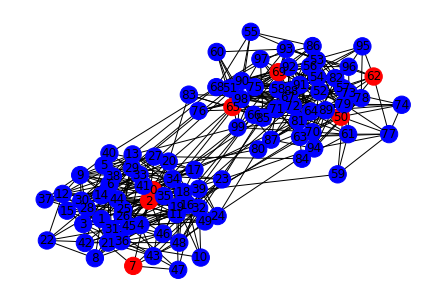

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=250


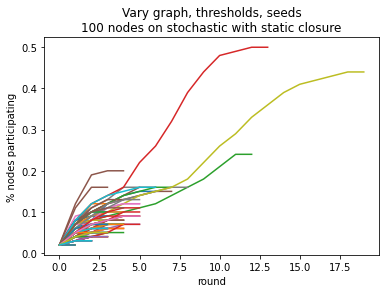

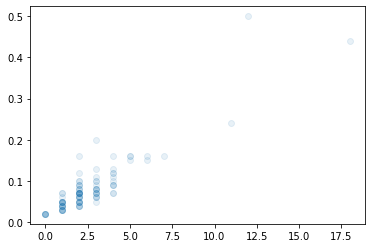

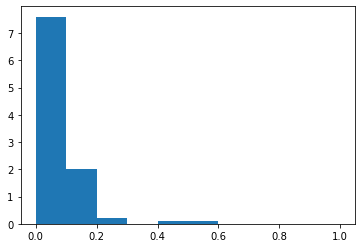

[100]


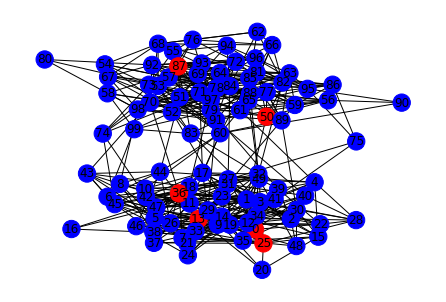

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=500


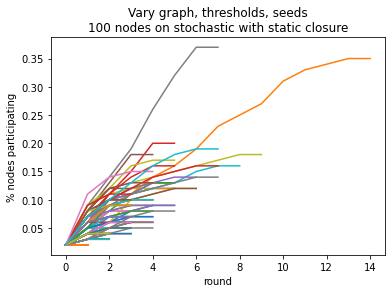

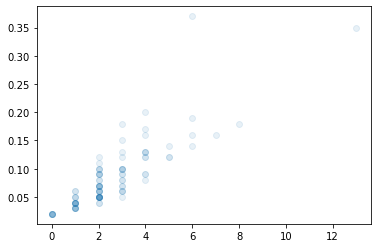

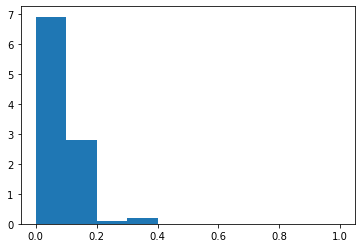

[50, 50]


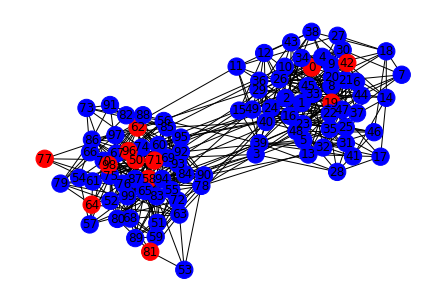

In [6]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
THRESHOLD_MEAN_LIST = [0.4, 0.5] # threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
SEED_CANDIDATES_DICT = {
    'joined': [0,1], # can define without loss of generality
    'forked': [0,50],
}
num_seeds = 2
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][4] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for seed_candidate_type in SEED_CANDIDATES_DICT:
    seed_candidates = SEED_CANDIDATES_DICT[seed_candidate_type]
    for threshold_mean in THRESHOLD_MEAN_LIST:
        for closure_rate in CLOSURE_RATE_LIST:
            print(f'Now running simulation for seed_candidates={seed_candidates} threshold={threshold_mean} closure_rate={closure_rate}')

            # Retrieve output from before
            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
                open(f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelmax_thres{threshold_mean}clos{closure_rate}.pkl', 'rb')
            )
            rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
                sim_log,
                num_experiments, graph_type, num_nodes, graph_params, 
                threshold_mean, threshold_var, seed_candidates, num_seeds, 
                use_network, sticky_cascade, closure_method, closure_rate, 
                max_rounds, save_path=f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelstatic_thres{threshold_mean}clos{closure_rate}.pkl', 
                use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
            )

            # print(rounds_filled)
            # print(rounds_frozen)
            # print(max_size_round)

            _ = plt.scatter(
                max_size_round,
                [r[-1] for r in sizes_round],
                alpha=0.1,
            )
            plt.show()

            _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
            plt.show()

            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
                open(f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelstatic_thres{threshold_mean}clos{closure_rate}.pkl', 'rb')
            )
            drawn_graph = sim_log[0][3][-1]
            drawn_colors = sim_log[0][4][-1]
            drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
            print(get_community_sizes(drawn_graph))
            nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
            plt.show()

## IDENTICAL AS ABOVE Graph Threshold Seed settings ; Simulating with Closure (Population)

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=1


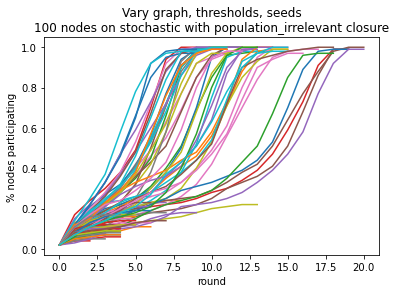

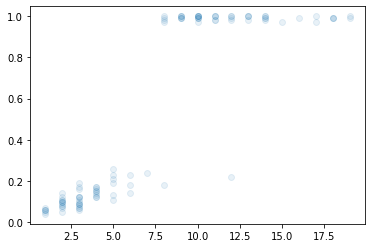

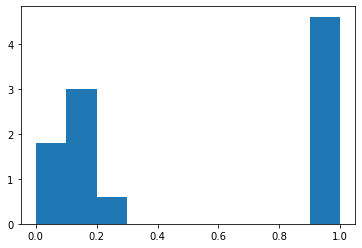

[50, 50]


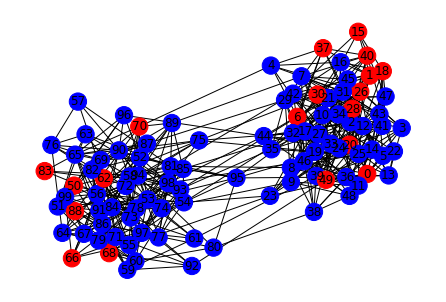

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=5


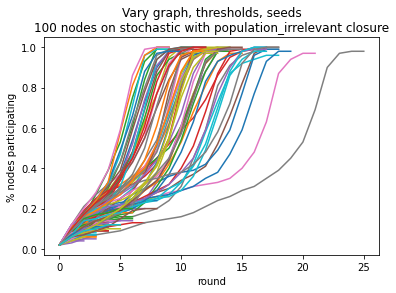

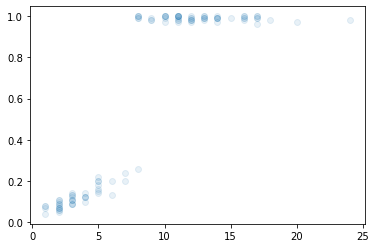

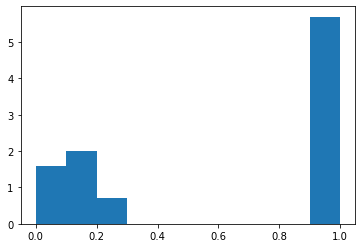

[74, 26]


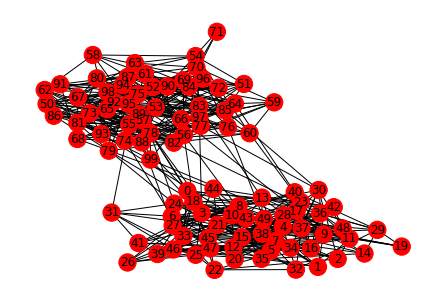

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=10


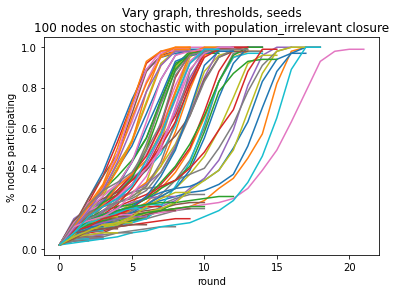

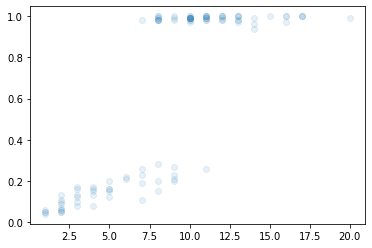

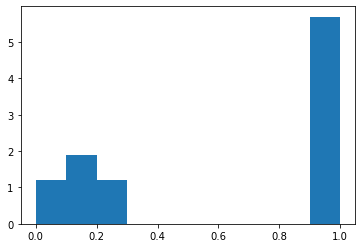

[50, 50]


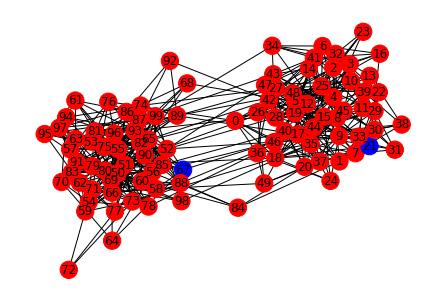

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=25


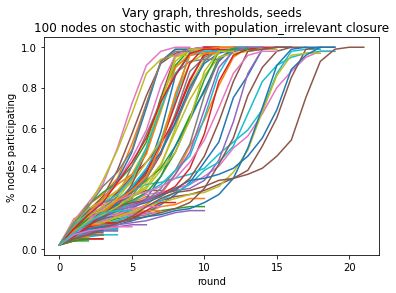

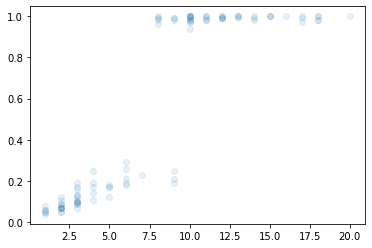

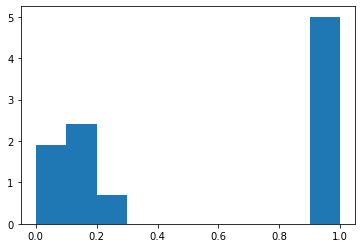

[100]


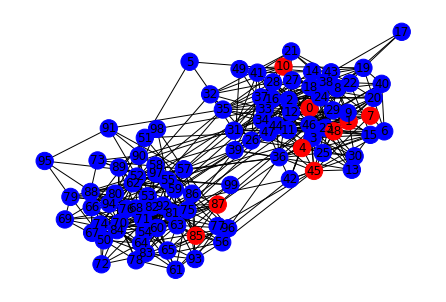

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=50


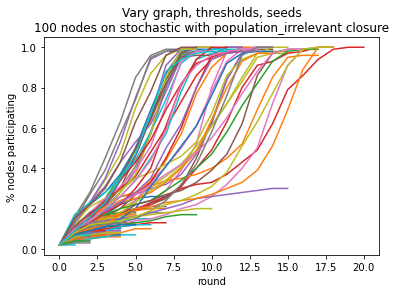

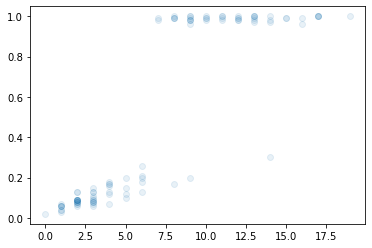

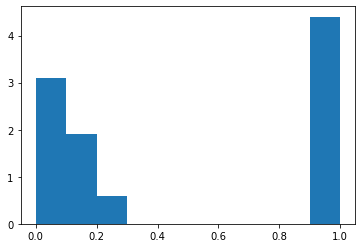

[50, 50]


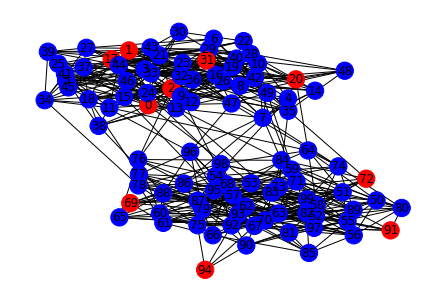

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=75


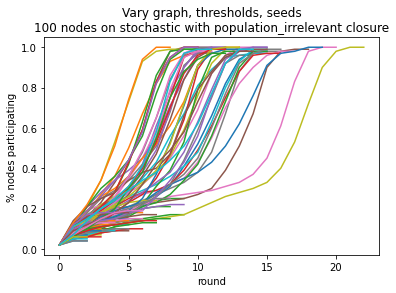

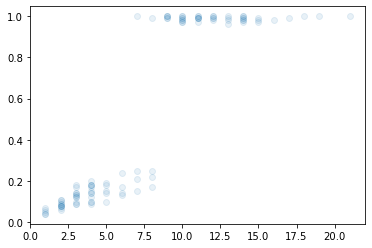

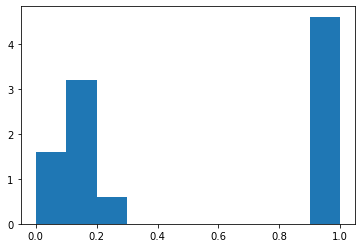

[50, 50]


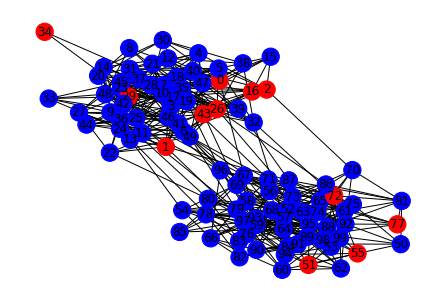

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=100


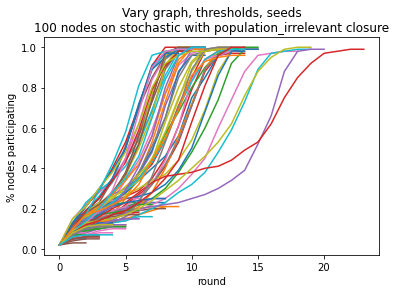

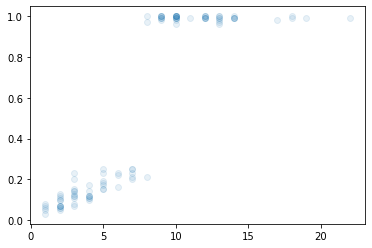

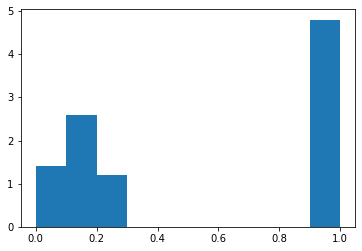

[50, 50]


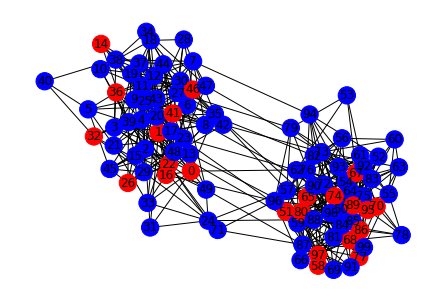

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=250


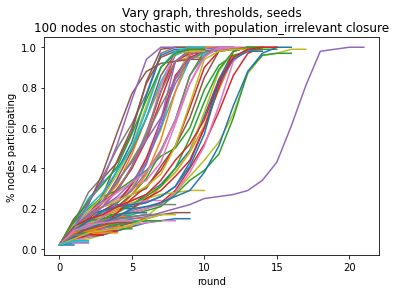

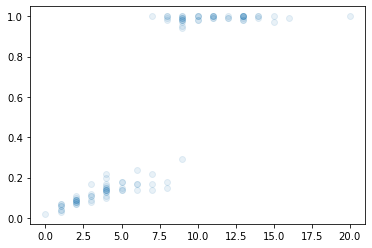

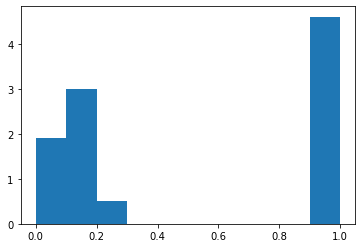

[50, 50]


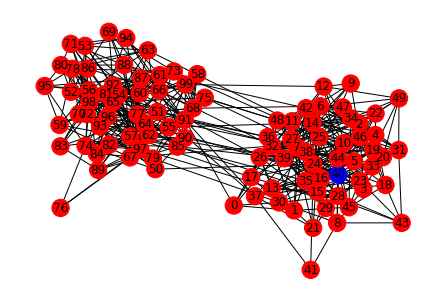

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=500


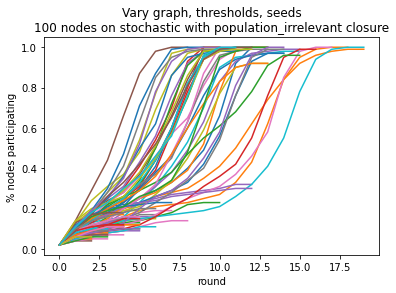

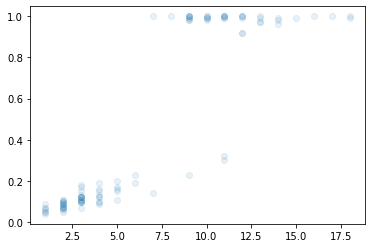

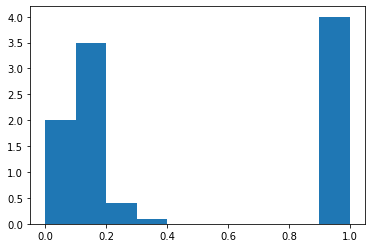

[15, 18, 17, 50]


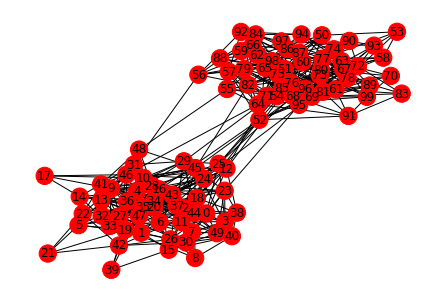

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=1


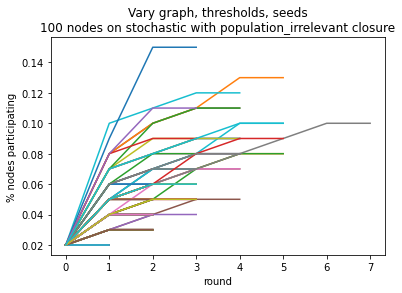

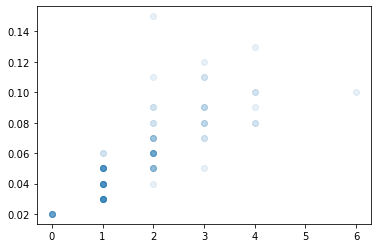

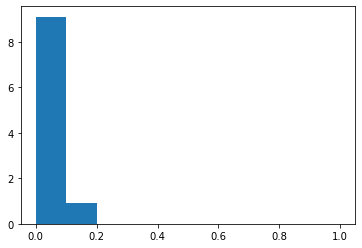

[100]


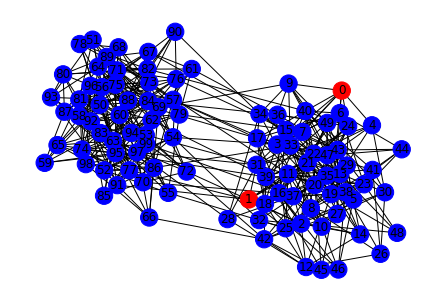

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=5


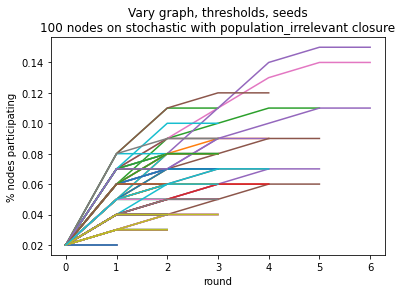

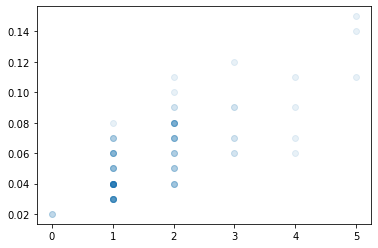

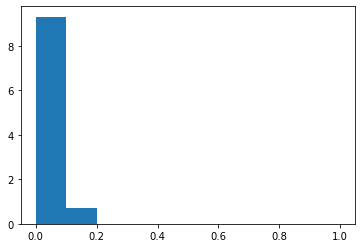

[50, 50]


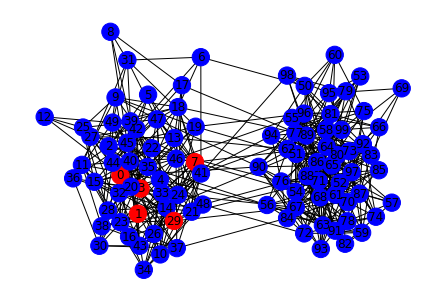

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=10


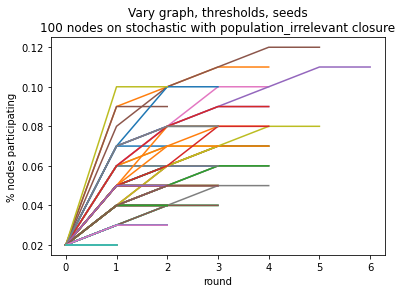

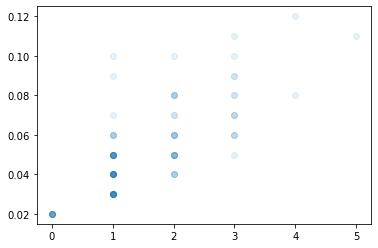

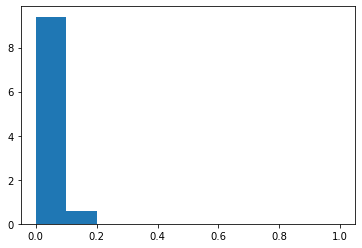

[50, 50]


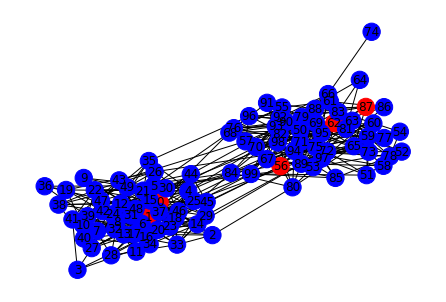

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=25


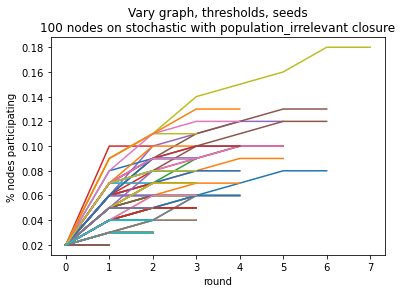

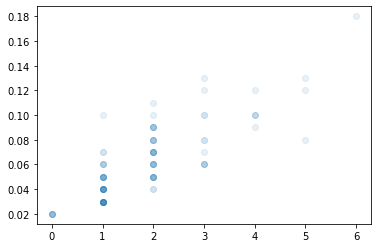

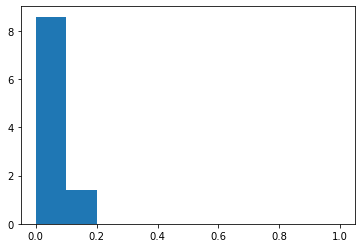

[50, 50]


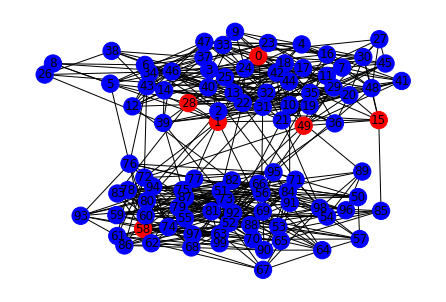

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=50


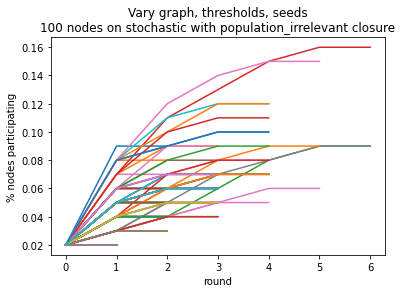

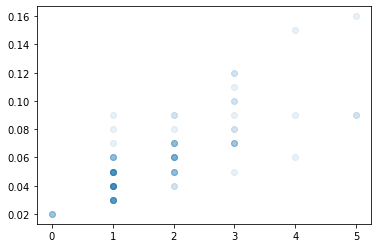

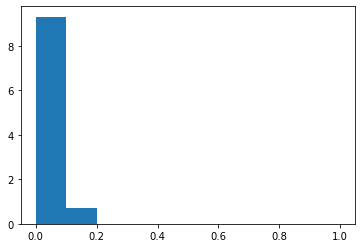

[50, 50]


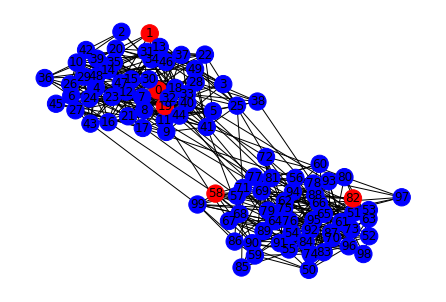

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=75


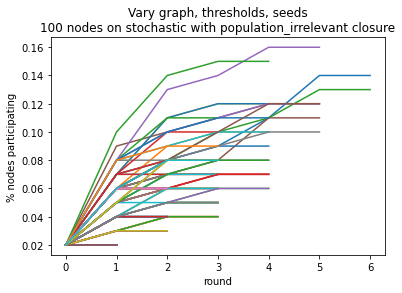

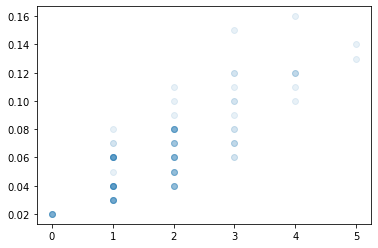

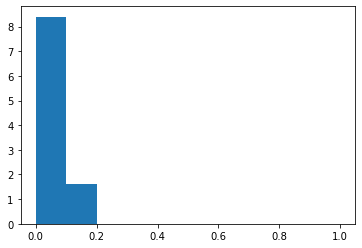

[50, 50]


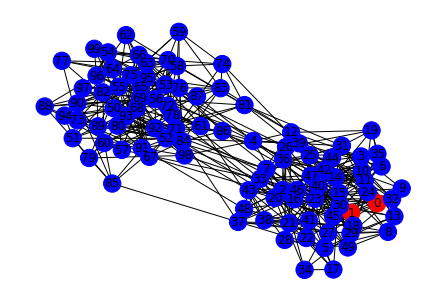

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=100


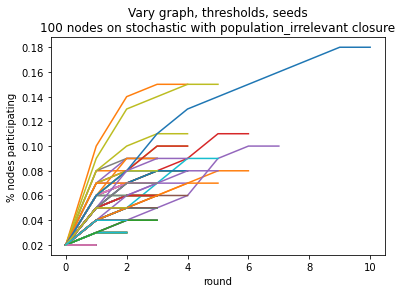

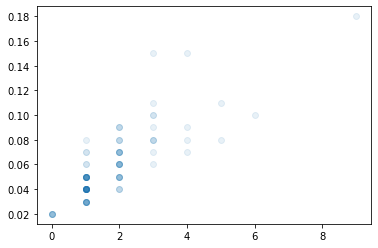

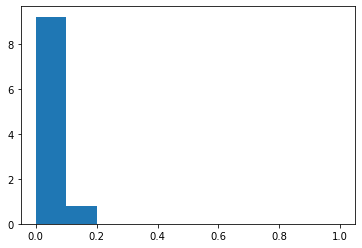

[50, 23, 27]


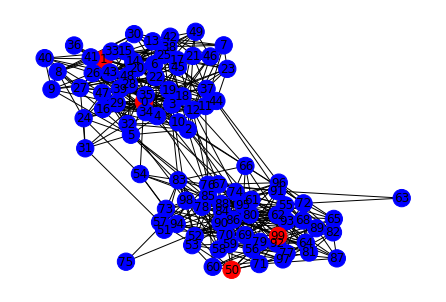

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=250


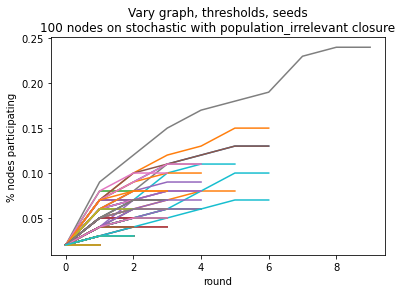

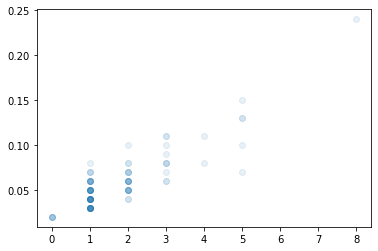

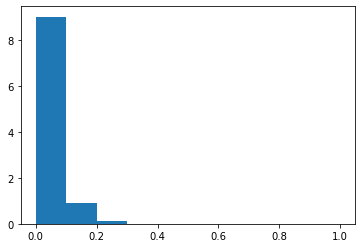

[50, 31, 19]


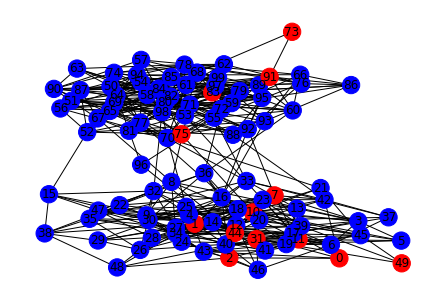

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=500


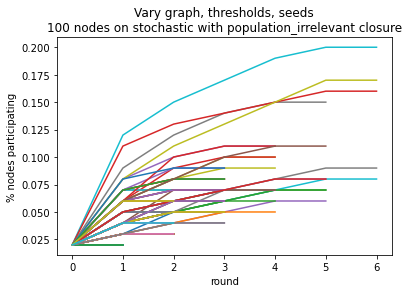

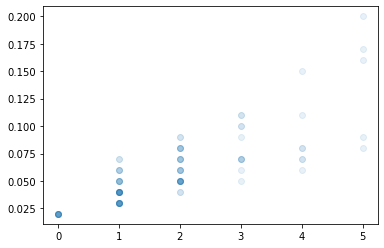

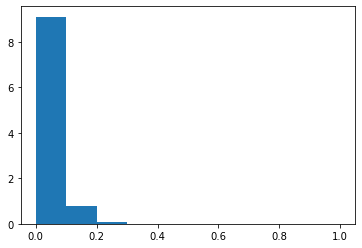

[50, 50]


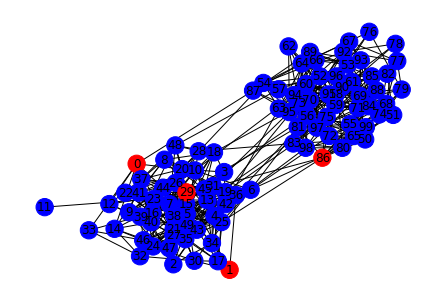

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=1


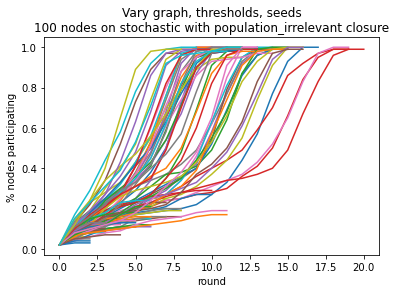

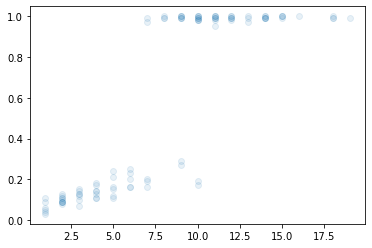

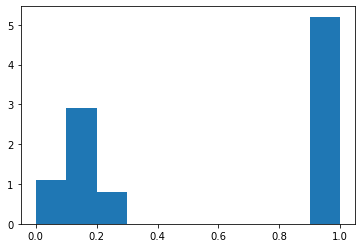

[50, 50]


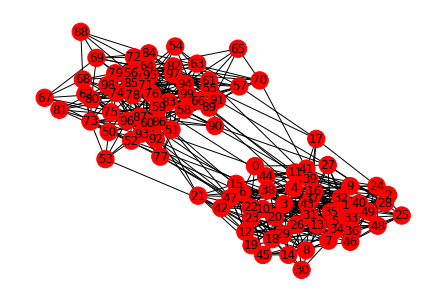

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=5


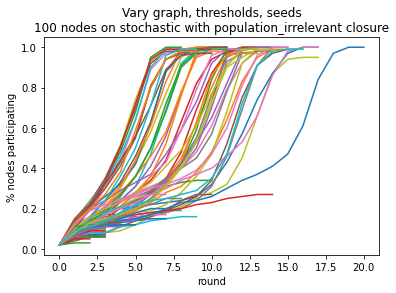

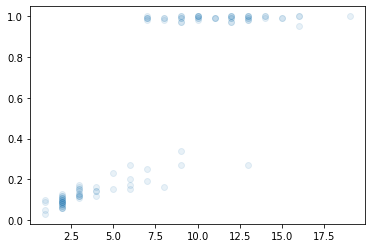

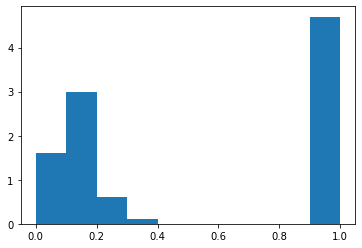

[50, 50]


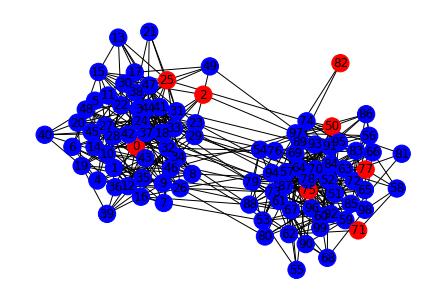

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=10


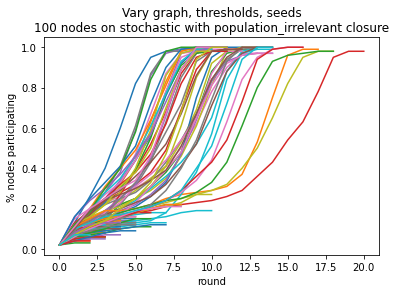

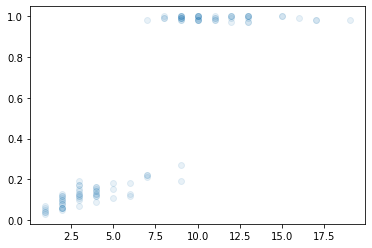

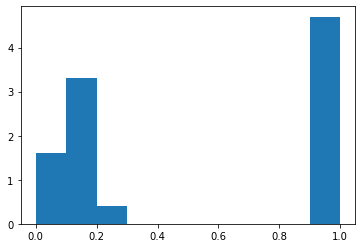

[50, 50]


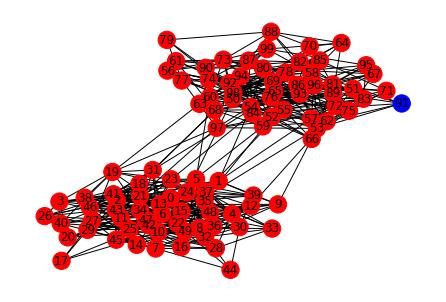

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=25


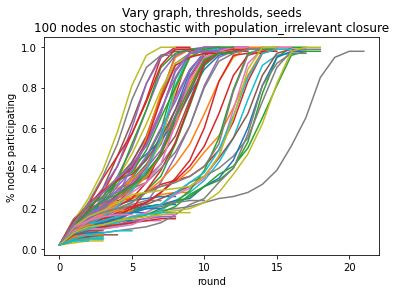

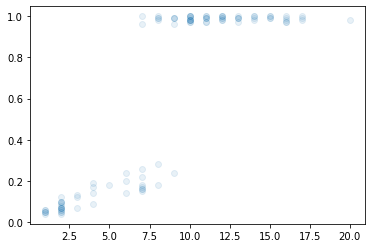

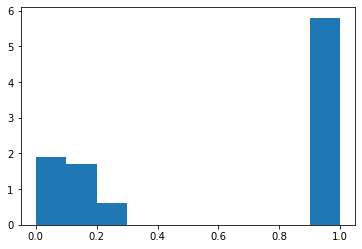

[50, 50]


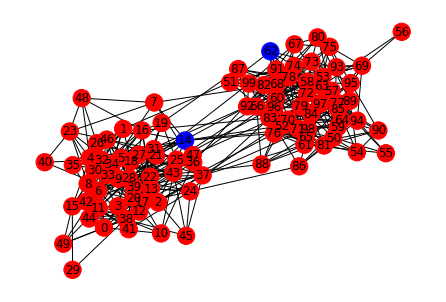

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=50


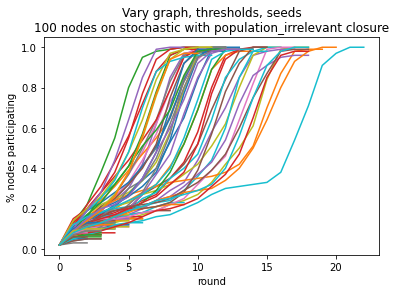

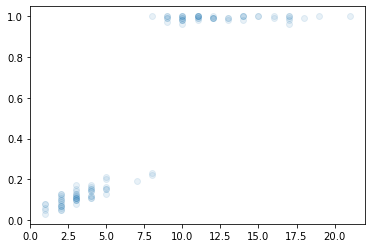

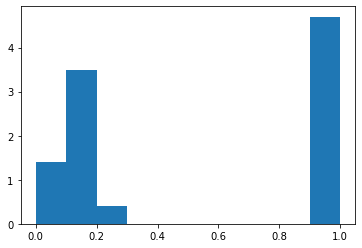

[50, 50]


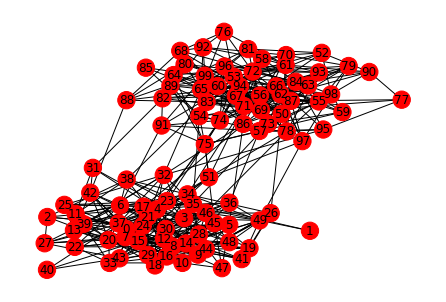

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=75


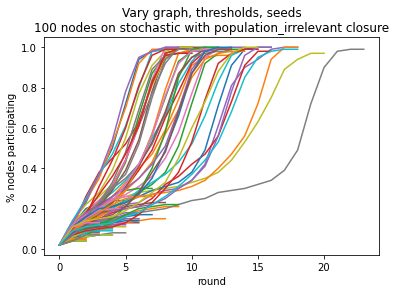

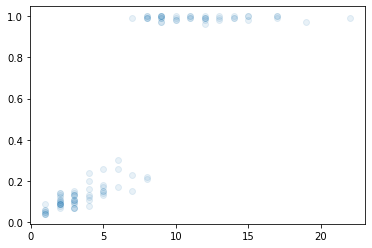

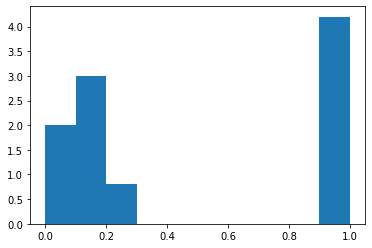

[28, 22, 50]


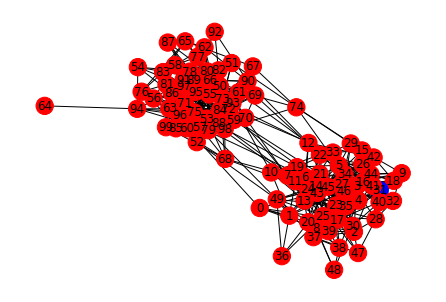

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=100


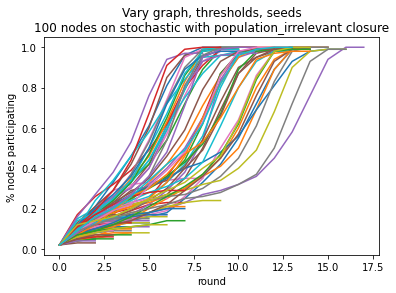

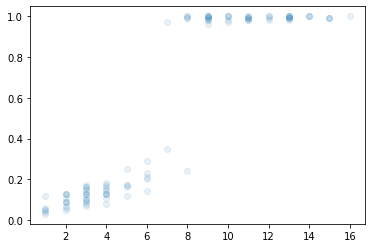

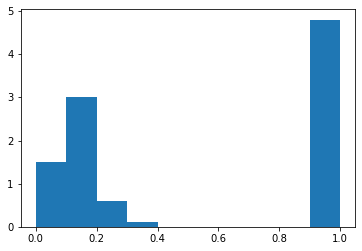

[50, 50]


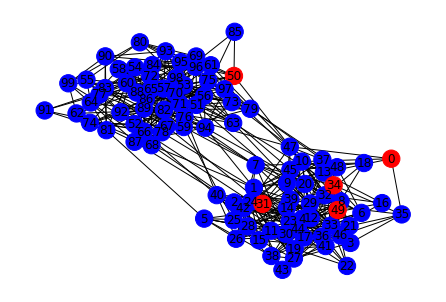

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=250


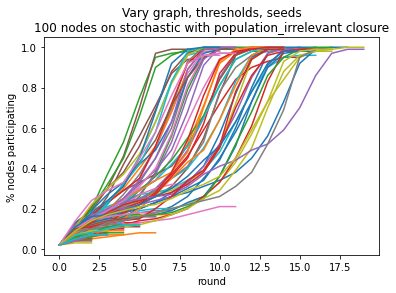

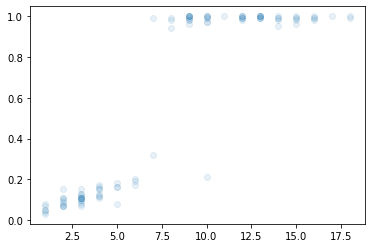

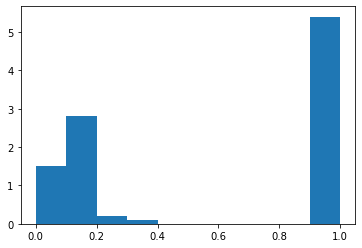

[50, 50]


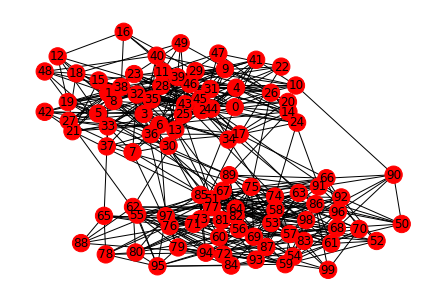

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=500


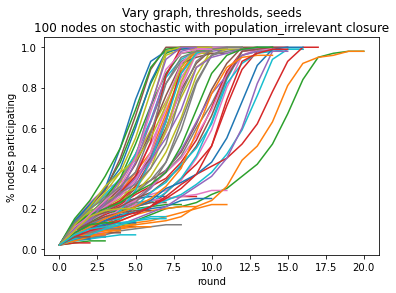

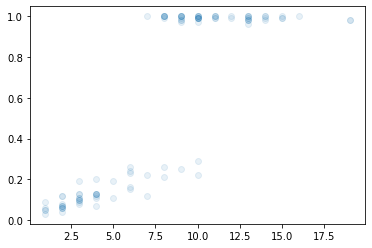

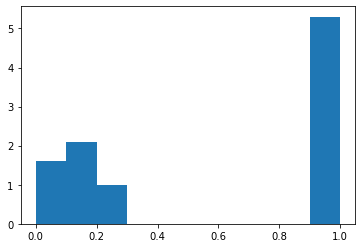

[50, 50]


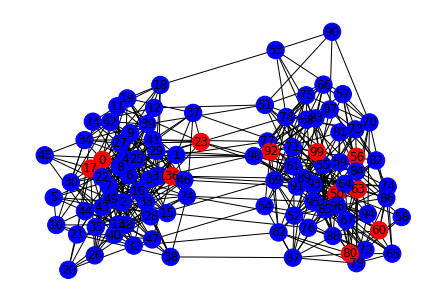

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=1


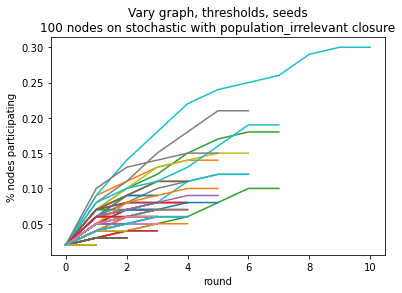

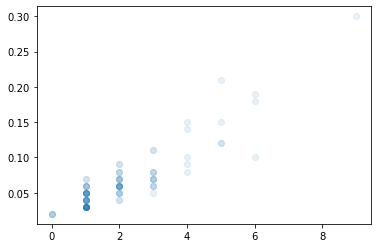

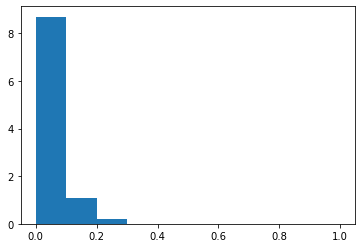

[50, 50]


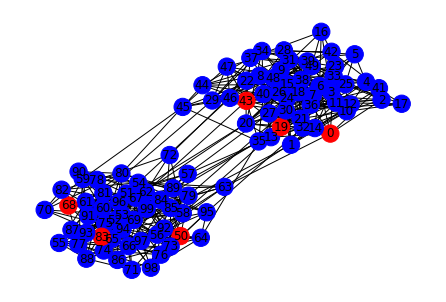

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=5


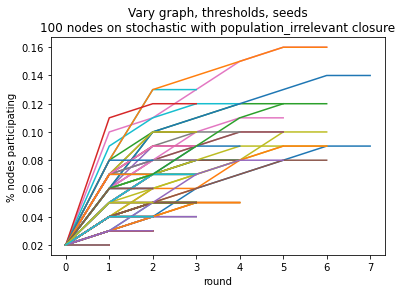

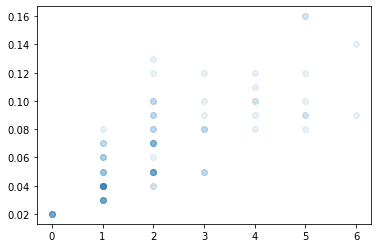

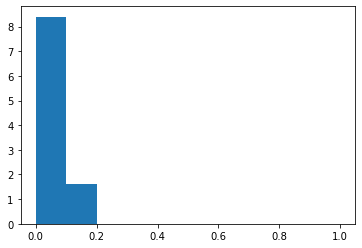

[50, 50]


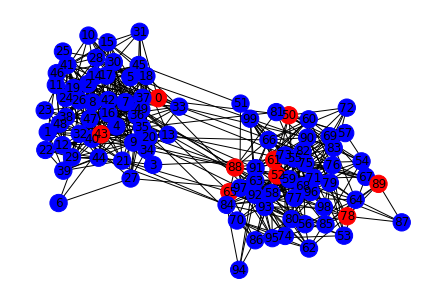

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=10


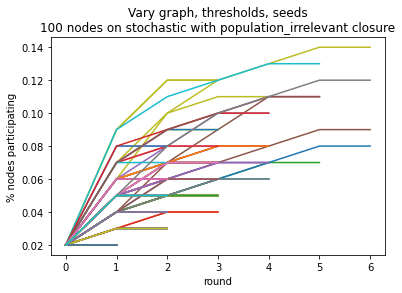

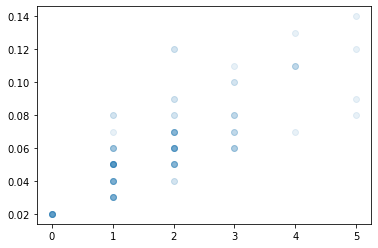

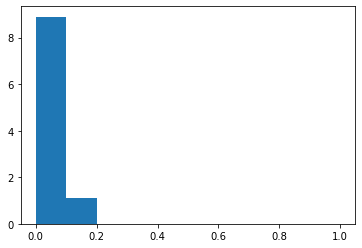

[50, 50]


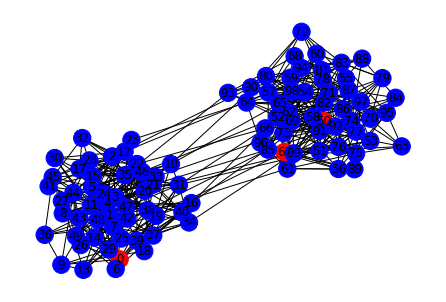

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=25


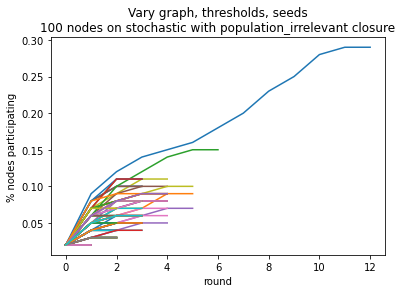

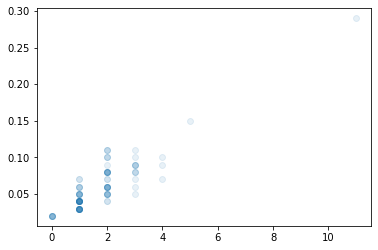

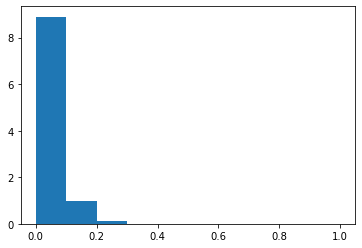

[100]


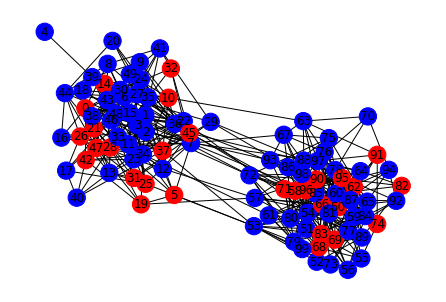

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=50


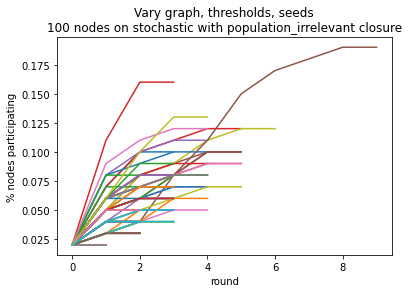

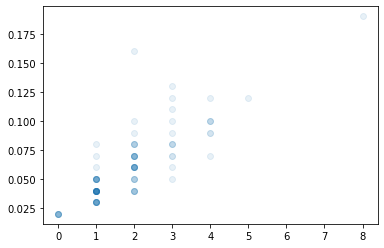

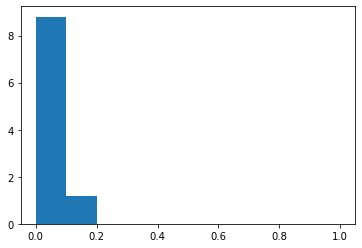

[50, 50]


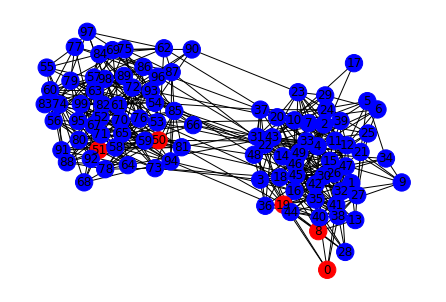

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=75


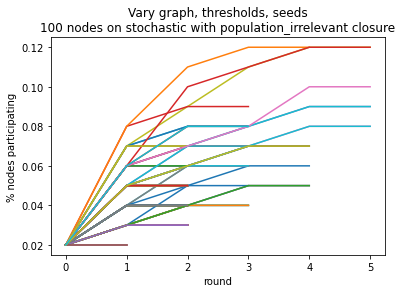

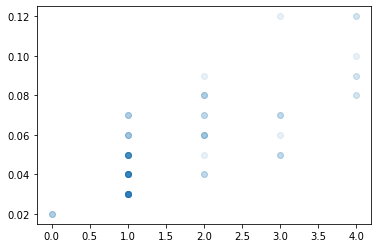

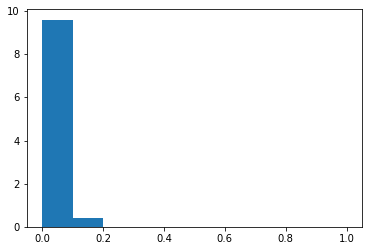

[50, 50]


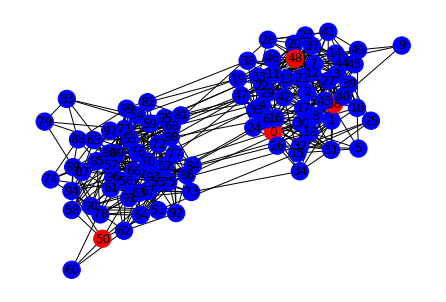

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=100


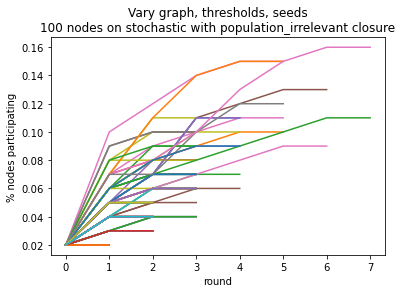

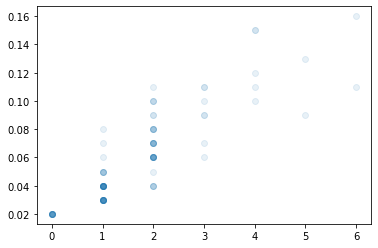

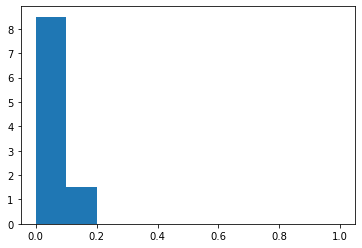

[50, 50]


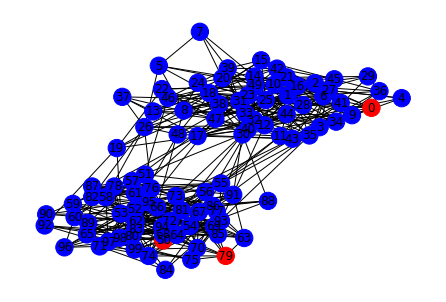

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=250


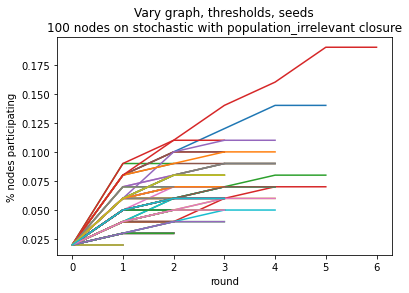

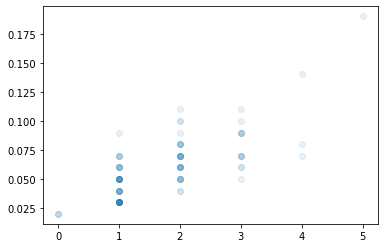

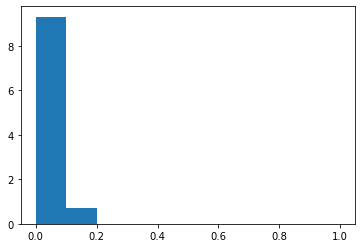

[50, 50]


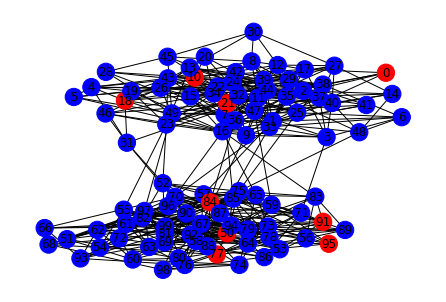

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=500


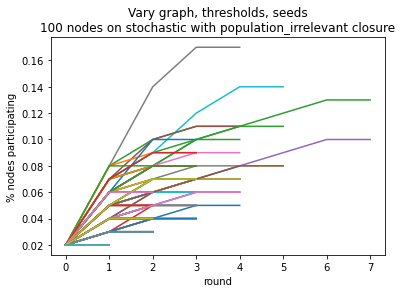

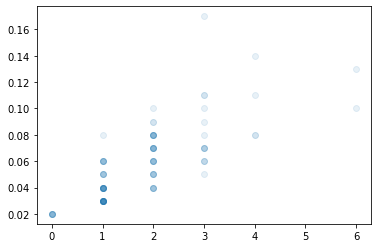

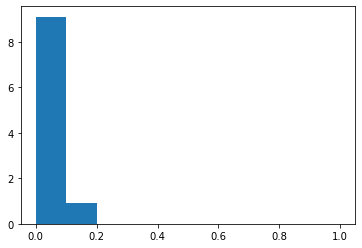

[50, 50]


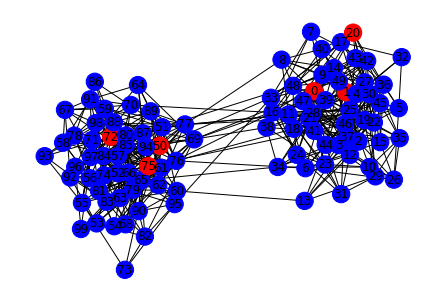

In [7]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
THRESHOLD_MEAN_LIST = [0.4, 0.5] # threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
SEED_CANDIDATES_DICT = {
    'joined': [0,1], # can define without loss of generality
    'forked': [0,50],
}
num_seeds = 2
# Simulation hyperparameters
use_network = False
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][5] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for seed_candidate_type in SEED_CANDIDATES_DICT:
    seed_candidates = SEED_CANDIDATES_DICT[seed_candidate_type]
    for threshold_mean in THRESHOLD_MEAN_LIST:
        for closure_rate in CLOSURE_RATE_LIST:
            print(f'Now running simulation for seed_candidates={seed_candidates} threshold={threshold_mean} closure_rate={closure_rate}')

            # Retrieve output from before
            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
                open(f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelmax_thres{threshold_mean}clos{closure_rate}.pkl', 'rb')
            )
            rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
                sim_log,
                num_experiments, graph_type, num_nodes, graph_params, 
                threshold_mean, threshold_var, seed_candidates, num_seeds, 
                use_network, sticky_cascade, closure_method, closure_rate, 
                max_rounds, save_path=f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelpop_thres{threshold_mean}clos{closure_rate}.pkl', 
                use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
            )

            # print(rounds_filled)
            # print(rounds_frozen)
            # print(max_size_round)

            _ = plt.scatter(
                max_size_round,
                [r[-1] for r in sizes_round],
                alpha=0.1,
            )
            plt.show()

            _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
            plt.show()

            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
                open(f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelpop_thres{threshold_mean}clos{closure_rate}.pkl', 'rb')
            )
            drawn_graph = sim_log[0][3][-1]
            drawn_colors = sim_log[0][4][-1]
            drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
            print(get_community_sizes(drawn_graph))
            nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
            plt.show()

## IDENTICAL AS ABOVE Graph Threshold Seed settings ; Simulating with Closure (Random)

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=1


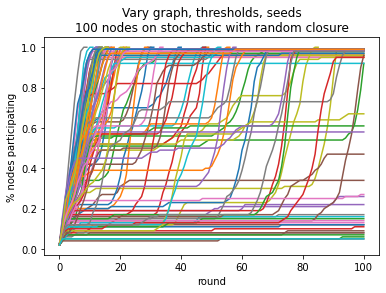

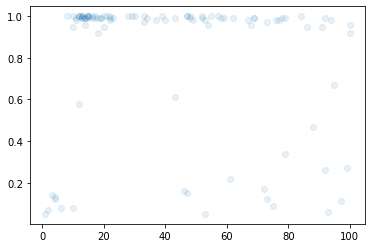

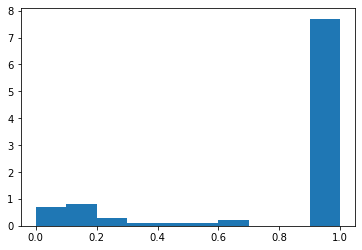

[50, 50]


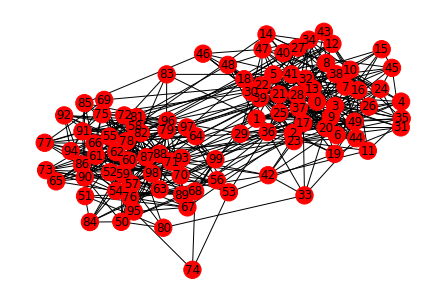

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=5


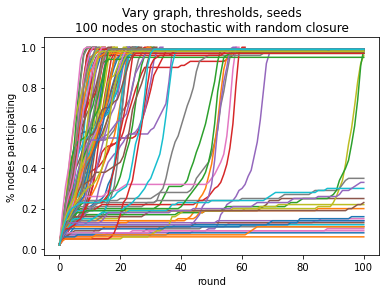

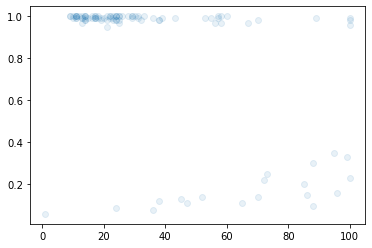

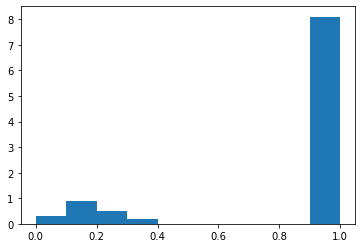

[100]


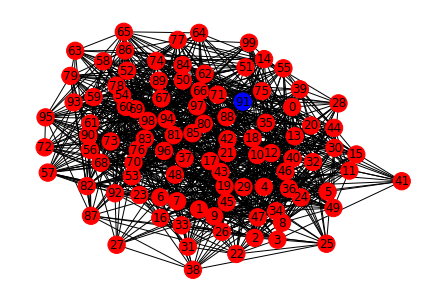

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=10


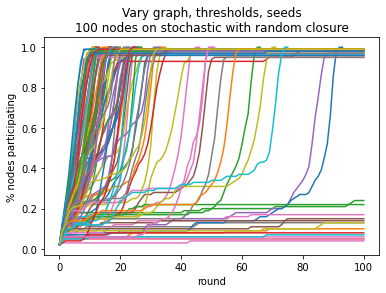

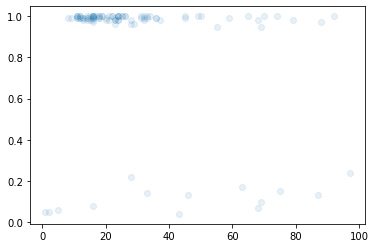

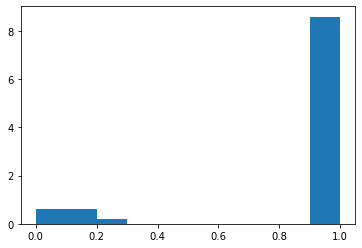

[100]


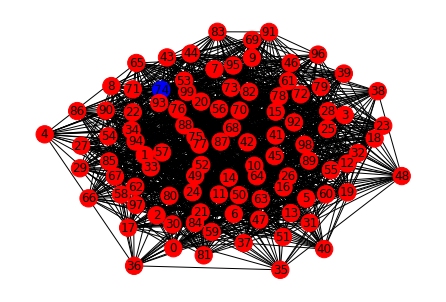

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=25


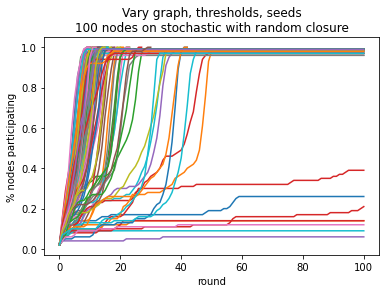

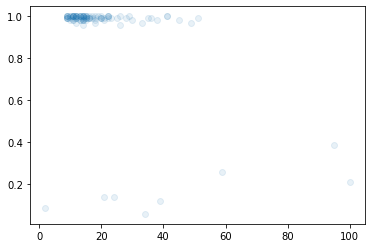

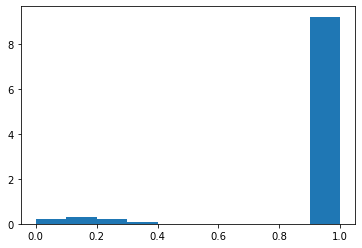

[100]


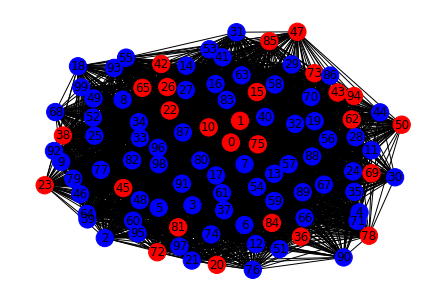

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=50


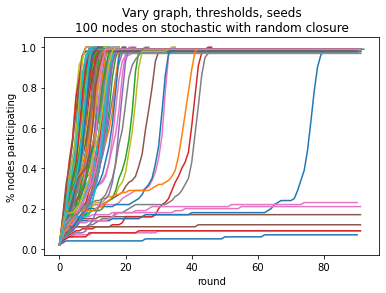

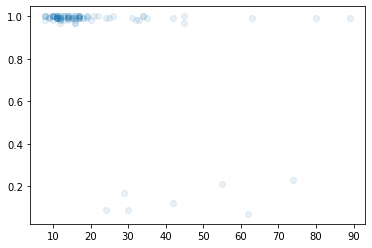

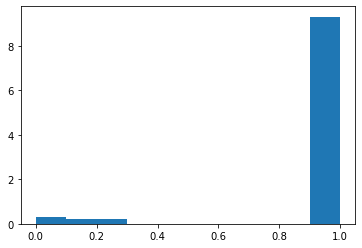

[100]


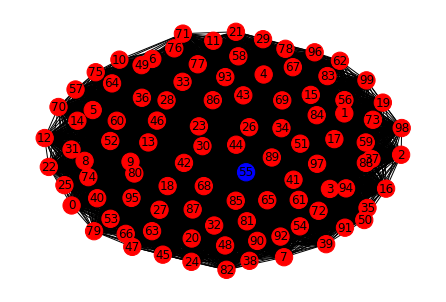

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=75


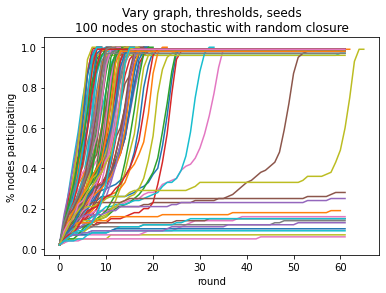

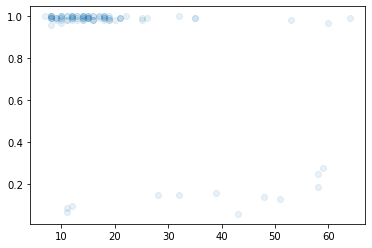

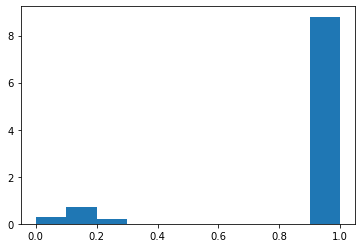

[100]


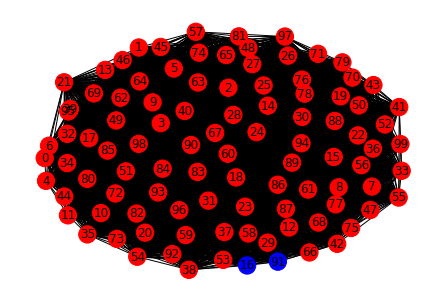

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=100


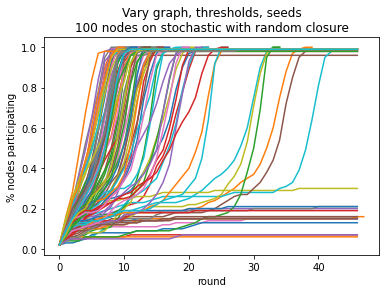

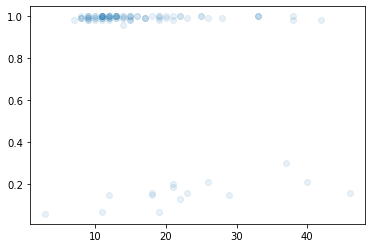

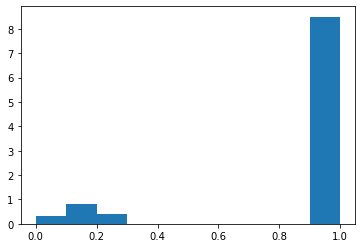

[100]


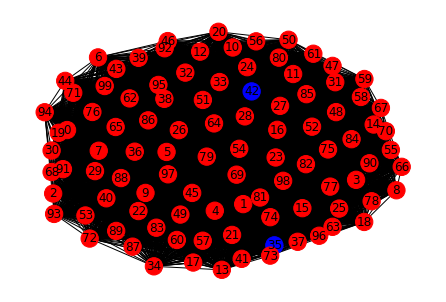

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=250


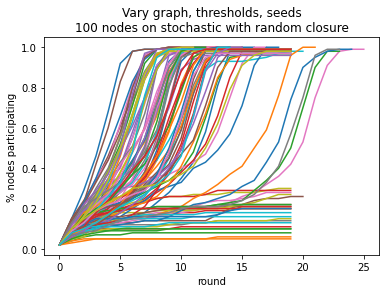

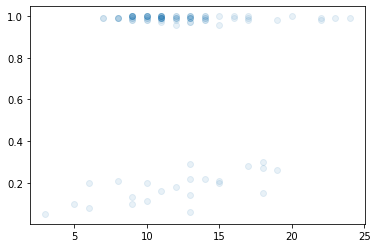

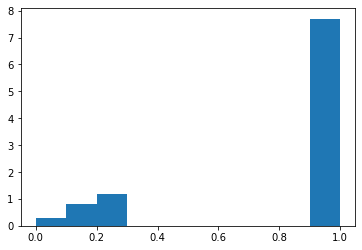

[100]


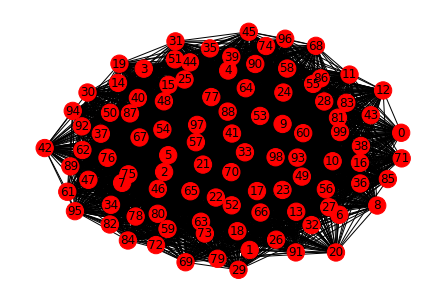

Now running simulation for seed_candidates=[0, 1] threshold=0.4 closure_rate=500


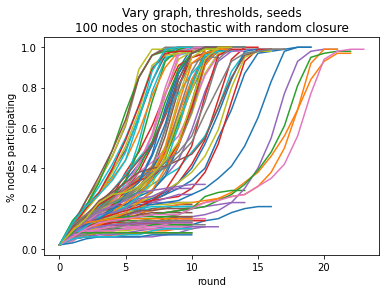

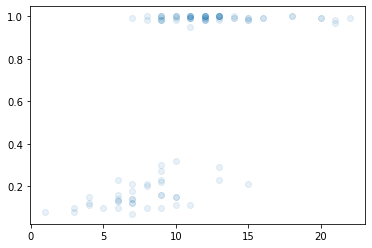

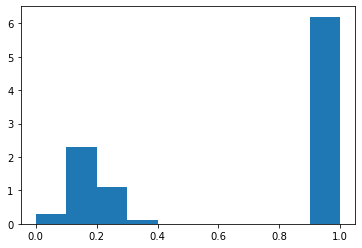

[100]


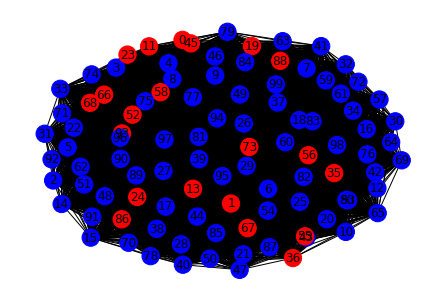

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=1


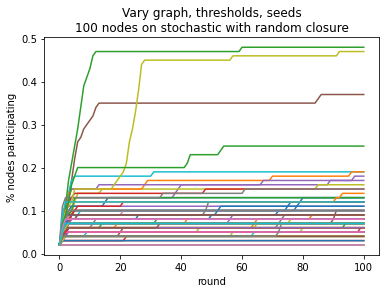

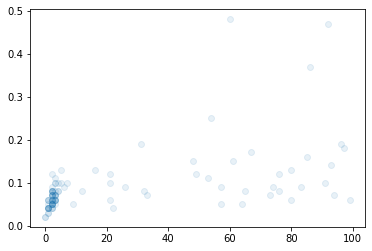

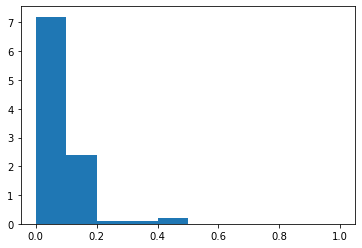

[100]


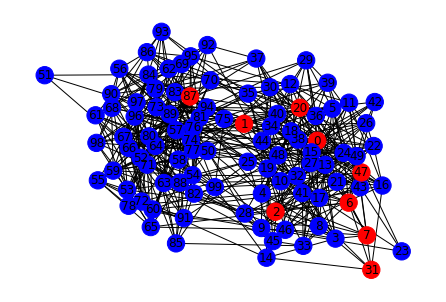

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=5


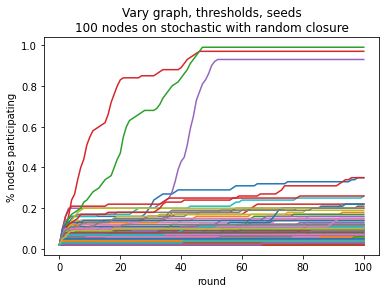

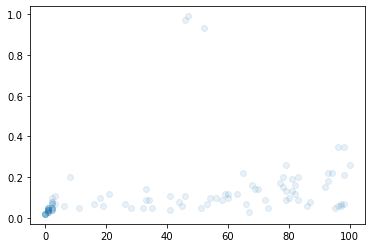

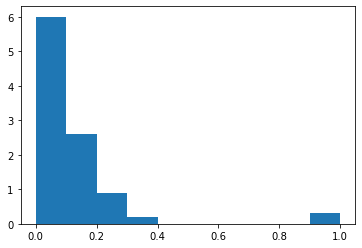

[100]


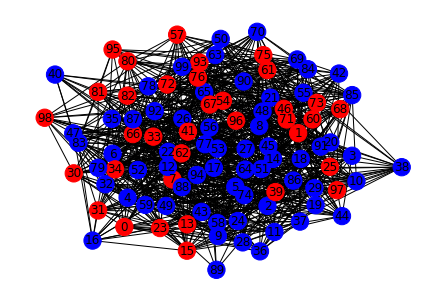

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=10


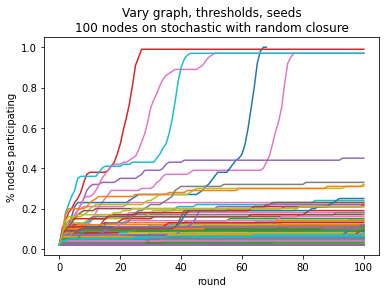

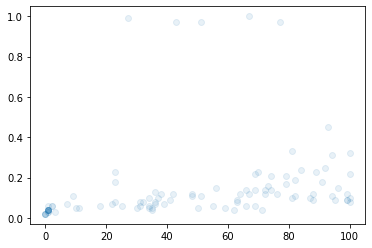

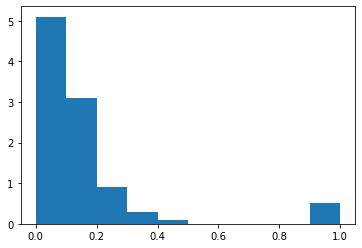

[100]


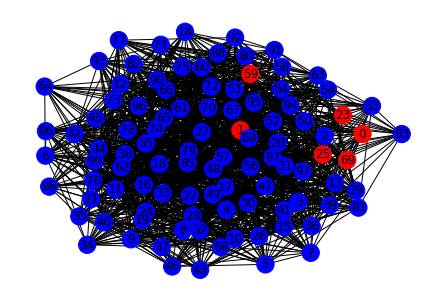

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=25


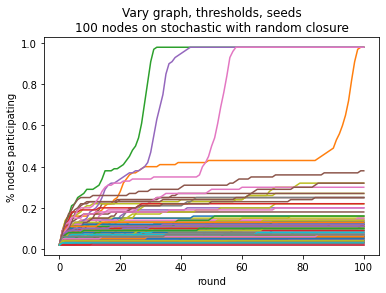

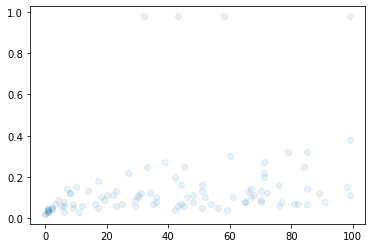

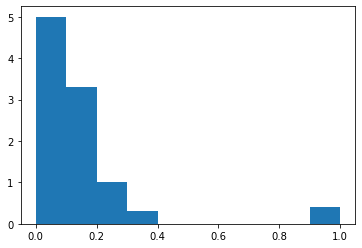

[100]


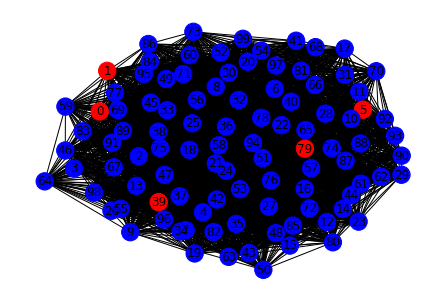

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=50


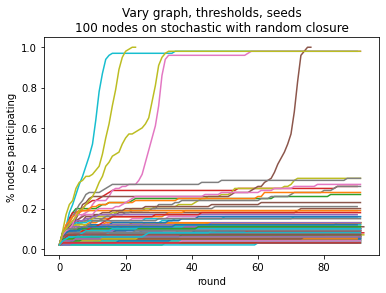

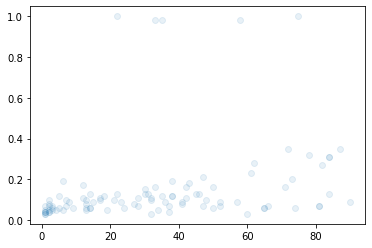

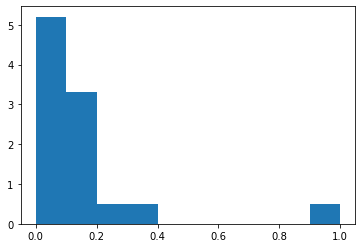

[100]


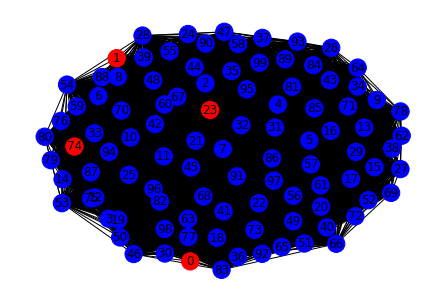

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=75


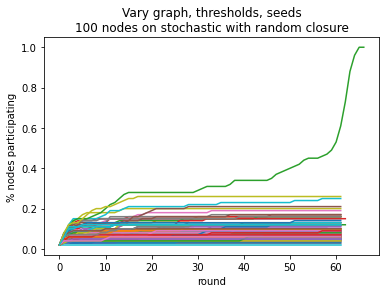

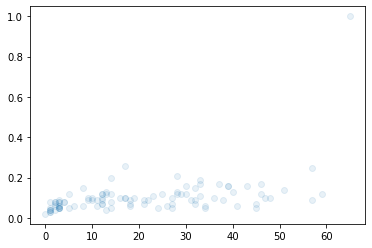

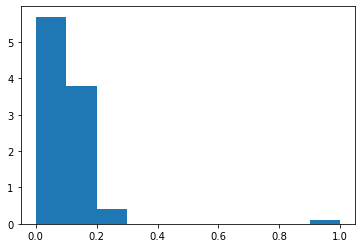

[100]


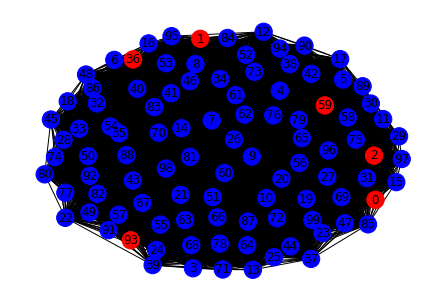

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=100


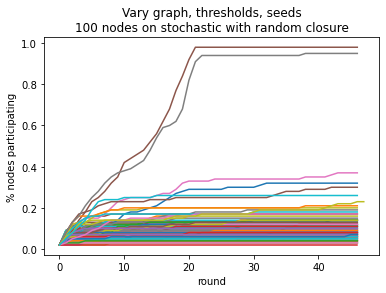

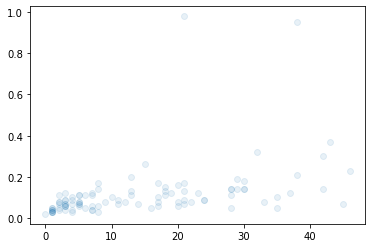

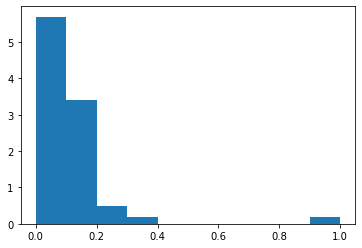

[100]


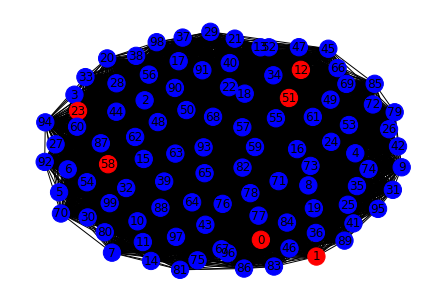

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=250


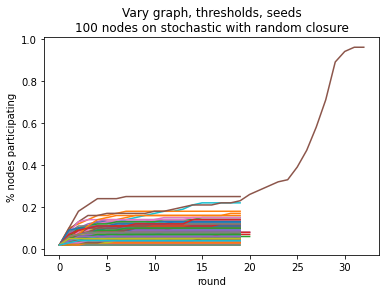

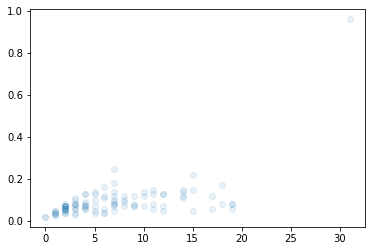

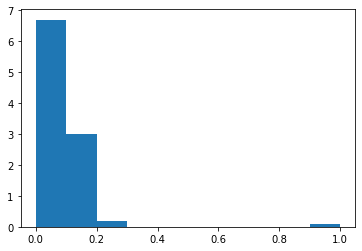

[100]


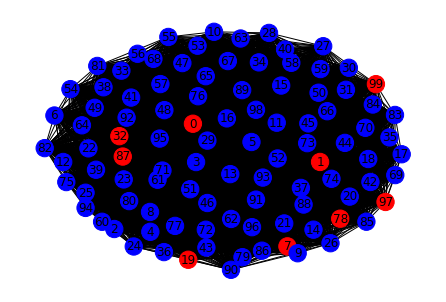

Now running simulation for seed_candidates=[0, 1] threshold=0.5 closure_rate=500


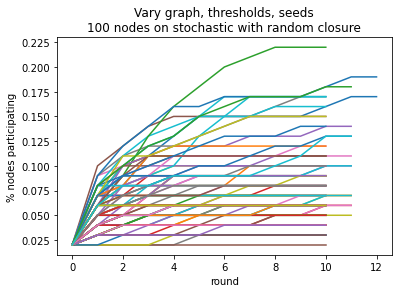

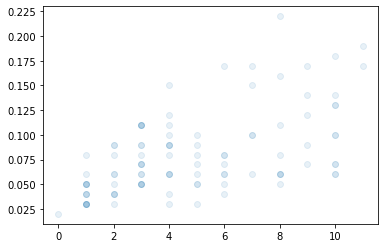

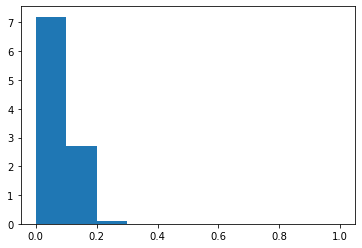

[100]


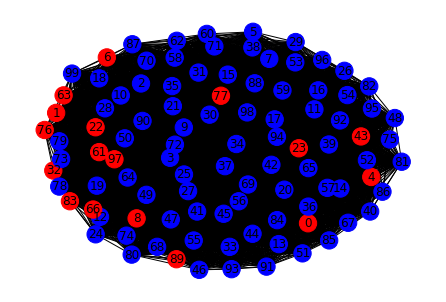

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=1


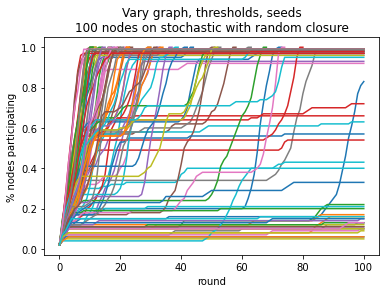

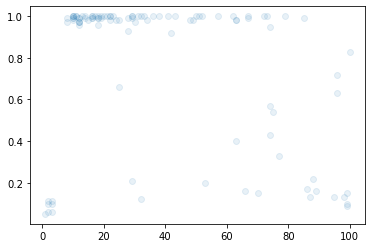

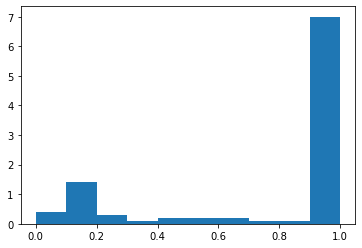

[100]


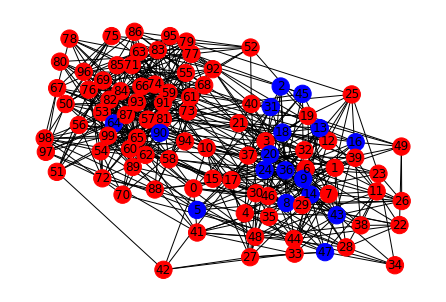

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=5


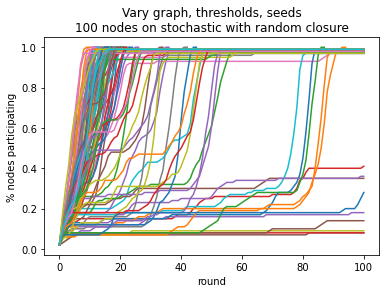

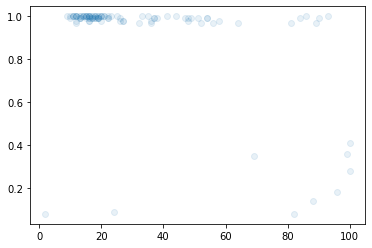

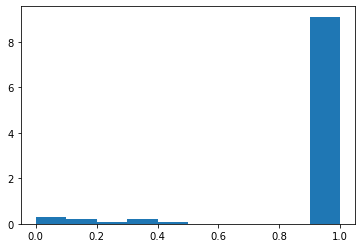

[100]


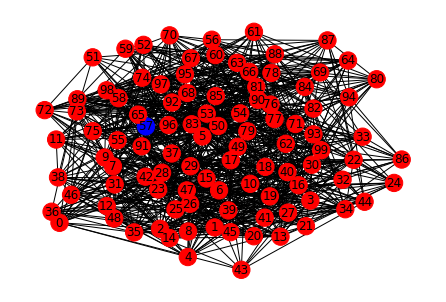

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=10


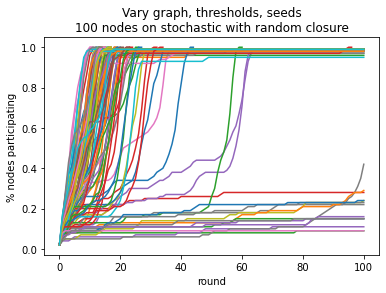

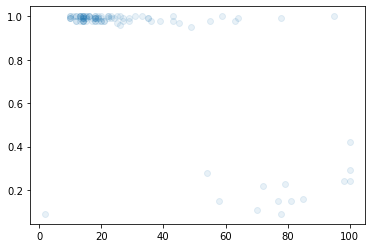

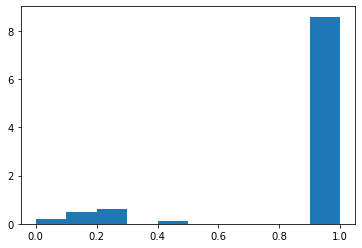

[100]


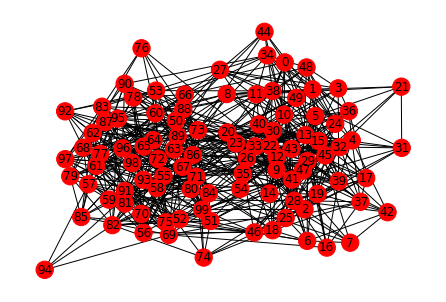

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=25


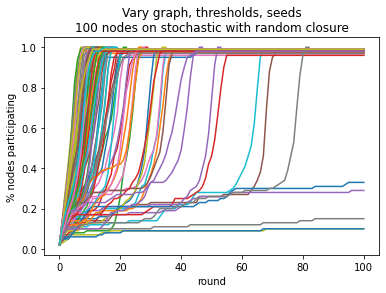

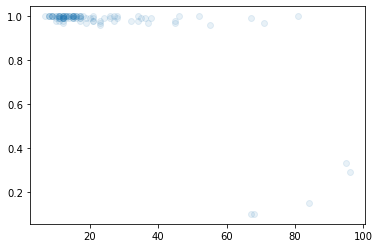

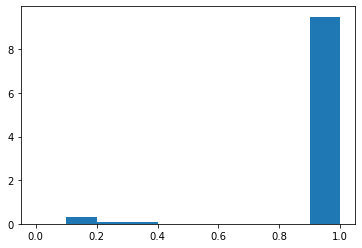

[100]


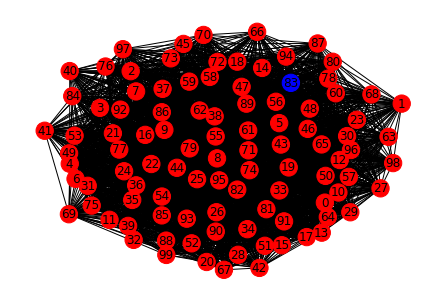

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=50


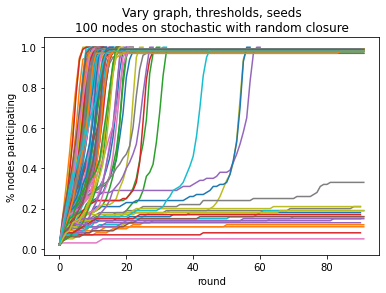

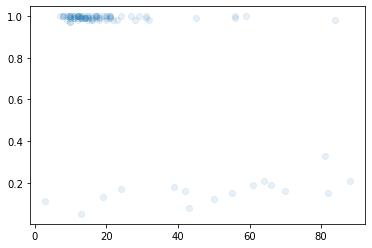

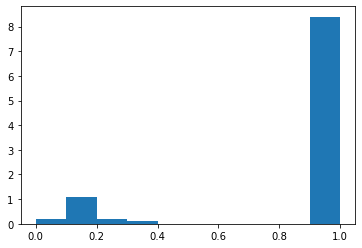

[100]


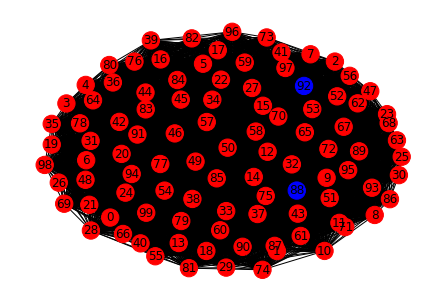

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=75


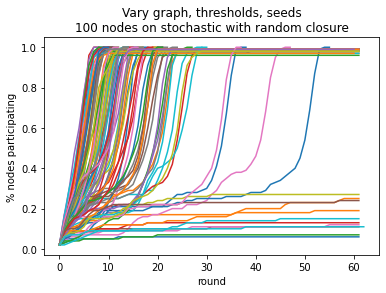

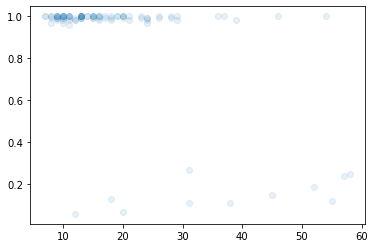

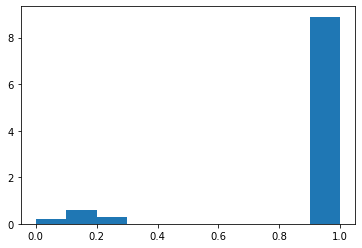

[100]


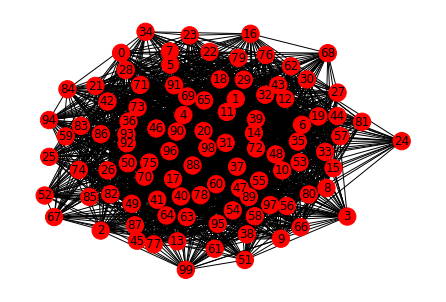

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=100


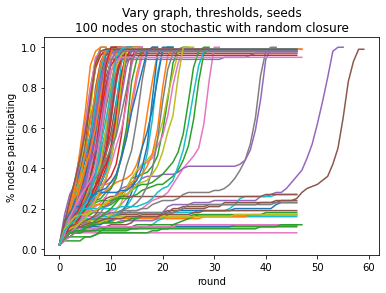

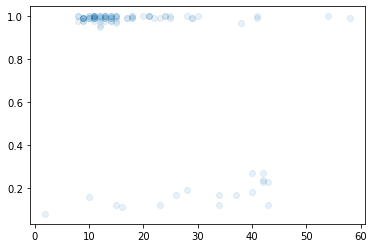

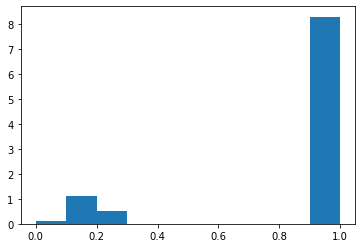

[100]


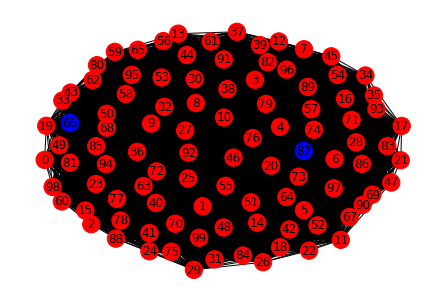

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=250


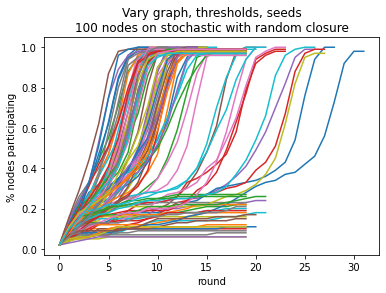

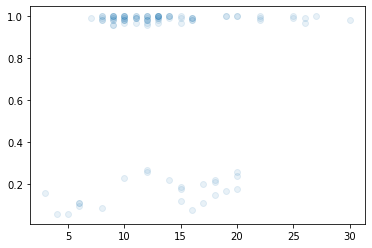

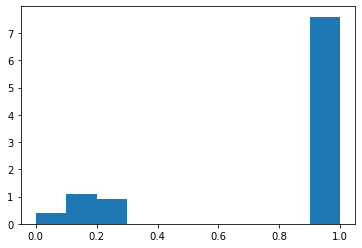

[100]


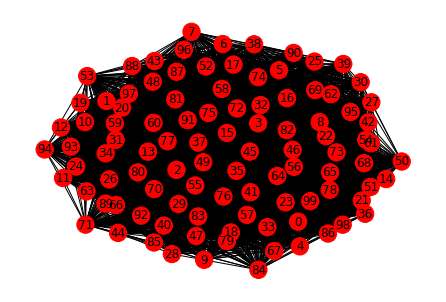

Now running simulation for seed_candidates=[0, 50] threshold=0.4 closure_rate=500


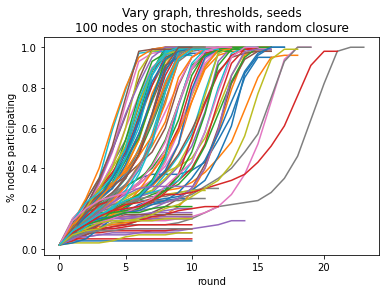

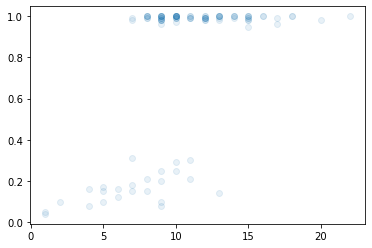

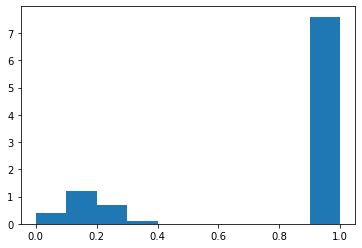

[100]


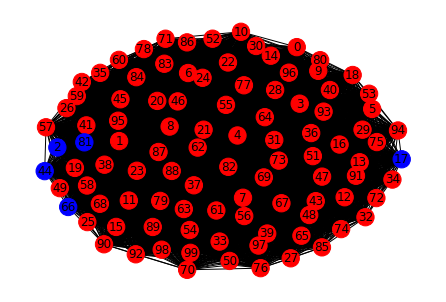

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=1


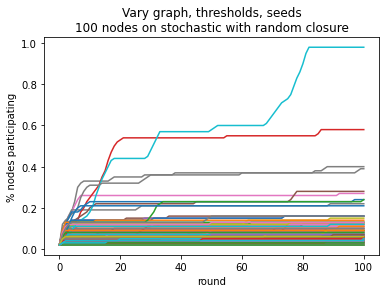

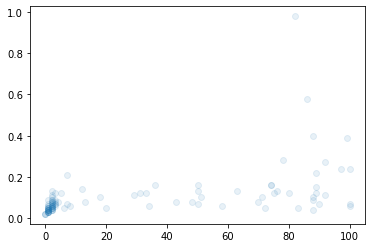

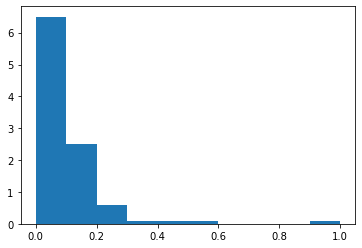

[100]


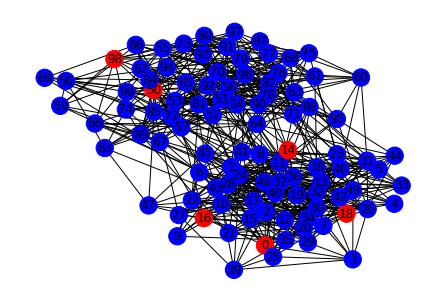

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=5


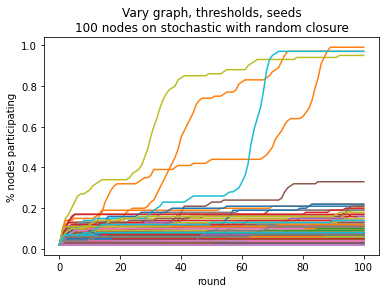

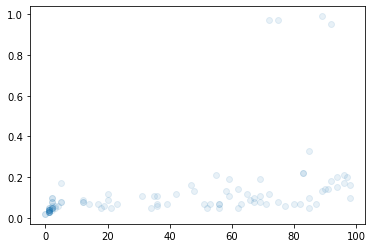

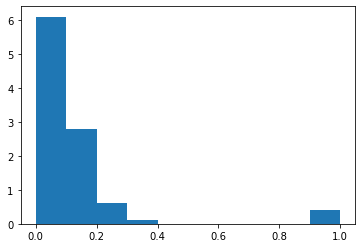

[100]


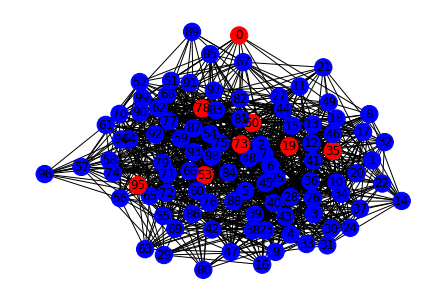

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=10


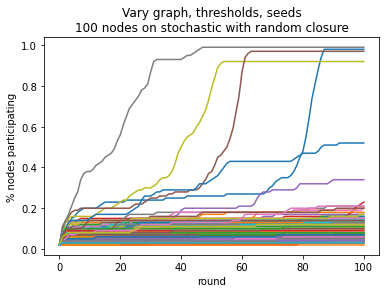

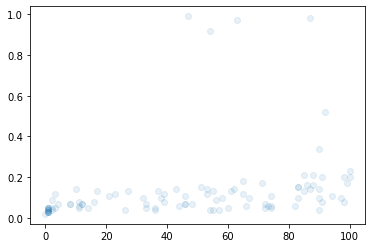

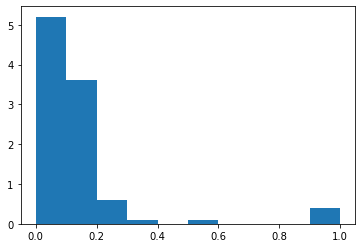

[100]


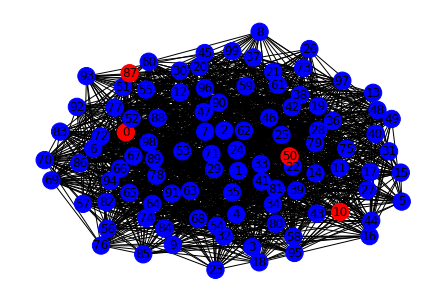

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=25


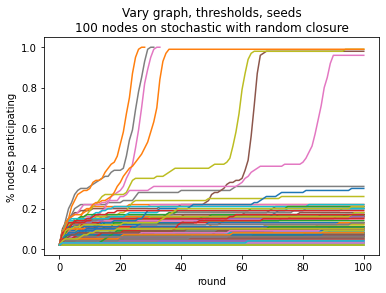

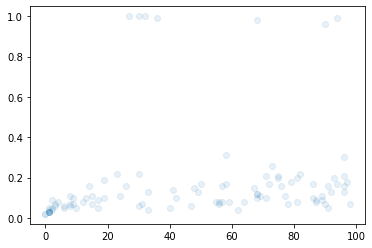

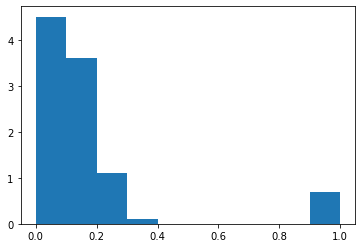

[100]


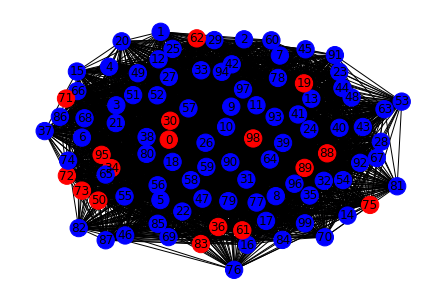

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=50


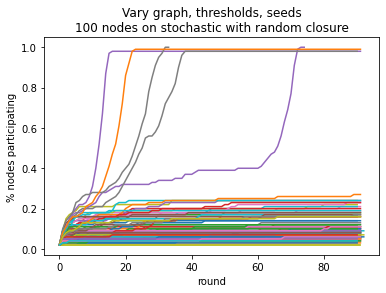

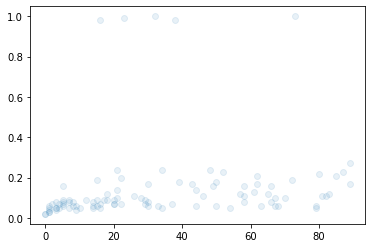

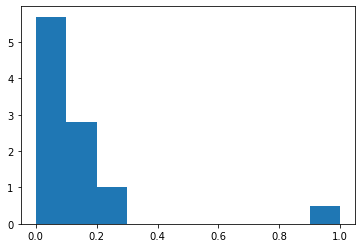

[100]


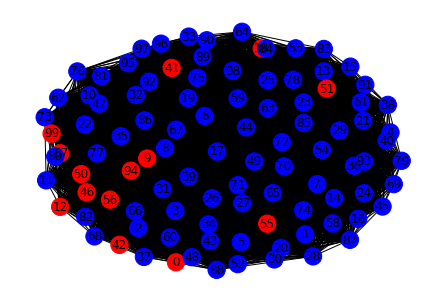

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=75


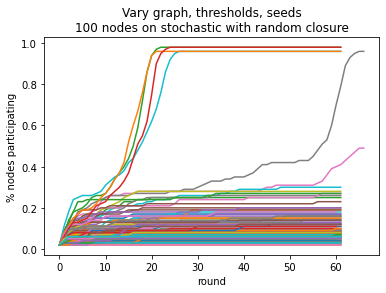

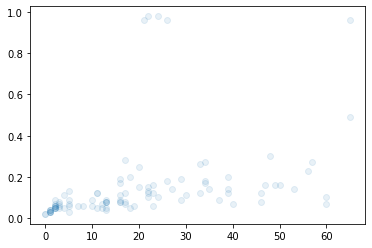

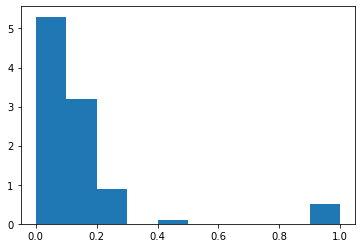

[100]


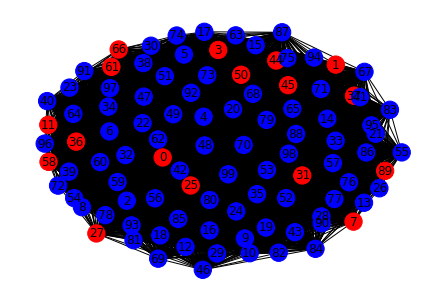

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=100


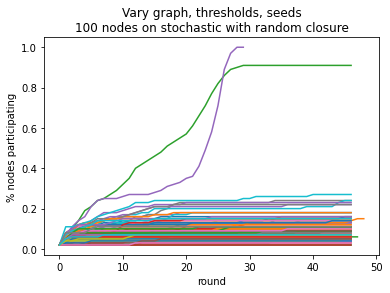

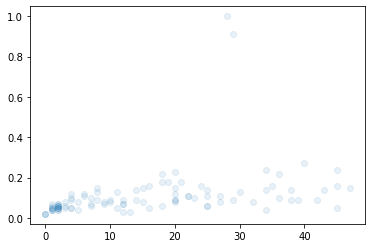

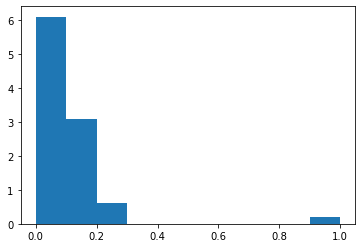

[100]


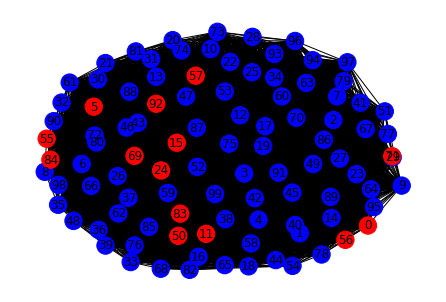

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=250


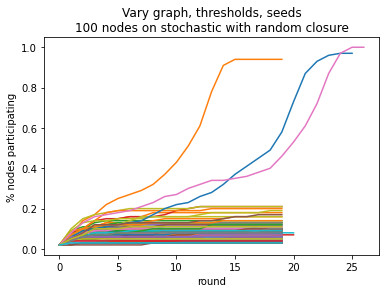

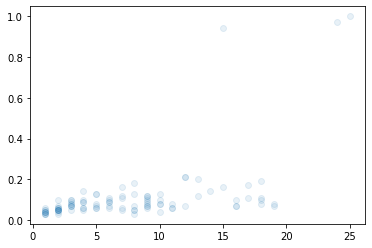

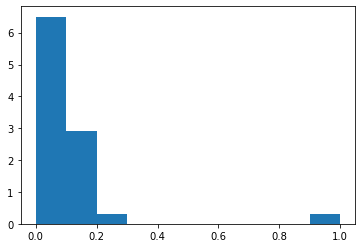

[100]


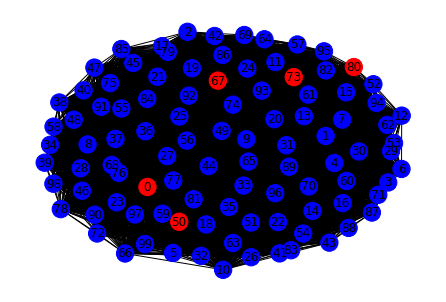

Now running simulation for seed_candidates=[0, 50] threshold=0.5 closure_rate=500


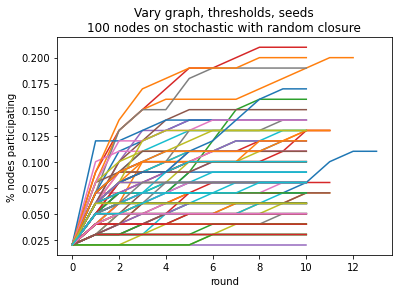

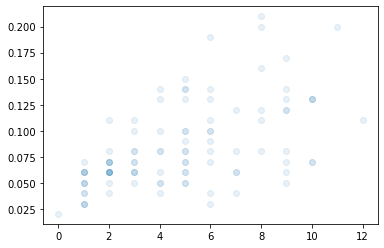

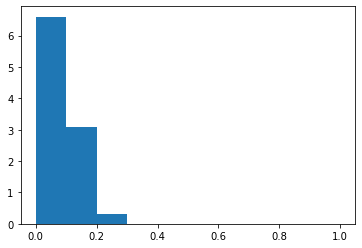

[100]


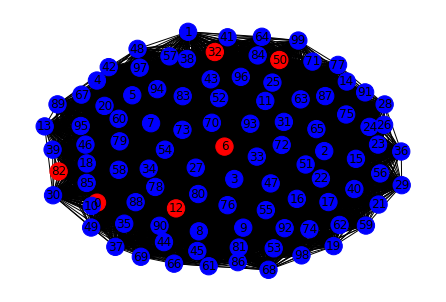

In [8]:
num_experiments = 100
# Graph hyperparameters
graph_type = ['Gnp', 'stochastic'][1]
num_nodes = 100
graph_params = {
    'Gnp':{'p':0.1}, 
    'stochastic':{'within_p':0.19,'between_p':0.01}
}[graph_type]
# Threshold hyperparameters
THRESHOLD_MEAN_LIST = [0.4, 0.5] # threshold_mean = 0.4
threshold_var = 0.25
# Seed selection hyperparameters
SEED_CANDIDATES_DICT = {
    'joined': [0,1], # can define without loss of generality
    'forked': [0,50],
}
num_seeds = 2
# Simulation hyperparameters
use_network = True
sticky_cascade = True
closure_method = [
    'max', 
    'squared_weighted_random', 'weighted_random', 'random', 
    'static'
][3] if use_network else 'population_irrelevant'
CLOSURE_RATE_LIST = [1, 5, 10, 25, 50, 75, 100, 250, 500] # closure_rate = 1
max_rounds = 100

plt.rcParams.update(IPython_default);

for seed_candidate_type in SEED_CANDIDATES_DICT:
    seed_candidates = SEED_CANDIDATES_DICT[seed_candidate_type]
    for threshold_mean in THRESHOLD_MEAN_LIST:
        for closure_rate in CLOSURE_RATE_LIST:
            print(f'Now running simulation for seed_candidates={seed_candidates} threshold={threshold_mean} closure_rate={closure_rate}')

            # Retrieve output from before
            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
                open(f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelmax_thres{threshold_mean}clos{closure_rate}.pkl', 'rb')
            )
            rounds_filled, rounds_frozen, max_size_round, sizes_round = run_potentialsrc_simulations(
                sim_log,
                num_experiments, graph_type, num_nodes, graph_params, 
                threshold_mean, threshold_var, seed_candidates, num_seeds, 
                use_network, sticky_cascade, closure_method, closure_rate, 
                max_rounds, save_path=f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelrandom_thres{threshold_mean}clos{closure_rate}.pkl', 
                use_simlog_graph=False, use_simlog_thresholds=False, use_simlog_seeds=False
            )

            # print(rounds_filled)
            # print(rounds_frozen)
            # print(max_size_round)

            _ = plt.scatter(
                max_size_round,
                [r[-1] for r in sizes_round],
                alpha=0.1,
            )
            plt.show()

            _ = plt.hist([r[-1] for r in sizes_round], range=(0,1), bins=10, density=True)
            plt.show()

            (sim_log, rounds_filled, rounds_frozen, max_size_round, sizes_round) = pickle.load(
                open(f'e2_communitysbm/sbm_2seed_{seed_candidate_type}_modelrandom_thres{threshold_mean}clos{closure_rate}.pkl', 'rb')
            )
            drawn_graph = sim_log[0][3][-1]
            drawn_colors = sim_log[0][4][-1]
            drawn_colors = [('red' if (i in drawn_colors) else 'blue') for i in range(len(drawn_graph))]
            print(get_community_sizes(drawn_graph))
            nx.draw(drawn_graph, with_labels=True, node_color=drawn_colors)
            plt.show()